In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from astropy.io import fits
import numpy as np
from astropy.table import QTable,vstack
import astropy.units as u
import astropy.utils
from astropy.coordinates import SkyCoord
import matplotlib.pyplot as plt
import matplotlib.colors
from scipy.stats import chisquare
from scipy.stats import chi2
from scipy.stats import lognorm
from scipy.stats import f
from astropy.timeseries import LombScargle
import time
from astropy.visualization import hist
from scipy.optimize import curve_fit
from astropy.timeseries import BoxLeastSquares
from astropy.timeseries import TimeSeries
from astropy.time import Time
from tqdm import tqdm
from scipy.stats import gaussian_kde
import pandas as pd


import functions
#import upsilon

### Making cuts to classify sources

In [5]:
#t_zr=QTable.read('t_zr_0307.ecsv')
#t_zg=QTable.read('t_zg_0307.ecsv')
#t_zr=t_zr[np.isnan(t_zr['LNP_SIG'])==False]
#t_zg=t_zg[np.isnan(t_zg['LNP_SIG'])==False]

t_zr=QTable.read('t_zr_0410.ecsv')
t_zg=QTable.read('t_zg_0410.ecsv')

In [6]:
plt.rcParams['hatch.color'] = 'b'

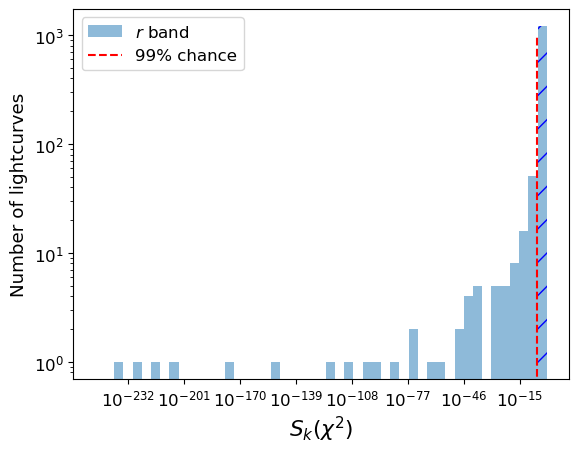

In [7]:
fs=12
sf=np.array(t_zg['sf'])
cutoff=1/(100*len(t_zr))
histo=hist(sf,bins=np.logspace(np.log10(1e-250),np.log10(1),num=50),label='$r$ band',alpha=0.5)

plt.fill_between(x=histo[1][histo[1]>cutoff],y1=np.zeros(len(histo[0][(histo[1]>cutoff)[:-1]])),y2=histo[0][(histo[1]>cutoff)[:-1]], hatch="/", linewidth=0.0, alpha=0.0)

plt.vlines(1/(100*len(t_zg)),0,1000,ls='--',color='r',label='99% chance')
#,histtype='step'
plt.xlabel('$S_k(\chi^2)$',fontsize=fs*1.3)
plt.ylabel('Number of lightcurves',fontsize=fs*1.1)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
plt.gca().set_xscale("log")
plt.gca().set_yscale("log")
#histo

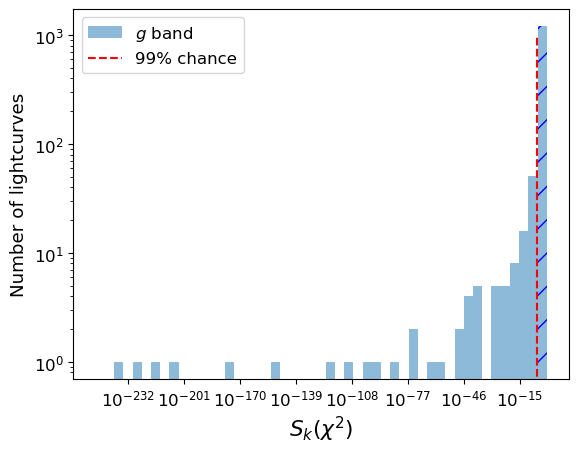

In [8]:
fs=12
sf=np.array(t_zg['sf'])
cutoff=1/(100*len(t_zg))
histo=hist(sf,bins=np.logspace(np.log10(1e-250),np.log10(1),num=50),label='$g$ band',alpha=0.5)

plt.fill_between(x=histo[1][histo[1]>cutoff],y1=np.zeros(len(histo[0][(histo[1]>cutoff)[:-1]])),y2=histo[0][(histo[1]>cutoff)[:-1]], hatch="/", linewidth=0.0, alpha=0.0)

plt.vlines(1/(100*len(t_zg)),0,1000,ls='--',color='r',label='99% chance')
#,histtype='step'
plt.xlabel('$S_k(\chi^2)$',fontsize=fs*1.3)
plt.ylabel('Number of lightcurves',fontsize=fs*1.1)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
plt.gca().set_xscale("log")
plt.gca().set_yscale("log")
#histo

In [9]:
1/(100*len(t_zr))

4.154549231408392e-06

In [10]:
1/(100*len(t_zg))

7.496251874062969e-06

In [11]:
len(t_zr)

2407

In [12]:
len(t_zg)

1334

In [13]:
t_zr=QTable.read('t_zr_0410.ecsv')
t_zg=QTable.read('t_zg_0410.ecsv')
t_zr=t_zr[np.isnan(t_zr['LNP_SIG'])==False]
t_zg=t_zg[np.isnan(t_zg['LNP_SIG'])==False]

var_zr=t_zr[t_zr['sf']<1/(100*len(t_zr))] #99% chance variabe
var_zg=t_zg[t_zg['sf']<1/(100*len(t_zg))] #99% chance variabe

nonvar_zr=t_zr[t_zr['sf']>1/(100*len(t_zr))]
nonvar_zg=t_zg[t_zg['sf']>1/(100*len(t_zg))]

In [14]:
len(var_zr),len(var_zg)

(250, 117)

In [15]:
1/(100*len(var_zr)),1/(100*len(var_zg))

(4e-05, 8.547008547008547e-05)

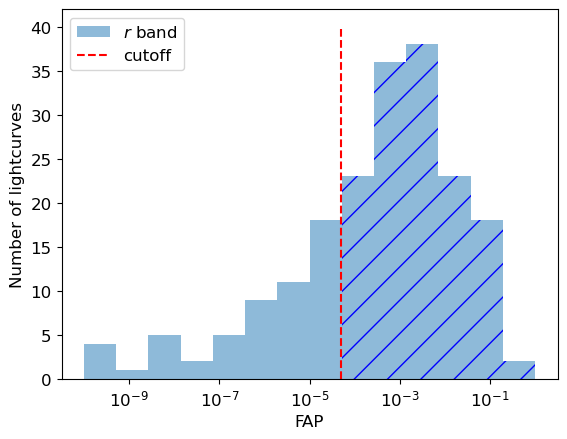

In [16]:
#cutoff=1/(100*len(t_zr))
cutoff=1/(100*len(var_zr))+1e-5
histo=hist(var_zr['LNP_SIG'],bins=np.logspace(np.log10(1e-10),np.log10(1),num=15),label='$r$ band',alpha=0.5)
#histo=hist(var_zr['LNP_SIG'],bins=np.logspace(np.log10(1e-10),np.log10(1),num=29),label='$r$ band',alpha=0.5)
plt.vlines(cutoff,0,40,ls='--',color='r',label='cutoff')

hatch_y=histo[0][(histo[1]>cutoff)[:-1]]
hatch_y=np.append(hatch_y,hatch_y[-1])
plt.fill_between(x=histo[1][histo[1]>cutoff],y1=np.zeros(len(hatch_y)),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

#,histtype='step'
plt.xlabel('FAP',fontsize=fs)
plt.ylabel('Number of lightcurves',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
plt.gca().set_xscale("log")
#plt.gca().set_yscale("log")
#histo

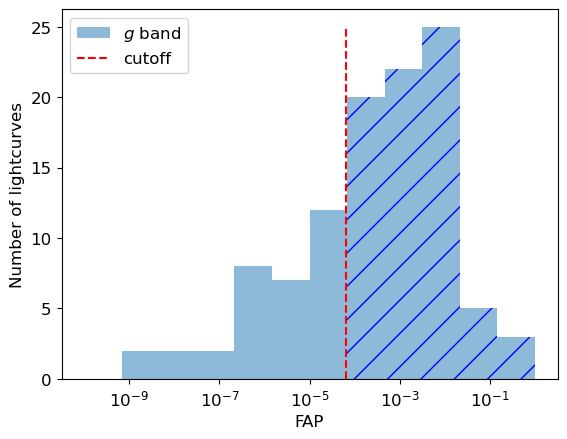

In [17]:
#cutoff=1/(100*len(t_zg))-1e-6  #smooth hatches
cutoff=1/(100*len(var_zg))-2e-5
#histo=hist(var_zg['LNP_SIG'],bins=np.logspace(np.log10(1e-10),np.log10(1),num=30),label='$g$ band',alpha=0.5)
histo=hist(var_zg['LNP_SIG'],bins=np.logspace(np.log10(1e-10),np.log10(1),num=13),label='$g$ band',alpha=0.5)

hatch_y=histo[0][(histo[1]>cutoff)[:-1]]
hatch_y=np.append(hatch_y,hatch_y[-1])
plt.fill_between(x=histo[1][histo[1]>cutoff],y1=np.zeros(len(hatch_y)),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

plt.vlines(cutoff,0,25,ls='--',color='r',label='cutoff')
#,histtype='step'
plt.xlabel('FAP',fontsize=fs)
plt.ylabel('Number of lightcurves',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
plt.gca().set_xscale("log")
#plt.gca().set_yscale("log")
#histo

In [18]:
def cut_LNP_SIG(t,period,LNP_SIG):
    #t=t[(t['period']<period[0])|(t['period']>period[1])]
    #t=t[(t['period']<period[2])|(t['period']>period[3])]
    #if len(period)>4:
        #t=t[(t['period']<period[4])|(t['period']>period[5])]
    t=t[t['LNP_SIG']<LNP_SIG]
    return t

#t_zr=cut_LNP_SIG(var_zr,_,1/(100*len(t_zr)))
#t_zg=cut_LNP_SIG(var_zg,_,1/(100*len(t_zg)))

t_zr=cut_LNP_SIG(var_zr,_,1/(100*len(var_zr)))
t_zg=cut_LNP_SIG(var_zg,_,1/(100*len(var_zg)))

In [19]:
len(t_zr),len(t_zg)

(106, 44)

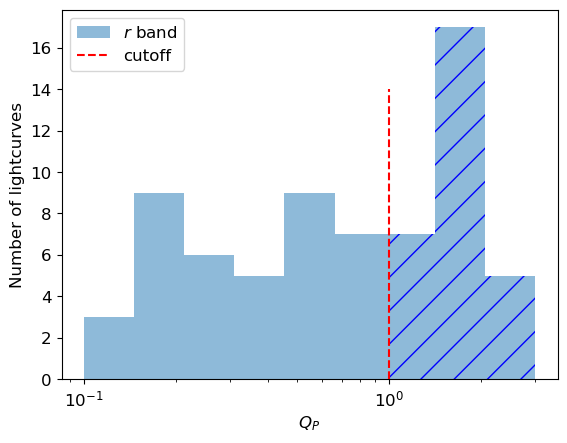

In [20]:
obj=t_zr['power']/t_zr['power_c']
histo=plt.hist(obj, bins=np.logspace(np.log10(0.1),np.log10(3.0), 10),alpha=0.5,label='$r$ band')

cutoff=1-0.05 # smooth hatches
#cutoff=1
hatch_y=histo[0][(histo[1]>cutoff)[:-1]]
hatch_y=np.append(hatch_y,hatch_y[-1])
hatch_x=histo[1][histo[1]>cutoff]
hatch_x[0]=1.0
plt.fill_between(x=hatch_x,y1=np.zeros(len(hatch_y)),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

plt.vlines(1,0,14,ls='--',color='r',label='cutoff')
plt.xlabel('$Q_P$',fontsize=fs)
plt.ylabel('Number of lightcurves',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
#plt.gca().set_yscale("log")
plt.gca().set_xscale("log")

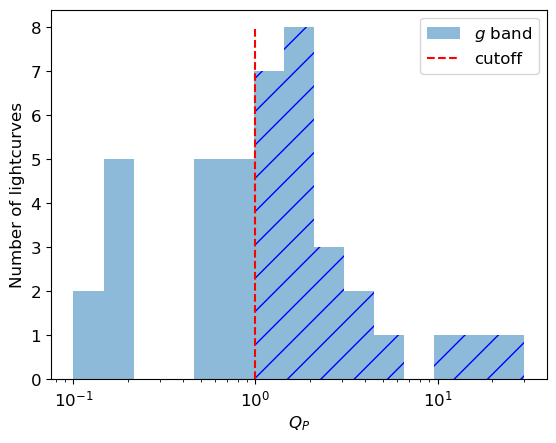

In [21]:
obj=t_zg['power']/t_zg['power_c']
histo=plt.hist(obj, bins=np.logspace(np.log10(0.1),np.log10(30.0), 16),alpha=0.5,label='$g$ band')

cutoff=1-0.03 # smooth hatches
hatch_y=histo[0][(histo[1]>cutoff)[:-1]]
hatch_y=np.append(hatch_y,hatch_y[-1])
hatch_x=histo[1][histo[1]>cutoff]
hatch_x[0]=1.0
plt.fill_between(x=hatch_x,y1=np.zeros(len(hatch_y)),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

plt.vlines(1,0,8,ls='--',color='r',label='cutoff')
plt.xlabel('$Q_P$',fontsize=fs)
plt.ylabel('Number of lightcurves',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
#plt.gca().set_yscale("log")
plt.gca().set_xscale("log")

In [22]:
obj_zr=t_zr[t_zr['power']/t_zr['power_c']>=1]
obj_zg=t_zg[t_zg['power']/t_zg['power_c']>=1]

In [23]:
len(obj_zr),len(obj_zg)

(66, 27)

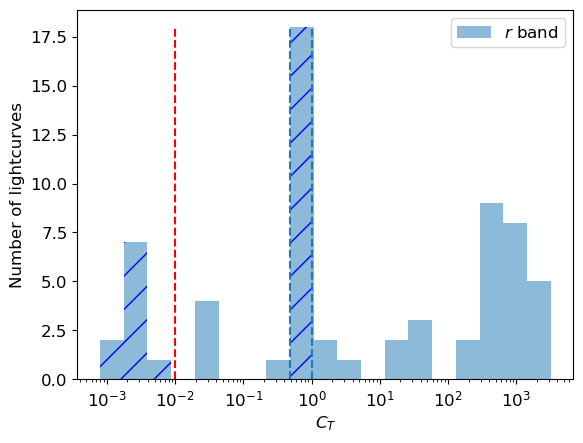

In [24]:
obj=np.abs(obj_zr['period']-obj_zr['period_c'])/obj_zr['period_c']
histo=plt.hist(obj, bins=np.logspace(np.log10(obj[obj!=0].min()),np.log10(obj.max()), 20),alpha=0.5,label='$r$ band')

cutoff=1e-2
hatch_y=histo[0][(histo[1]<cutoff)[:-1]]
hatch_x=histo[1][histo[1]<cutoff]
plt.fill_between(x=hatch_x,y1=np.zeros(len(hatch_y)),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

hatch_y=histo[0][(histo[1]<1)[:-1]][-1]
hatch_x=[0.49,1.0]
plt.fill_between(x=hatch_x,y1=np.zeros(1),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

#plt.gca().set_yscale("log")
plt.gca().set_xscale("log")
plt.vlines((0.49,1.0),0,18,ls='--')
plt.vlines((1e-2),0,18,ls='--',color='r')
plt.xlabel('$C_T$',fontsize=fs)
plt.ylabel('Number of lightcurves',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)
#plt.xlim(0.1,1)

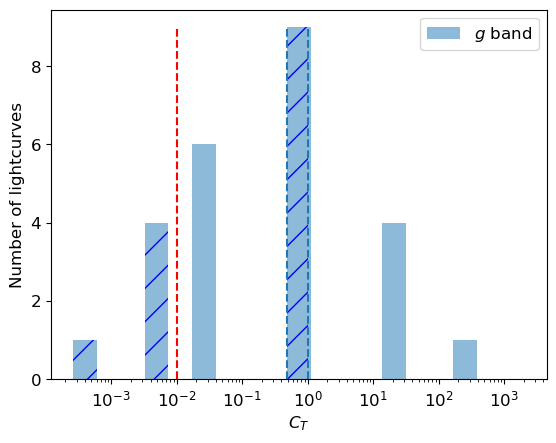

In [25]:
obj=np.abs(obj_zg['period']-obj_zg['period_c'])/obj_zg['period_c']
histo=plt.hist(obj, bins=np.logspace(np.log10(obj[obj!=0].min()),np.log10(obj.max()), 20),alpha=0.5,label='$g$ band')

cutoff=1e-2
hatch_y=histo[0][(histo[1]<cutoff)[:-1]]
hatch_x=histo[1][histo[1]<cutoff]
plt.fill_between(x=hatch_x,y1=np.zeros(len(hatch_y)),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

hatch_y=histo[0][(histo[1]<1.0)[:-1]][-1]
hatch_x=[0.49,1.0]
plt.fill_between(x=hatch_x,y1=np.zeros(1),y2=hatch_y, hatch="/", linewidth=0.0, alpha=0.0,step='post')

#plt.gca().set_yscale("log")
plt.gca().set_xscale("log")
plt.vlines((0.49,1.0),0,9,ls='--')
plt.vlines((1e-2),0,9,ls='--',color='r')
plt.xlabel('$C_T$',fontsize=fs)
plt.ylabel('Number of lightcurves',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)

In [26]:
t_zr=QTable.read('t_zr_0410.ecsv')
t_zg=QTable.read('t_zg_0410.ecsv')
t_zr['lc_var']='N'
t_zg['lc_var']='N'
t_zr['var']='N'
t_zg['var']='N'
t_zr['var_flag']=0
t_zg['var_flag']=0

for row in t_zr:
    if row['sf']<1/(100*len(t_zr)):
        row['lc_var']='V'
        
for row in t_zg:
    if row['sf']<1/(100*len(t_zg)):
        row['lc_var']='V'

var_zr=t_zr[t_zr['sf']<1/(100*len(t_zr))] #99% chance variabe
var_zg=t_zg[t_zg['sf']<1/(100*len(t_zg))] #99% chance variabe

print(len(var_zr),len(var_zg))

nonvar_zr=t_zr[t_zr['sf']>1/(100*len(t_zr))]
nonvar_zg=t_zg[t_zg['sf']>1/(100*len(t_zg))]

def cut_LNP_SIG(t,period,LNP_SIG):
    #t=t[(t['period']<period[0])|(t['period']>period[1])]
    #t=t[(t['period']<period[2])|(t['period']>period[3])]
    #if len(period)>4:
        #t=t[(t['period']<period[4])|(t['period']>period[5])]
    t=t[t['LNP_SIG']<LNP_SIG]
    return t

tt_zr=cut_LNP_SIG(var_zr,_,1/(100*len(var_zr)))
tt_zg=cut_LNP_SIG(var_zg,_,1/(100*len(var_zg)))

print(len(tt_zr),len(tt_zg))


# cut power ratios
obj_zr=tt_zr[tt_zr['power']/tt_zr['power_c']>=1]
obj_zg=tt_zg[tt_zg['power']/tt_zg['power_c']>=1]


print(len(obj_zr),len(obj_zg))

# cut close periods
obj_zr=obj_zr[np.abs(obj_zr['period']-obj_zr['period_c'])/obj_zr['period_c']>1e-2]
obj_zg=obj_zg[np.abs(obj_zg['period']-obj_zg['period_c'])/obj_zg['period_c']>1e-2]

print(len(obj_zr),len(obj_zg))

obj_zr=obj_zr[(np.abs(obj_zr['period']-obj_zr['period_c'])/obj_zr['period_c']<0.49)|(np.abs(obj_zr['period']-obj_zr['period_c'])/obj_zr['period_c']>1.0)|(obj_zr['LNP_SIG']<1e-30)]
obj_zg=obj_zg[(np.abs(obj_zg['period']-obj_zg['period_c'])/obj_zg['period_c']<0.49)|(np.abs(obj_zg['period']-obj_zg['period_c'])/obj_zg['period_c']>1.0)|(obj_zg['LNP_SIG']<1e-30)]

print(len(obj_zr),len(obj_zg))




for row in t_zr:
    if len(obj_zr[obj_zr['OID']==row['OID']])!=0:
        row['lc_var']='P'

for row in t_zg:
    if len(obj_zg[obj_zg['OID']==row['OID']])!=0:
        row['lc_var']='P'

# process degeneracy
for row in t_zr:
    group=t_zr[t_zr['SourceID']==row['SourceID']]
    groupmax=group[group['numobs'].argmax()]
    if groupmax['OID']==row['OID']:
        row['var']=row['lc_var']
    if groupmax['OID']!=row['OID']:
        row['var']=groupmax['lc_var']
        if (groupmax['lc_var']=='N') and (row['lc_var']!='N'):
            row['var_flag']=1

for row in t_zg:
    group=t_zg[t_zg['SourceID']==row['SourceID']]
    groupmax=group[group['numobs'].argmax()]
    if groupmax['OID']==row['OID']:
        row['var']=row['lc_var']
    if groupmax['OID']!=row['OID']:
        row['var']=groupmax['lc_var']
        if (groupmax['lc_var']=='N') and (row['lc_var']!='N'):
            row['var_flag']=1
            
obj_zr=t_zr[(t_zr['var']=='P')]
obj_zg=t_zg[(t_zg['var']=='P')]

250 117
106 44
66 27
55 21
38 12


In [27]:
# t_zr.write('t_zr_20231024.ecsv',overwrite=True)
# t_zg.write('t_zg_20231024.ecsv',overwrite=True)

### End of classification, analysis follows

In [28]:
t_zr=QTable.read('t_zr_20250225.ecsv')
t_zg=QTable.read('t_zg_20250225.ecsv')

obj_zr=t_zr[(t_zr['var']=='P')]
obj_zg=t_zg[(t_zg['var']=='P')]

In [29]:
obj_zr.show_in_notebook()

         interactive tables it is recommended to use dedicated tools like:
         - https://github.com/bloomberg/ipydatagrid
         - https://docs.bokeh.org/en/latest/docs/user_guide/interaction/widgets.html#datatable
         - https://dash.plotly.com/datatable [warnings]


idx,SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,RUWE,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
0,52,zr,1809211300054348,5.0806374,59.3092921,70,54.861793518066406,3.8287349694500223,7.479393901880701e-06,0.1666656732559204,1.9070708062533334e-05,462.22886833491833,2800.0,0.4143551402254435,0.8929084671484715,19.547266006469727,0.1666656732559204,19.179689407348633,20.374217987060547,-0.2487855702638626,1.9824135303497314,0.023752797415915242,0.03586219985223847,0.04073117478282561,1.0,0.8833477322406814,0.38542511478098085,0.7531769233421609,g1,LPV_SRV_AGB_O,0.56,1.0,221.44868054999824,[HL90] 61,1.854526,HII,1,0,0.089935,0.0,18.839401,159.932,0.351,0.184,1,0.974,0,nan,0,nan,P,N,False,True,False
1,52,zr,806203100023276,5.0806496,59.3093092,664,48.39557647705078,9.548270702053268,1.3227187319910005e-189,0.3108588755130768,1.7018337280194596e-78,595.2450708466688,0.997336033066433,0.6229683753591274,0.21949631231274336,19.675853729248047,0.3108588755130768,19.17412567138672,20.918895721435547,-0.7161276936531067,3.285275936126709,0.05060821258505381,0.007833020026423389,0.026125014733712922,0.0,0.014227170500624942,0.0517871312497491,0.20132354399945207,g2,LPV_OSARG_AGB,0.33,0.0,566.9630815875007,[HL90] 61,1.854526,HII,1,0,0.089935,0.0,18.839401,159.932,0.351,0.184,1,0.974,0,nan,0,nan,P,P,False,True,False
2,77,zr,806203100063307,5.0870906,59.2998095,836,344.7351989746094,40.842491010031104,0.0,0.22717958688735962,7.488112388238467e-24,26.55255504914417,0.997336033066433,0.25554257162342087,0.0034232661997002983,18.791976928710938,0.22717958688735962,17.675485610961914,19.1998348236084,-0.8078729510307312,6.599571704864502,0.010941253454579771,0.0022451831278411214,0.04598158685382897,1.0,0.024749755228021697,0.001446042828369909,0.961198797591372,g1,CEPH_Other,0.44,0.0,26.524588612280738,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,0.982,0,nan,1,0.366956,P,P,False,True,True
3,77,zr,1809211300074746,5.0870934,59.2997909,75,339.8369140625,80.43303571096826,0.0,0.26337021589279175,1.3349568059073803e-11,0.5081678123002179,2800.0,0.5958935079344113,0.34858179928581884,18.844051361083984,0.26337021589279175,17.768030166625977,19.322647094726562,-1.2469897270202637,9.363984107971191,0.060816512321346654,0.020122908699598416,0.08327234162645296,1.0,0.06264230945395721,0.03406160489283805,0.6555665316467969,g1,EB_ED,0.38,1.0,26.573868749999964,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,0.982,0,nan,1,0.366956,P,V,False,True,True
4,90,zr,1809211300042387,5.083505,59.3114538,76,335.14105224609375,55.45322806162426,0.0,0.2555650770664215,2.0784866526889912e-39,2800.0,2800.0,0.9309604412577608,0.9992448196539399,18.229490280151367,0.2555650770664215,17.943700790405273,18.82109832763672,-1.287727952003479,7.673773765563965,0.5555584658587479,0.04627441335937462,0.5534192405367697,0.0,0.004179634055204828,0.004211741656930057,0.49803513609818195,g2,LPV_Mira_AGB_C,0.31,0.0,1328.6934374999983,LGGS J002020.03+591841.2,0.205743,Em*,2,1,0.362068,1.4305001097746064,19.434788,102.102,-0.3582,0.2602,0,1.038,0,nan,0,nan,P,V,False,True,True
5,90,zr,806203100056957,5.0836327,59.3114535,846,567.4482421875,120.79296419281002,0.0,0.3739984333515167,3.247011689208663e-280,2053.7302387401464,0.997336033066433,0.9506730073393318,0.47493011002121566,18.124500274658203,0.3739984333515167,17.195171356201172,18.949966430664062,-2.5609970092773438,11.737095832824707,0.18947997991941207,0.020160519579386485,0.15060952910358819,0.0,0.006788985925998747,0.01068657840378251,0.38484022277800156,g2,LPV_Mira_AGB_C,0.26,0.0,2267.8523263500

In [30]:
np.unique(obj_zr['SourceID']).shape,np.unique(obj_zg['SourceID']).shape

((37,), (12,))

In [31]:
_,unique_counts=np.unique(t_zr['SourceID'],return_counts=True)
len(unique_counts[unique_counts==2])/len(unique_counts)

0.5864116094986808

In [32]:
_,unique_counts=np.unique(t_zg['SourceID'],return_counts=True)
len(unique_counts[unique_counts==2])/len(unique_counts)

0.5439814814814815

In [33]:
# ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

In [34]:
def scatter_hist1(x, y, color, marker, alpha, size, label, ax, ax_histx, ax_histy, bins=12):
    # no labels
    ax_histx.tick_params(axis="x", labelbottom=False)    
    ax_histy.tick_params(axis="y", labelleft=False)

    # no ticks
    #ax_histx.yaxis.set_ticks([])
    #ax_histy.xaxis.set_ticks([])

    # the scatter plot:
    #ax.scatter(x, y)
    ax.scatter(x,y,marker=marker,c=color,s=size, alpha=alpha,label=label)

    # x,y hist
    ax_histx.hist(x, histtype='step', density=1, color=color, bins=np.logspace(np.log10(x.min()), np.log10(x.max()), bins), linewidth=5, alpha=0.8)
    #ax_histx.hist(x, histtype='step', density=1, color=color, bins=bins, linewidth=5, alpha=0.8)
    ax_histy.hist(y, histtype='step',density=1, color=color,bins=bins, orientation='horizontal',linewidth=5,alpha=0.8)

    ax_histx.set_yscale('log')

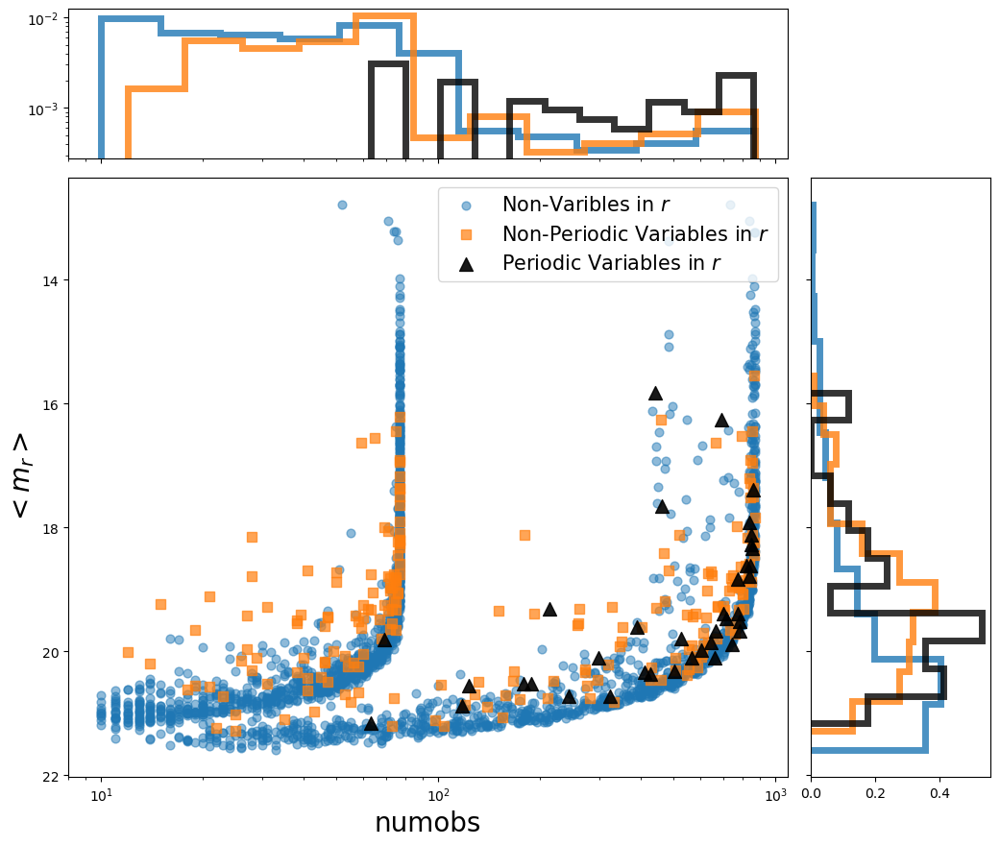

In [35]:
# scatter_hist1(x, y, color, marker, alpha, size, label, ax, ax_histx, ax_histy, bins=25)
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.invert_yaxis()


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.


scatter_hist1(t_zr[t_zr['lc_var']=='N']['numobs'],t_zr[t_zr['lc_var']=='N']['mean'],'#1f77b4','o',0.5,40,'Non-Varibles in $r$'
             ,ax, ax_histx, ax_histy)

scatter_hist1(t_zr[t_zr['lc_var']=='V']['numobs'],t_zr[t_zr['lc_var']=='V']['mean'],'#ff7f0e','s',0.7,50,'Non-Periodic Variables in $r$'
             ,ax, ax_histx, ax_histy)

scatter_hist1(t_zr[t_zr['lc_var']=='P']['numobs'],t_zr[t_zr['lc_var']=='P']['mean'],'black','^',0.9,100,'Periodic Variables in $r$'
             ,ax, ax_histx, ax_histy)


ax.set_xlabel('numobs',fontsize=20)
ax.set_ylabel('$<m_r>$',fontsize=20)
ax.set_xscale('log')
ax.legend(loc=0,fontsize=15)

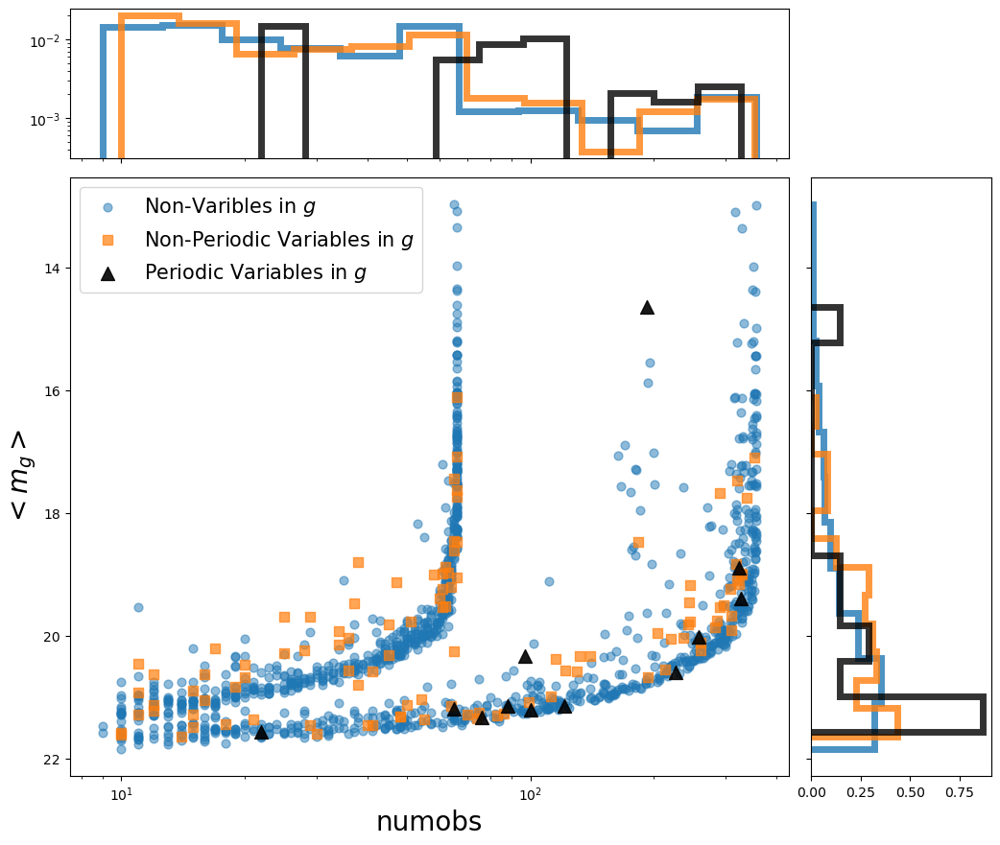

In [36]:
# scatter_hist1(x, y, color, marker, alpha, size, label, ax, ax_histx, ax_histy, bins=25)
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.invert_yaxis()


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.


scatter_hist1(t_zg[t_zg['lc_var']=='N']['numobs'],t_zg[t_zg['lc_var']=='N']['mean'],'#1f77b4','o',0.5,40,'Non-Varibles in $g$'
             ,ax, ax_histx, ax_histy)

scatter_hist1(t_zg[t_zg['lc_var']=='V']['numobs'],t_zg[t_zg['lc_var']=='V']['mean'],'#ff7f0e','s',0.7,50,'Non-Periodic Variables in $g$'
             ,ax, ax_histx, ax_histy)

scatter_hist1(t_zg[t_zg['lc_var']=='P']['numobs'],t_zg[t_zg['lc_var']=='P']['mean'],'black','^',0.9,100,'Periodic Variables in $g$'
             ,ax, ax_histx, ax_histy)


ax.set_xlabel('numobs',fontsize=20)
ax.set_ylabel('$<m_g>$',fontsize=20)
ax.set_xscale('log')
ax.legend(loc=0,fontsize=15)

In [38]:
len(t_zr[t_zr['var_flag']==1]),len(t_zg[t_zg['var_flag']==1])

(1, 4)

In [39]:
(37+150+1329,38+212+2157),(12+85+767,12+105+1217)

((1516, 2407), (864, 1334))

In [40]:
t_zr=QTable.read('t_zr_20250225.ecsv')
t_zg=QTable.read('t_zg_20250225.ecsv')

In [42]:
var_zr=t_zr[(t_zr['var']=='V')|(t_zr['var']=='P')]
var_zg=t_zg[(t_zg['var']=='V')|(t_zg['var']=='P')]
obj_zr=t_zr[t_zr['var']=='P']
obj_zg=t_zg[t_zg['var']=='P']

In [43]:
nonvar_zr=t_zr[t_zr['var']=='N']
nonvar_zg=t_zg[t_zg['var']=='N']

In [44]:
len(np.unique(nonvar_zr['SourceID'])),len(np.unique(nonvar_zg['SourceID'])),len(np.intersect1d(np.unique(nonvar_zr['SourceID']),np.unique(nonvar_zg['SourceID'])))

(1329, 767, 681)

In [45]:
len(t_zr[t_zr['lc_var']=='N']),len(t_zg[t_zg['lc_var']=='N'])

(2157, 1217)

In [46]:
len(np.unique(t_zr['SourceID'])),len(np.unique(t_zg['SourceID'])),len(np.intersect1d(np.unique(t_zr['SourceID']),np.unique(t_zg['SourceID'])))

(1516, 864, 821)

In [47]:
len(np.unique(var_zr['SourceID'])),len(np.unique(var_zg['SourceID'])),len(np.intersect1d(np.unique(var_zr['SourceID']),np.unique(var_zg['SourceID'])))

(187, 97, 42)

In [48]:

len(np.unique(obj_zr['SourceID'])),len(np.unique(obj_zg['SourceID'])),len(np.intersect1d(np.unique(obj_zr['SourceID']),np.unique(obj_zg['SourceID'])))

(37, 12, 2)

In [49]:
unobj_zr=var_zr[np.isin(var_zr['SourceID'],obj_zr['SourceID'])==0]
unobj_zg=var_zg[np.isin(var_zg['SourceID'],obj_zg['SourceID'])==0]

In [50]:
len(t_zr[t_zr['lc_var']=='V']),len(t_zg[t_zg['lc_var']=='V'])

(212, 105)

In [51]:
len(np.unique(unobj_zr['SourceID'])),len(np.unique(unobj_zg['SourceID'])),len(np.intersect1d(np.unique(unobj_zr['SourceID']),np.unique(unobj_zg['SourceID'])))

(150, 85, 34)

In [52]:
len(np.unique(t_zr[np.isin(t_zr['SourceID'],t_zg['SourceID'])==0]['SourceID']))

695

In [53]:
len(np.unique(t_zg[np.isin(t_zg['SourceID'],t_zr['SourceID'])==0]['SourceID']))

43

In [54]:
len(np.unique(nonvar_zr[np.isin(nonvar_zr['SourceID'],t_zg['SourceID'])==0]['SourceID']))


611

In [55]:
len(np.unique(nonvar_zg[np.isin(nonvar_zg['SourceID'],t_zr['SourceID'])==0]['SourceID']))

25

In [56]:
len(np.unique(obj_zr[np.isin(obj_zr['SourceID'],t_zg['SourceID'])==0]['SourceID']))

18

In [57]:
len(np.unique(obj_zg[np.isin(obj_zg['SourceID'],t_zr['SourceID'])==0]['SourceID']))

0

In [58]:
len(np.unique(unobj_zr[np.isin(unobj_zr['SourceID'],t_zg['SourceID'])==0]['SourceID']))

66

In [59]:
len(np.unique(unobj_zg[np.isin(unobj_zg['SourceID'],t_zr['SourceID'])==0]['SourceID']))

18

In [60]:
t_color=QTable.read('t_color_0912.ecsv')

In [61]:

t_color['mean_color'][~np.isnan(t_color['mean_color'])].mean()

1.0785452662794939

In [62]:
def sourcefy(t):
    mask=np.zeros(len(t))+1
    for i,row in enumerate(t):
        copy=t[t['SourceID']==row['SourceID']]
        if len(copy)>1:
            if row['OID']!=copy['OID'][copy['numobs'].argmax()]:
                mask[i]=0
    t=t[mask==1]
    return t

In [63]:
t=t_zr[t_zr['ic10_flag']==1]
len(sourcefy(t))

716

In [64]:
t=t_zg[t_zg['ic10_flag']==1]
len(sourcefy(t))

337

In [65]:
t=sourcefy(nonvar_zr)

In [66]:
len(t),len(t[t['shape']=='g1']),len(t[t['shape']=='gu']),len(t[t['shape']=='g2'])

(1329, 974, 303, 52)

In [67]:
t=sourcefy(nonvar_zg)
len(t),len(t[t['shape']=='g1']),len(t[t['shape']=='gu']),len(t[t['shape']=='g2'])

(767, 545, 176, 46)

In [68]:
t=sourcefy(obj_zr)
len(t),len(t[t['shape']=='g1']),len(t[t['shape']=='gu']),len(t[t['shape']=='g2'])

(37, 17, 4, 16)

In [69]:
t=sourcefy(obj_zg)
len(t),len(t[t['shape']=='g1']),len(t[t['shape']=='gu']),len(t[t['shape']=='g2'])

(12, 11, 0, 1)

In [70]:
t=sourcefy(unobj_zr)
len(t),len(t[t['shape']=='g1']),len(t[t['shape']=='gu']),len(t[t['shape']=='g2'])

(150, 101, 25, 24)

In [71]:
t=sourcefy(unobj_zg)
len(t),len(t[t['shape']=='g1']),len(t[t['shape']=='gu']),len(t[t['shape']=='g2'])

(85, 47, 24, 14)

In [72]:
t_color=QTable.read('t_color_0912.ecsv')

In [73]:
def scatter_hist(x, y, xerr, yerr, color, alpha, markersize, label, ax, ax_histx, ax_histy, bins=10,eb=True):
    # no labels
    ax_histx.tick_params(axis="x", labelbottom=False)
    ax_histy.tick_params(axis="y", labelleft=False)

    # the scatter plot:
    #ax.scatter(x, y)
    if eb:
        ax.errorbar(x,y,xerr=xerr,yerr=yerr,fmt='o',color=color,ecolor='lightgray', elinewidth=3, capsize=0,markersize=markersize, alpha=alpha,label=label)
    else:
        ax.scatter(x,y,marker='o',c=color,s=markersize*5, alpha=alpha*0.8,label=label)

    # x,y hist
    ax_histx.hist(x, histtype='step',density=1, color=color,bins=bins,linewidth=5,alpha=alpha)
    ax_histy.hist(y, histtype='step',density=1, color=color,bins=bins, orientation='horizontal',linewidth=5,alpha=alpha)

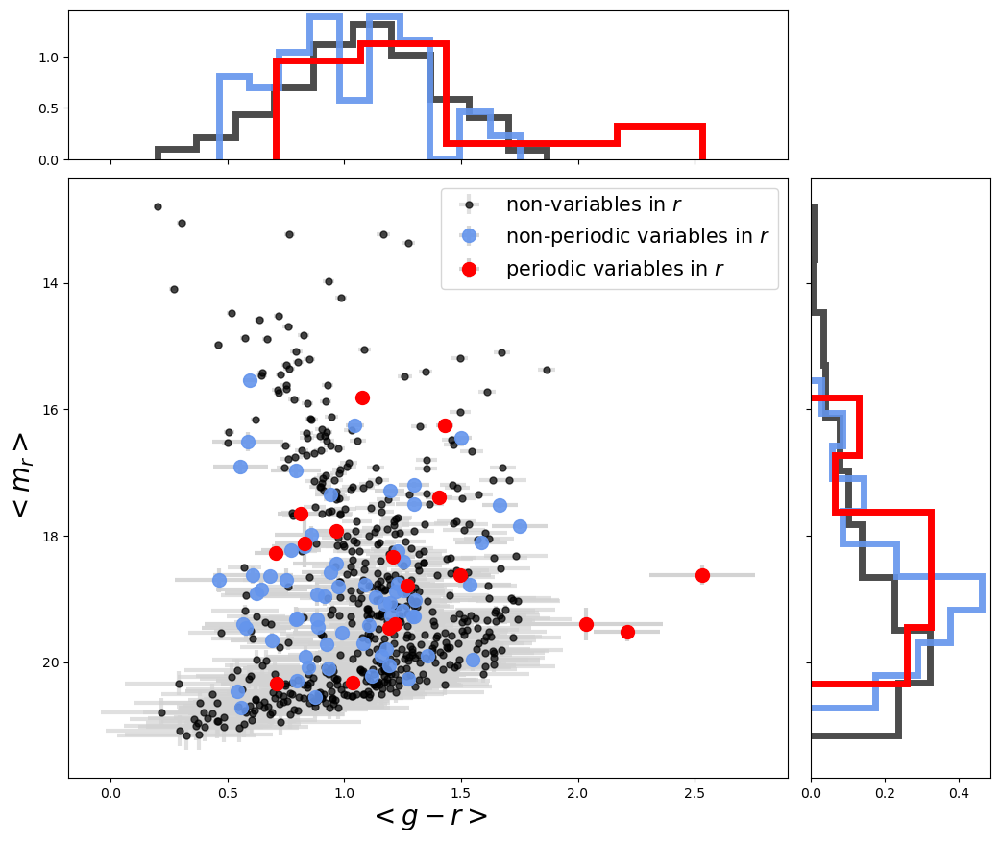

In [74]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.invert_yaxis()


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# nonvar_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(nonvar_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_r'],t_plot['std_color'],t_plot['std_mag_r'],'black',0.7,5,'non-variables in $r$'
             ,ax, ax_histx, ax_histy)

# unobj_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(unobj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_r'],t_plot['std_color'],t_plot['std_mag_r'],'cornflowerblue',0.9,10,'non-periodic variables in $r$'
             ,ax, ax_histx, ax_histy)

# obj_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(obj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_r'],t_plot['std_color'],t_plot['std_mag_r'],'red',1,10,'periodic variables in $r$'
             ,ax, ax_histx, ax_histy, bins=5)

#ax_histx.set_yscale('log')
#ax_histy.set_xscale('log')
ax.set_xlabel('$<g - r>$',fontsize=20)
ax.set_ylabel('$<m_r>$',fontsize=20)
ax.legend(loc=0,fontsize=15)

In [19]:
# get the top 3% of t_zg['mean']
g_limit=20.8 # https://iopscience.iop.org/article/10.1088/1538-3873/aaecbe

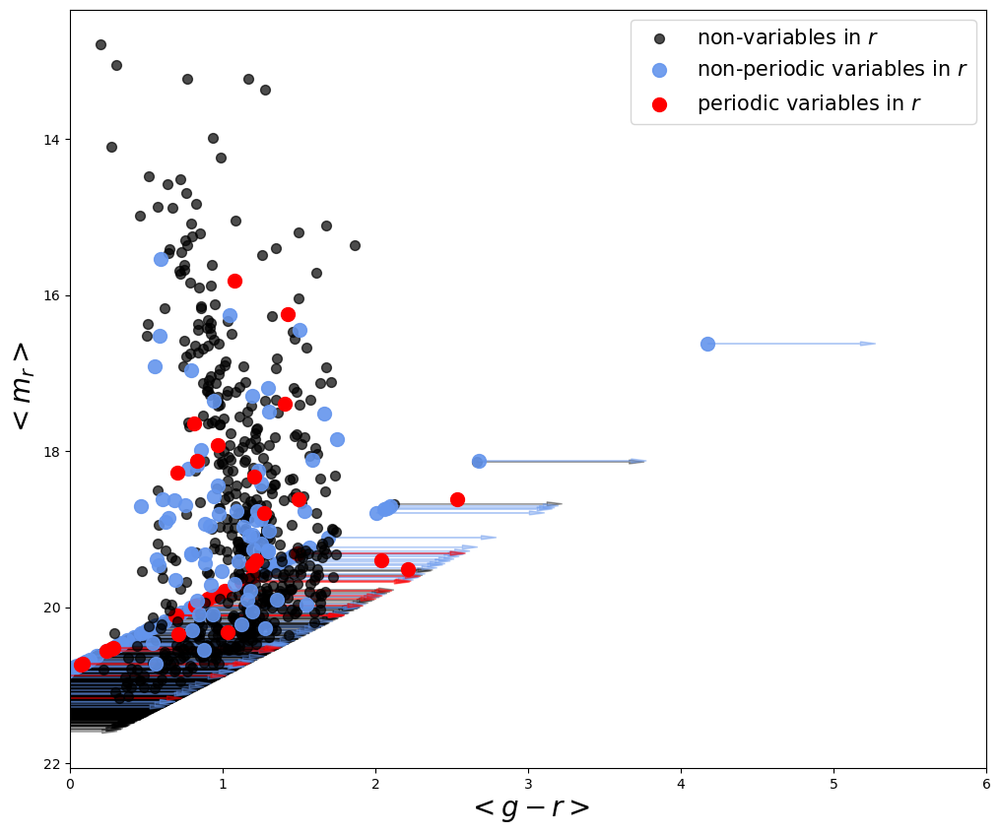

In [39]:
r_det=t_zr[np.isin(t_zr['SourceID'],t_zg['SourceID'])==0]
r_det=sourcefy(r_det)

# for sources in r_det, plot g_limit-r_det['mean'] vs r_det['mean'] for each type of variability

fig = plt.figure(figsize=(12,10))
alpha_scale=2
t_plot=r_det[r_det['var']=='N']
plt.scatter(g_limit-r_det[r_det['var']=='N']['mean'],r_det[r_det['var']=='N']['mean'],color='black',alpha=0.7,s=50)
for row in t_plot:
    plt.arrow(g_limit-row['mean'],row['mean'],1,0,head_width=0.05, head_length=0.1, fc='k', ec='k',alpha=0.7/alpha_scale)

t_plot=r_det[r_det['var']=='V']
plt.scatter(g_limit-r_det[r_det['var']=='V']['mean'],r_det[r_det['var']=='V']['mean'],color='cornflowerblue',alpha=0.9,s=100)
for row in t_plot:
    plt.arrow(g_limit-row['mean'],row['mean'],1,0,head_width=0.05, head_length=0.1, fc='cornflowerblue', ec='cornflowerblue',alpha=0.9/alpha_scale)

t_plot=r_det[r_det['var']=='P']
plt.scatter(g_limit-r_det[r_det['var']=='P']['mean'],r_det[r_det['var']=='P']['mean'],color='red',alpha=1,s=100)
for row in t_plot:
    plt.arrow(g_limit-row['mean'],row['mean'],1,0,head_width=0.05, head_length=0.1, fc='red', ec='red',alpha=1/alpha_scale)


# nonvar_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(nonvar_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='black',alpha=0.7,s=50,label='non-variables in $r$')

# unobj_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(unobj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='cornflowerblue',alpha=0.9,s=100,label='non-periodic variables in $r$')

# obj_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(obj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='red',alpha=1,s=100,label='periodic variables in $r$')


plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$<m_r>$',fontsize=20)
plt.legend(loc=0,fontsize=15)
plt.xlim(0,6)
#invert y axis
plt.gca().invert_yaxis()



In [40]:
super_red_id=np.append(r_det[g_limit-r_det['mean']>2]['SourceID'],t_color[t_color['mean_color']>2]['SourceID'])
super_red=t_zr[np.isin(t_zr['SourceID'],super_red_id)]
super_red=sourcefy(super_red)
print('total, N, V, P, Gaia_count>=1, Plxflag==1')
len(super_red),len(super_red[super_red['var']=='N']),len(super_red[super_red['var']=='V']),len(super_red[super_red['var']=='P']),len(super_red[super_red['Gaia_count']>=1]),len(super_red[super_red['Plxflag']==1])

total, N, V, P, Gaia_count>=1, Plxflag==1


(11, 2, 6, 3, 8, 5)

In [41]:
super_red_rdet=t_zr[np.isin(t_zr['SourceID'],r_det[g_limit-r_det['mean']>2]['SourceID'])]
super_red_rdet=sourcefy(super_red_rdet)
print('total, N, V, P, Gaia_count>=1, Plxflag==1')
len(super_red_rdet),len(super_red_rdet[super_red_rdet['var']=='N']),len(super_red_rdet[super_red_rdet['var']=='V']),len(super_red_rdet[super_red_rdet['var']=='P']),len(super_red_rdet[super_red_rdet['Gaia_count']>=1]),len(super_red_rdet[super_red_rdet['Plxflag']==1])

total, N, V, P, Gaia_count>=1, Plxflag==1


(8, 2, 6, 0, 5, 5)

In [42]:
super_red_rdet_plx=super_red_rdet[super_red_rdet['Plxflag']==1]

In [43]:
d=np.array(1/(super_red_rdet_plx['Plx']*0.001)) # in pc
absolute_magnitude=np.array(super_red_rdet_plx['mean'])-5*np.log10(d)+5

for i in range(len(absolute_magnitude)):
    print(super_red_rdet_plx['SourceID'][i],super_red_rdet_plx['mean'][i],d[i],absolute_magnitude[i])

169 18.138351440429688 1637.4652038644178 7.067491040409017
490 18.124507904052734 1286.3390789812195 7.577730585528974
2307 18.70087242126465 500.32521138740185 10.204610483595946
1695 18.67652130126953 1681.8028927009755 7.547645825614126
1891 16.62375259399414 2970.8853238265006 4.259323152193165


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
2208,zr,806203100065924,5.0780839,59.3143299,633,245.41952514648438,27.81983233666108,0.0,0.21634037792682648,1.380010930972829e-07,0.4986224099965294,0.9973306993528436,0.13565002687535155,0.31148646401480484,18.741130828857422,0.21634037792682648,18.042415618896484,19.212980270385742,-0.7121931314468384,5.427671432495117,0.010771505458542885,0.0001546808723707343,0.04309279965813069,0.0,0.0001259082557343305,7.883005539111032e-06,0.9562053831096757,g2,CEPH_Other,0.4,1.0,2.3336910205564214,--,nan,--,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,nan,0,nan,V,V,False,True,True


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


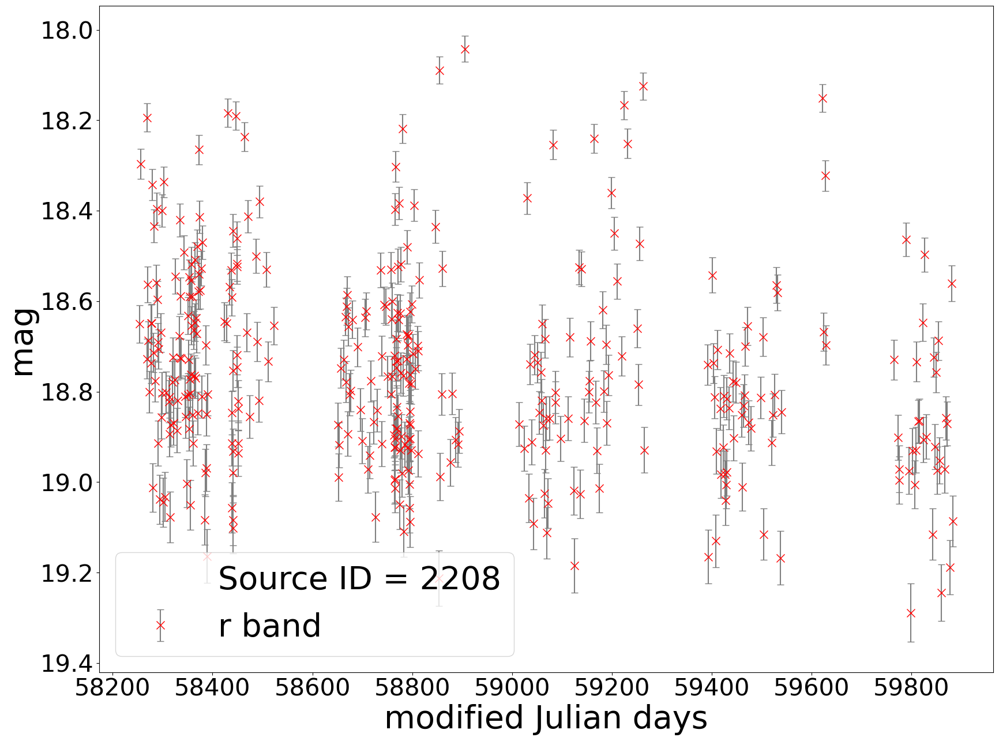

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
2213,zr,1809211300076988,5.0775472,59.3150577,28,116.13783264160156,9.113675723309395,3.2300164530017266e-14,0.13227054476737976,0.008559766609200478,0.1032704940004897,2800.0,0.5753365315946781,0.09327517098597062,18.79161262512207,0.13227054476737976,18.571880340576172,19.052783966064453,-0.2755225598812103,3.001413345336914,0.88551130489715,1.4724198821797954,0.8822880164226091,1.0,0.9730198626298003,0.9757372291608835,0.4981427724604722,gu,DSCT,0.63,1.0,0.09360318446547063,[TG2009] 32,1.137111,Cl*,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,nan,0,nan,V,V,False,True,True


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


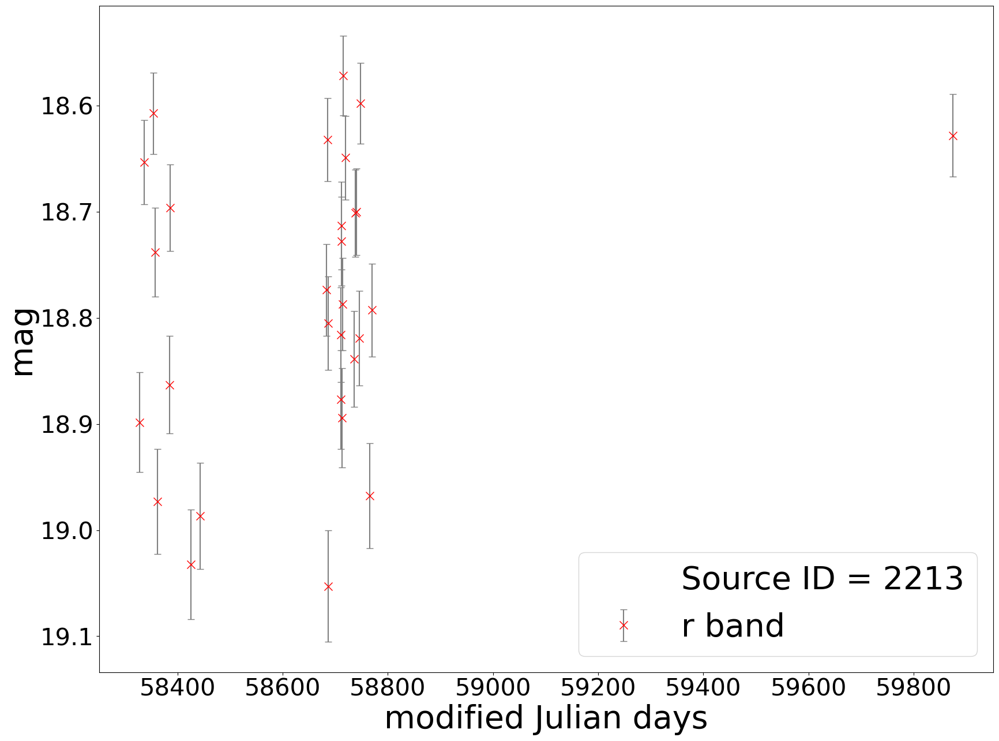

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
2214,zr,1809211300077099,5.0787745,59.3148923,50,270.8092041015625,29.62204061908296,3.092884167623384e-121,0.20303958654403687,0.0010205985562411612,382.40850131579566,2800.0,0.43501564771564366,0.9489906505592601,18.72511100769043,0.20303958654403687,18.023723602294922,19.34270477294922,-0.6901479959487915,5.535651683807373,0.04040983814797587,0.060512716276683455,0.02090826522771624,1.0,0.8748270789986654,1.0,0.20212616702218045,gu,DSCT,0.55,1.0,0.05108777026684107,[TG2009] 32,1.207904,Cl*,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,nan,0,nan,V,V,False,True,True


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


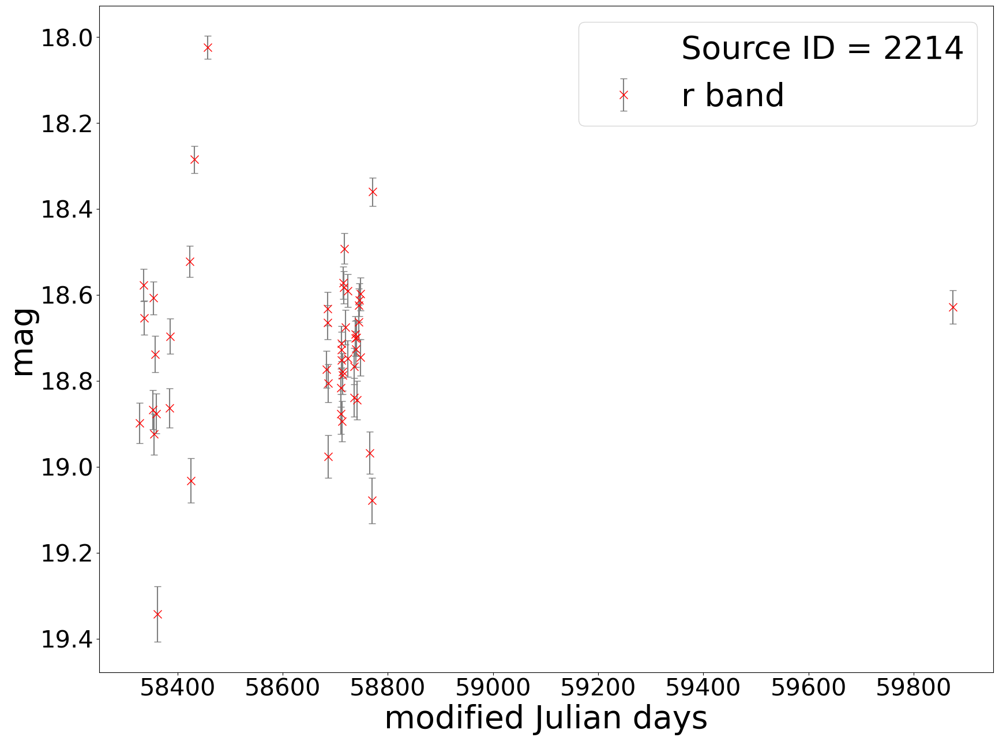

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
169,zr,1809211300070127,5.0788923,59.3172616,55,120.36493682861328,1.6687519209572714,0.8018308933896683,0.03537145256996155,0.0011431526267764018,0.1454593694151882,2800.0,0.4043412307958567,0.03231231932867606,18.085861206054688,0.03537145256996155,17.99405288696289,18.178661346435547,-0.026807498186826706,1.2808458805084229,1.4775402866798075,2.2020057644125655,2.010026490082987,1.0,0.8698193125620257,0.5565174646687057,0.6525303139850538,g1,NonVar,0.56,1.0,0.032901737572598434,--,nan,--,1,0,0.06639,0.0,18.082451,908.643,0.6107,0.1163,1,0,nan,0,nan,N,N,False,True,False
169,zr,806203100063228,5.0788615,59.3172927,617,104.77118682861328,1.23283081306998,0.9999999908680159,0.0346168577671051,0.19593473045635648,0.17726722865124941,0.997336033066433,0.0564929430382798,0.0008024113955176672,18.138351440429688,0.0346168577671051,18.05654525756836,18.264503479003906,-0.02245800569653511,1.109266996383667,0.3607603055924019,0.42435443205858453,0.8398204945369147,1.0,0.6230268932691794,0.1403474791341559,0.8563035950204886,g1,EB_ED,0.41,1.0,0.05442802040823681,--,nan,--,1,0,0.06639,0.0,18.082451,908.643,0.6107,0.1163,1,0,nan,0,nan,N,N,False,True,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


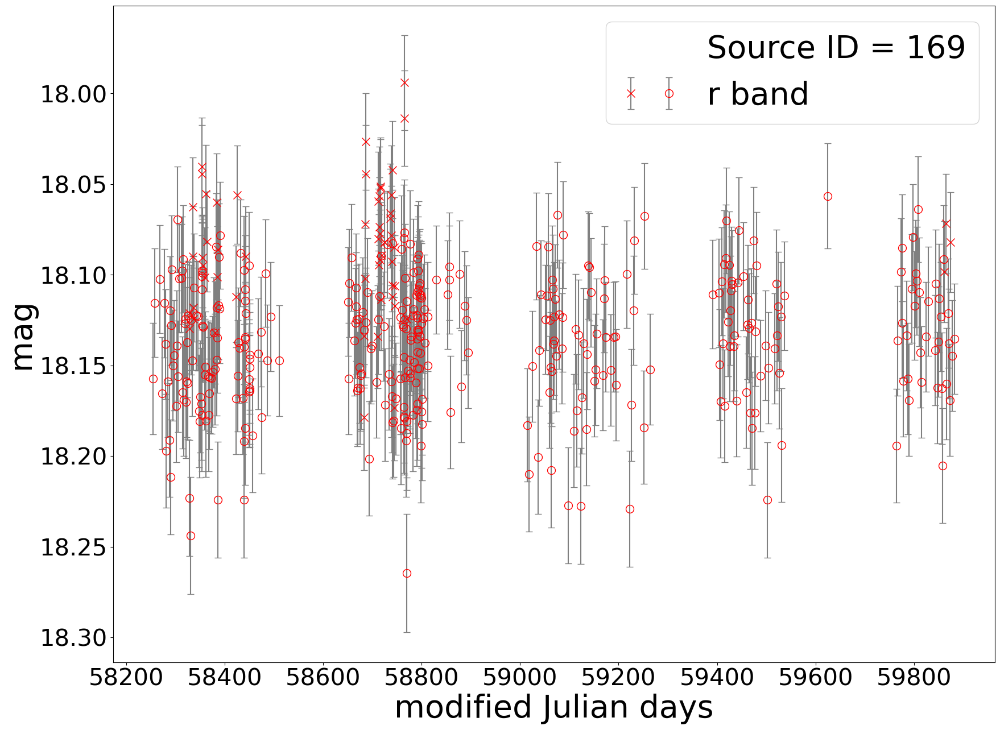

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
490,zr,806203100066997,5.1145497,59.2946405,180,352.0688171386719,24.009002830369976,5.64550651182146e-201,0.15727277100086212,0.06907922597892298,0.10966653251616149,0.9973072933112778,0.16239911373181798,0.022975292610012275,18.124507904052734,0.15727277100086212,17.787487030029297,18.680400848388672,-0.4581165313720703,4.937063694000244,0.012300301923952515,0.00974543808635721,0.06919538283213311,1.0,0.32021619846655625,0.011813461177408002,0.9817603030705776,g1,EB_ED,0.55,1.0,0.05913114709770768,[VSG2007] 1,1.683358,Star,2,1,0.39252,4.330385228301565,19.463863,212.572,0.7774,0.2823,1,0,nan,0,nan,V,V,False,True,False
490,zr,1809211300077234,5.114586,59.2945524,28,284.1361999511719,20.751958538407802,6.346828117582107e-44,0.1341477781534195,0.022687067908569274,0.11938048327180223,2800.0,0.54121305004809,0.197612271452528,18.15241813659668,0.1341477781534195,17.947158813476562,18.488935470581055,-0.37343376874923706,4.517210483551025,0.8117626211694475,0.5887026101843128,0.755272334516608,0.0,0.27332678012437817,0.3110486354935498,0.4633203738585965,gu,EB_EC,0.55,1.0,0.03811852003105538,[VSG2007] 1,1.683358,Star,2,1,0.39252,4.330385228301565,19.463863,212.572,0.7774,0.2823,1,0,nan,0,nan,V,V,False,True,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


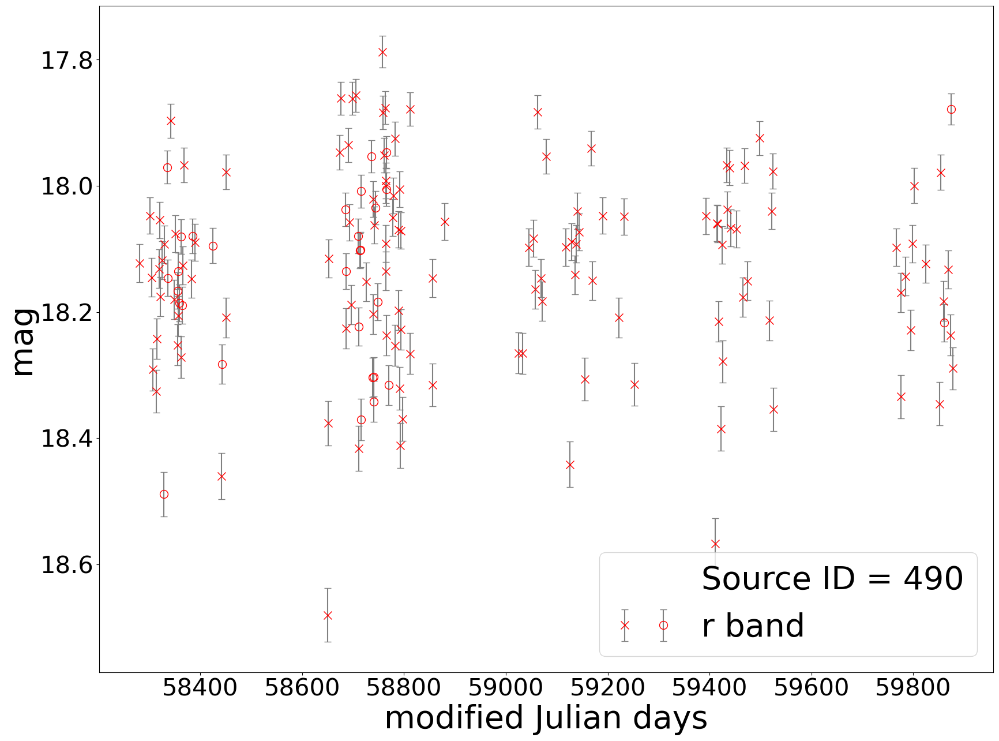

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
2307,zr,1809211300054570,5.118355,59.2939669,41,415.86395263671875,80.55811687340812,0.0,0.2537124454975128,0.0006426273748066291,375.66898999780693,2800.0,0.5155864329774303,0.9453225327729544,18.70087242126465,0.2537124454975128,17.631301879882812,19.17030906677246,-1.1935909986495972,9.245336532592773,0.03225062156858337,0.02563081916533076,0.028199606893791158,0.0,0.32197338448861523,0.40721072711584316,0.4319949887183019,gu,DSCT,0.58,1.0,0.04859787507840455,--,nan,--,1,0,1.113876,0.0,20.53087,132.056,1.9987,0.8813,1,0,nan,0,nan,V,V,False,True,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


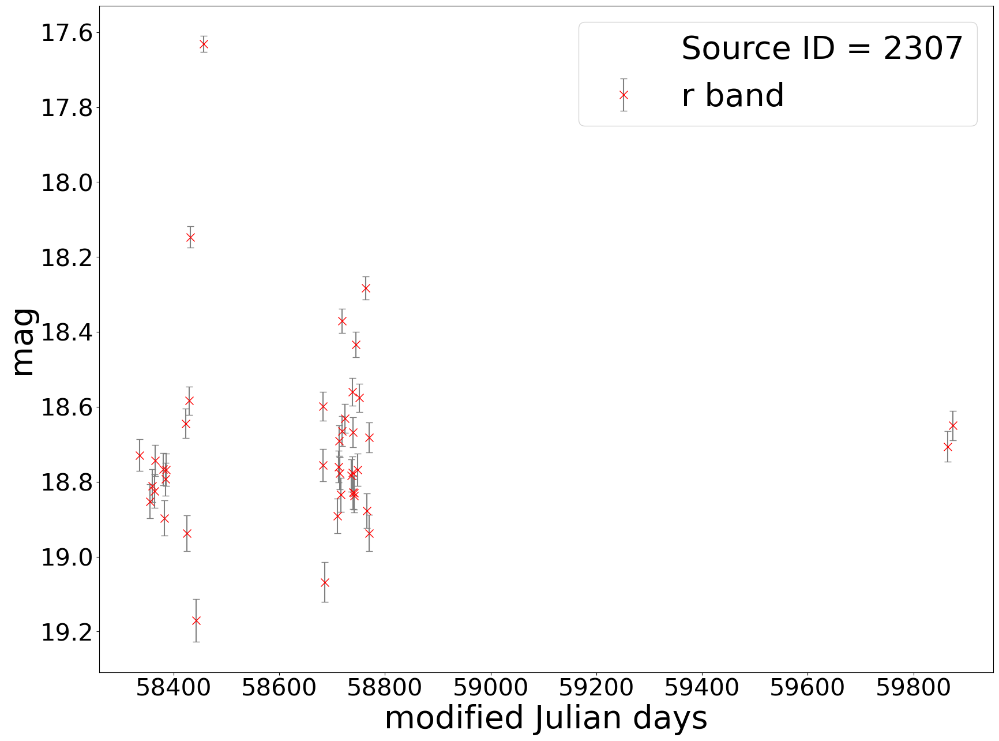

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1695,zr,1809211300070244,5.173176,59.3011713,51,70.27899932861328,0.8931348133126987,0.9997532885997995,0.03816089406609535,0.017738720491395986,0.11385600079610883,2800.0,0.35363556991355727,0.004250342642949005,18.67652130126953,0.03816089406609535,18.581134796142578,18.819435119628906,-0.024469459429383278,0.9366869330406189,0.732965683874516,0.7996884711731175,1.7975043110027706,1.0,0.5528438648279008,0.11036306325425149,0.8702370495873311,g1,EB_ESD,0.59,1.0,0.07817946489738092,--,nan,--,1,0,0.045488,0.0,18.735229,661.453,0.5946,0.1547,1,0,nan,0,nan,N,N,False,False,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


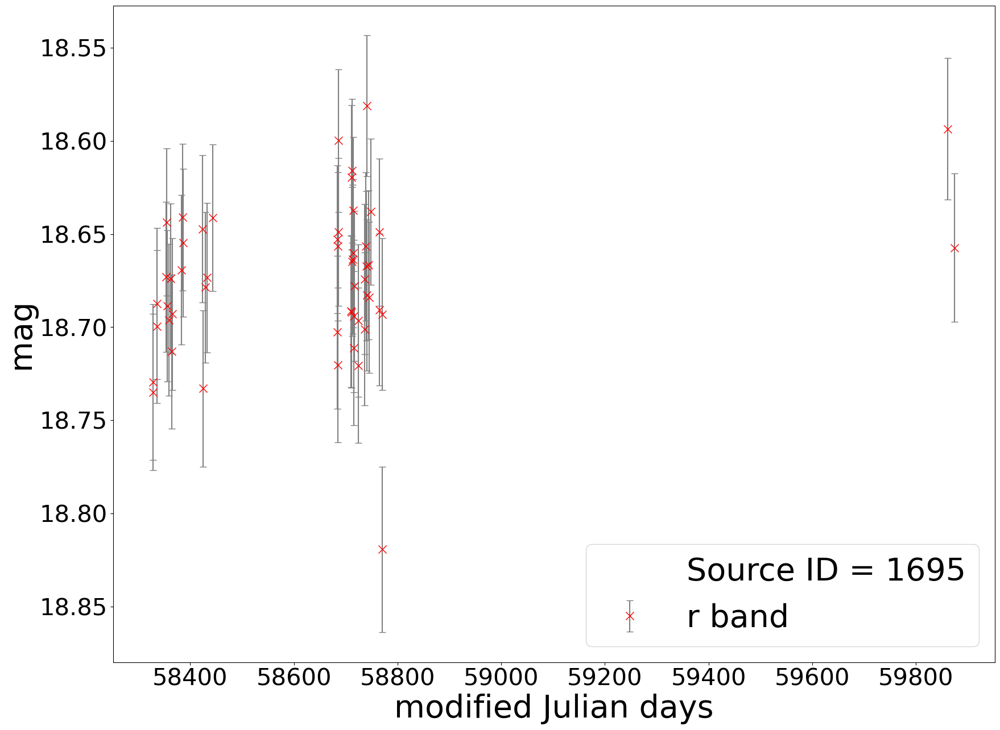

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1891,zr,1809211300066520,5.1640484,59.3340461,59,1550.8087158203125,103.1415298548053,0.0,0.13210342824459076,0.0018821367734870832,382.40917435630683,2800.0,0.37157708769350034,0.9476652791246751,16.635601043701172,0.13210342824459076,16.147106170654297,16.731998443603516,-0.3519423007965088,10.09017562866211,0.27591788960327795,0.26278085265339757,0.27591779124118027,0.0,0.44111057380006946,0.441110841105538,0.49999981844086316,gu,NonVar,0.49,1.0,0.07087877080443819,--,nan,--,1,0,0.038295,0.0,16.668589,1854.99,0.3366,0.0523,1,0,nan,0,nan,V,V,False,False,False
1891,zr,806203100056801,5.1640484,59.3340478,664,1665.8245849609375,122.44084397930696,0.0,0.16506309807300568,2.6505658952430616e-08,364.7758263188127,0.9999727412755324,0.1451138438998197,0.4828553185625195,16.62375259399414,0.16506309807300568,15.985393524169922,16.795005798339844,-0.4246886670589447,11.075775146484375,0.1161716862277041,0.005340709775377376,0.11617285311301037,0.0,0.0012825778042522273,0.0012825521539094886,0.500005115590908,g2,CEPH_Other,0.33,1.0,0.9946627735836656,--,nan,--,1,0,0.038295,0.0,16.668589,1854.99,0.3366,0.0523,1,0,nan,0,nan,V,V,False,False,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


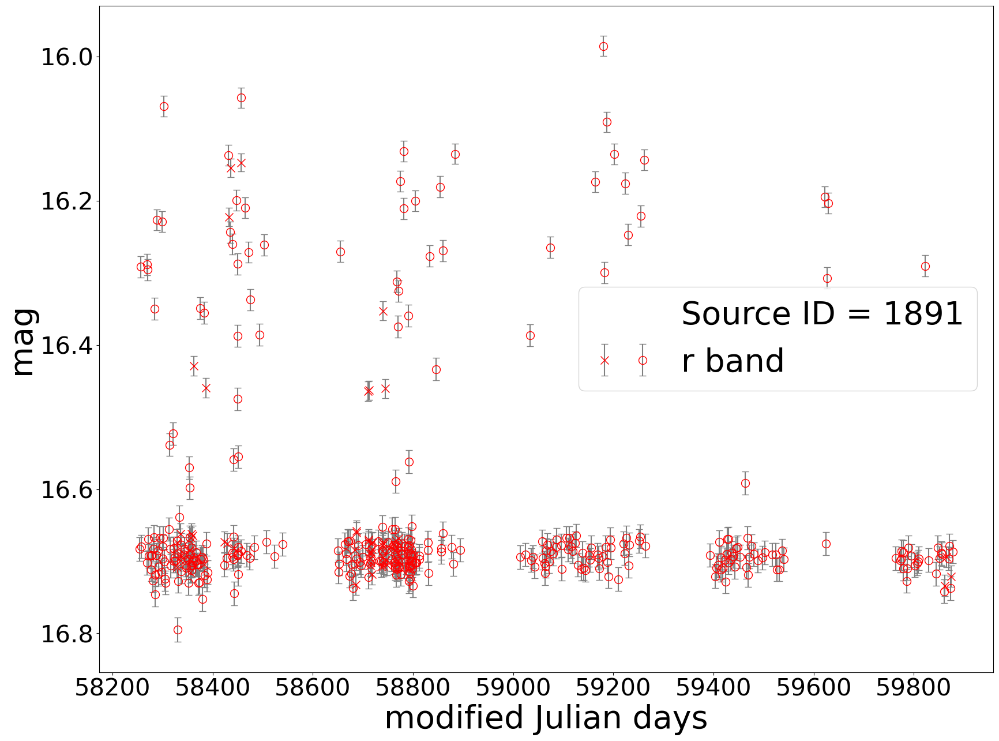

In [45]:
for id in super_red_rdet['SourceID']:
    functions.query(id)
    functions.draw_lightcurve(id)
    plt.show()

In [44]:
super_red_rg=t_zr[np.isin(t_zr['SourceID'],t_color[t_color['mean_color']>2]['SourceID'])]
super_red_rg=sourcefy(super_red_rg)
print('total, N, V, P, Gaia_count>=1, Plxflag==1')
len(super_red_rg),len(super_red_rg[super_red_rg['var']=='N']),len(super_red_rg[super_red_rg['var']=='V']),len(super_red_rg[super_red_rg['var']=='P']),len(super_red_rg[super_red_rg['Gaia_count']>=1]),len(super_red_rg[super_red_rg['Plxflag']==1])

total, N, V, P, Gaia_count>=1, Plxflag==1


(3, 0, 0, 3, 3, 0)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
242,zr,1809211300061951,5.1038373,59.3060598,77,151.92291259765625,9.179988423310819,1.4238653066326022e-36,0.1118723452091217,4.061393295324313e-28,2800.0,2800.0,0.8546843393716047,0.999252861865242,18.585941314697266,0.1118723452091217,18.367042541503906,18.836769104003906,-0.22246868908405304,3.035271406173706,2.0739763046822204,0.13455311034633735,2.4029742204543423,0.0,0.0025448752736942915,0.0018990180321010186,0.5745172575662785,g2,LPV_Mira_AGB_C,0.35,1.0,1328.6934374999983,--,nan,--,1,0,0.029164,0.0,18.194244,280.293,-0.0203,0.1251,0,0,nan,0,nan,P,V,False,True,True
242,zr,806203100023385,5.1038434,59.3060733,845,172.17822265625,12.900229107189235,0.0,0.1509360373020172,1.3576368589333471e-133,1608.4660693605288,0.997336033066433,0.7678112515459425,0.19200549998702549,18.62109375,0.1509360373020172,18.28986930847168,18.962194442749023,-0.3558894991874695,3.639608144760132,0.17372979165207011,0.07120983817504452,0.15957578862205996,0.0,0.09444107079399489,0.11100199328382321,0.45680990091966667,gu,LPV_SRV_AGB_C,0.42,0.0,1511.901550900002,--,nan,--,1,0,0.029164,0.0,18.194244,280.293,-0.0203,0.1251,0,0,nan,0,nan,P,P,False,True,True


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
242,zg,1809111300037295,5.1038235,59.3060765,18,15.16533088684082,3.7705379363914164,0.01483596253294944,0.33132243156433105,0.0004436259551644934,0.11417866930306313,2800.0,0.8405357455081746,0.1419186510537539,21.044981002807617,0.33132243156433105,20.45722198486328,21.526653289794922,-0.24278490245342255,1.9377294778823853,0.6431589074602491,0.9216150029210728,0.6440403243714153,1.0,0.8281712717041825,0.8267053752432053,0.5006974860770148,g1,DSCT,0.81,1.0,0.04613876716600469,--,nan,--,1,0,0.108766,0.0,18.194244,280.293,-0.0203,0.1251,0,0,nan,0,nan,V,N,False,True,True
242,zg,806103100040234,5.1039427,59.3059943,99,27.491024017333984,3.8212968659527315,1.1415226178643539e-07,0.2900729179382324,5.890181462146372e-05,0.4991982664127212,0.49933130012847643,0.29008560926225607,0.2559529196666049,21.076398849487305,0.2900729179382324,20.21246337890625,21.72011947631836,-0.21113216876983643,1.9854153394699097,0.047485773978203784,0.03807254729129849,0.06089522356503253,0.0,0.32703989939104416,0.20857444620329202,0.6244287516893867,g1,CEPH_Other,0.28,1.0,0.996870058324099,--,nan,--,1,0,0.108766,0.0,18.194244,280.293,-0.0203,0.1251,0,0,nan,0,nan,V,V,False,True,True


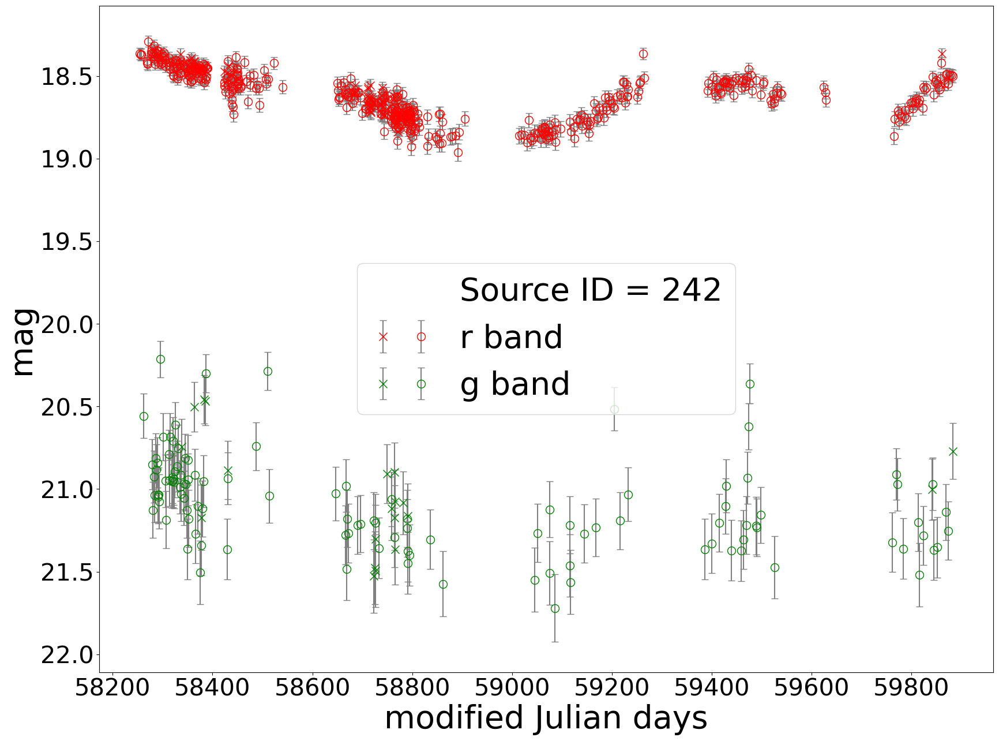

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
577,zr,1809211300042545,5.0212906,59.3011374,75,41.178768157958984,1.8229039099115485,0.6915118941604181,0.10079668462276459,2.1730101623125046e-05,461.33361604269834,2800.0,0.3908003659404083,0.8412960993499896,19.528972625732422,0.10079668462276459,19.30409049987793,19.803613662719727,-0.10010941326618195,1.3520498275756836,0.9795822726267246,0.8953979564122676,1.3998331362436465,0.0,0.4111926027452868,0.21750569556046684,0.6752917828186883,g1,LPV_OSARG_AGB,0.27,1.0,662.8055033999954,[LSG2012] 8,0.147983,Star,1,0,0.149896,0.0,19.213329,242.449,-0.0645,0.2698,0,0,nan,0,nan,P,N,False,True,True
577,zr,806203100052140,5.0212644,59.3011632,783,60.10373306274414,3.998457426038887,2.2769111621165645e-29,0.15452392399311066,3.505039931858041e-89,514.2583783763998,0.997336033066433,0.6515261216701516,0.16769798658123697,19.517370223999023,0.15452392399311066,19.09247589111328,20.017894744873047,-0.21818828582763672,2.032727003097534,0.049349970380050893,0.005259658863852333,0.12249745592155693,0.0,0.006811675726030253,0.0011194458496702753,0.8733254051966455,g2,LPV_SRV_AGB_O,0.34,0.0,503.96718363333395,[LSG2012] 8,0.147983,Star,1,0,0.149896,0.0,19.213329,242.449,-0.0645,0.2698,0,0,nan,0,nan,P,P,False,True,True


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
577,zg,806103100047200,5.021257,59.3012238,14,6.262895107269287,0.5153127451279951,0.996350367767769,0.143199160695076,0.0032950078729657,0.1068804004183145,0.9973856118252358,0.878282264293837,0.8283265832912982,21.71224594116211,0.143199160695076,21.47152328491211,22.01458740234375,-0.02947191707789898,0.6936047077178955,3.253210377747641,5.574360308482902,3.2783694018541363,1.0,0.9925623059271225,0.9882546765128285,0.5039234695937239,g1,RRL_e,0.52,1.0,0.2573489569760026,[LSG2012] 8,0.403812,Star,1,0,0.405802,0.0,19.213329,242.449,-0.0645,0.2698,0,0,nan,0,nan,N,N,False,True,True


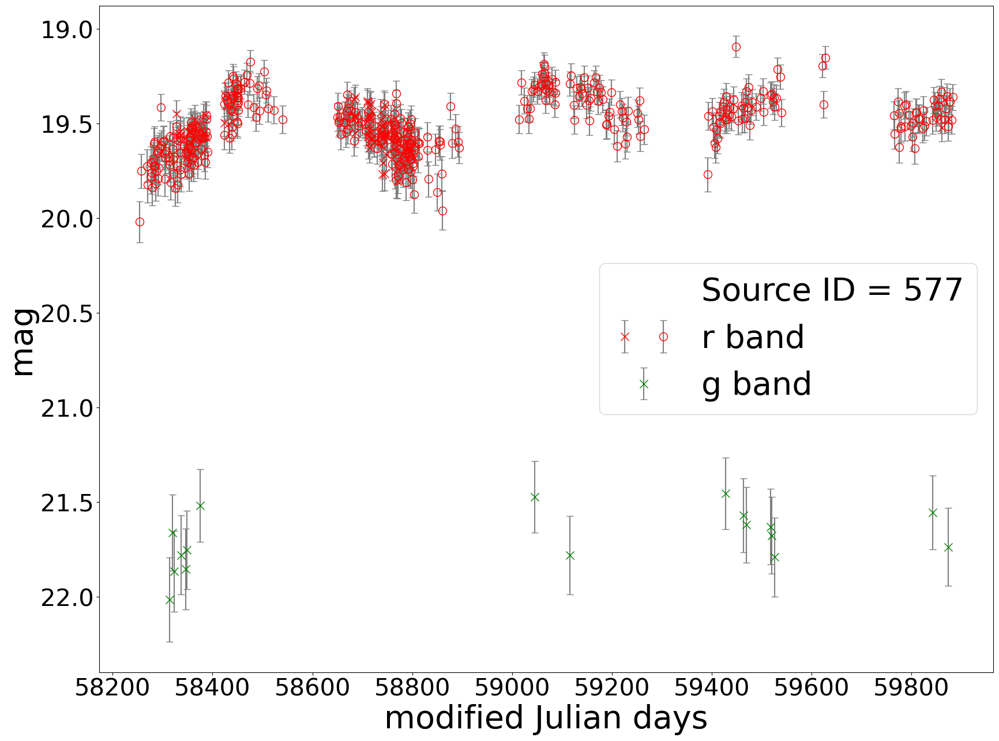

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1259,zr,1809211300054323,4.9903162,59.309786,75,83.78254699707031,8.431957220726579,5.59547491003204e-31,0.18400932848453522,4.583792664507863e-28,0.9958171307845928,2800.0,0.8612023027003737,0.23799697646338128,19.200042724609375,0.18400932848453522,18.914241790771484,19.65231704711914,-0.4064527750015259,2.959434986114502,0.9375791837256878,0.11415319734268957,0.652306485735732,0.0,0.008862507805999731,0.018112650122262153,0.3220670989634954,g2,LPV_Mira_AGB_C,0.28,1.0,1328.6934374999983,2MASS J00195768+5918349,0.317364,Star,2,1,0.340133,2.9640723665099458,18.963146,206.06,-1.1776,0.2642,0,0,nan,0,nan,P,V,False,True,True
1259,zr,806203100052030,4.9902651,59.3098018,776,76.14414978027344,12.64776812461389,0.0,0.258216917514801,4.921772867293347e-90,595.2450708466688,0.997336033066433,0.6449320370661895,0.15672682858420706,19.392343521118164,0.258216917514801,18.893497467041016,20.062400817871094,-0.6607047915458679,3.726458787918091,0.0866635374439143,0.10843782706678352,0.095448189013291,0.0,0.6846732291353879,0.5898899729679574,0.5490393466806511,g1,LPV_OSARG_AGB,0.42,0.0,647.9578075285723,2MASS J00195768+5918349,0.317364,Star,2,1,0.340133,2.9640723665099458,18.963146,206.06,-1.1776,0.2642,0,0,nan,0,nan,P,P,False,True,True


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1259,zg,1809111300028563,4.9902354,59.3097825,17,21.803075790405273,6.229240260295615,2.436396983567766e-05,0.3671668767929077,0.0009048600456026635,0.32107655896718035,2800.0,0.8358561031630232,0.22271989761244132,21.091720581054688,0.3671668767929077,20.131011962890625,21.48634147644043,-0.35144945979118347,2.5250205993652344,0.2577998264811264,0.26371669826535393,0.2647497389165131,1.0,0.4974148459031007,0.4758232977875162,0.5135452781999374,g1,DSCT,0.6,1.0,0.05262031910418057,2MASS J00195768+5918349,0.449805,Star,2,1,0.487396,2.9640723665099458,18.963146,206.06,-1.1776,0.2642,0,0,nan,0,nan,N,N,False,True,True
1259,zg,806103100019841,4.9902207,59.3098564,65,21.40563201904297,2.9726043337711983,0.006326770135686528,0.28976717591285706,3.420551073265564e-05,0.5079508727255034,0.9973595499550357,0.41136938231778825,0.2855300080110687,21.355058670043945,0.28976717591285706,20.51747703552246,21.908727645874023,-0.16565898060798645,1.7380403280258179,0.043371810910507735,0.042789338462104774,0.06922001227330414,0.0,0.46820827846388047,0.20426525523339767,0.7238141757477983,g1,DSCT,0.77,1.0,0.05991865666666658,2MASS J00195768+5918349,0.449805,Star,2,1,0.487396,2.9640723665099458,18.963146,206.06,-1.1776,0.2642,0,0,nan,0,nan,N,N,False,True,True


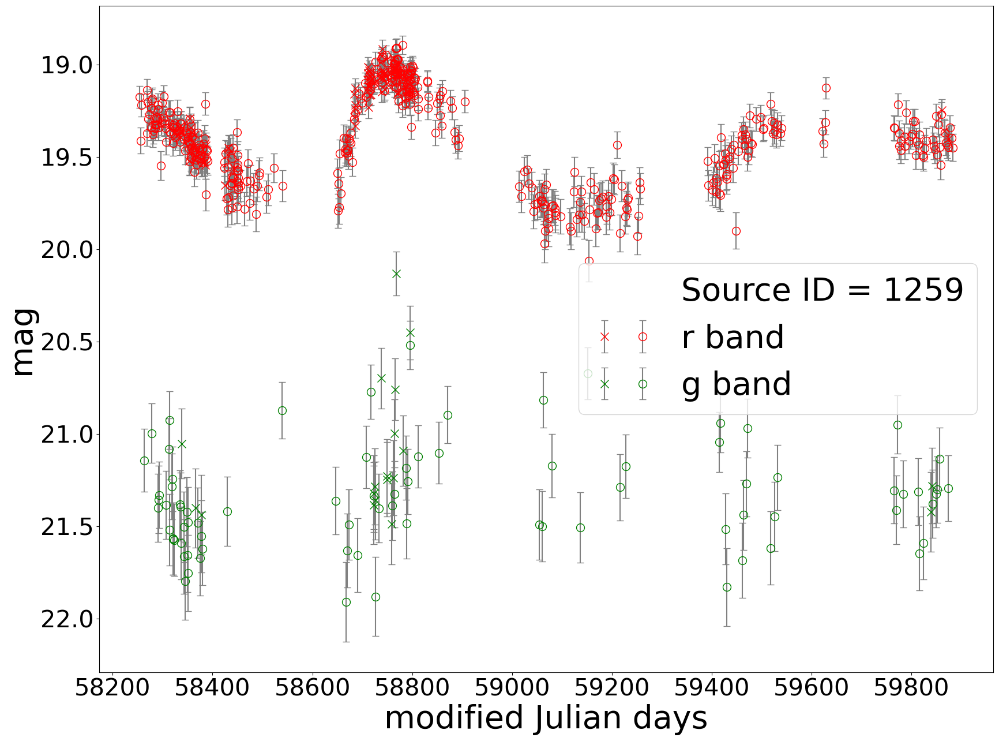

In [46]:
for id in super_red_rg['SourceID']:
    functions.query(id)
    functions.draw_lightcurve(id)
    plt.show()

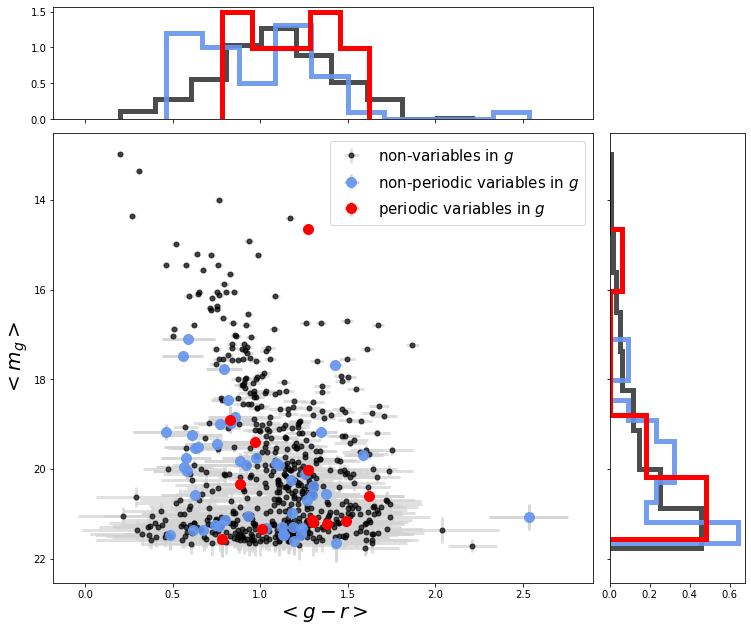

In [151]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.invert_yaxis()


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

# nonvar_zg
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(nonvar_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_g'],t_plot['std_color'],t_plot['std_mag_g'],'black',0.7,5,'non-variables in $g$'
             ,ax, ax_histx, ax_histy)

# unobj_zg
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(unobj_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_g'],t_plot['std_color'],t_plot['std_mag_g'],'cornflowerblue',0.9,10,'non-periodic variables in $g$'
             ,ax, ax_histx, ax_histy)

# obj_zg
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(obj_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_g'],t_plot['std_color'],t_plot['std_mag_g'],'red',1,10,'periodic variables in $g$'
             ,ax, ax_histx, ax_histy,bins=5)

ax.set_xlabel('$<g - r>$',fontsize=20)
ax.set_ylabel('$<m_g>$',fontsize=20)
ax.legend(loc=0,fontsize=15)

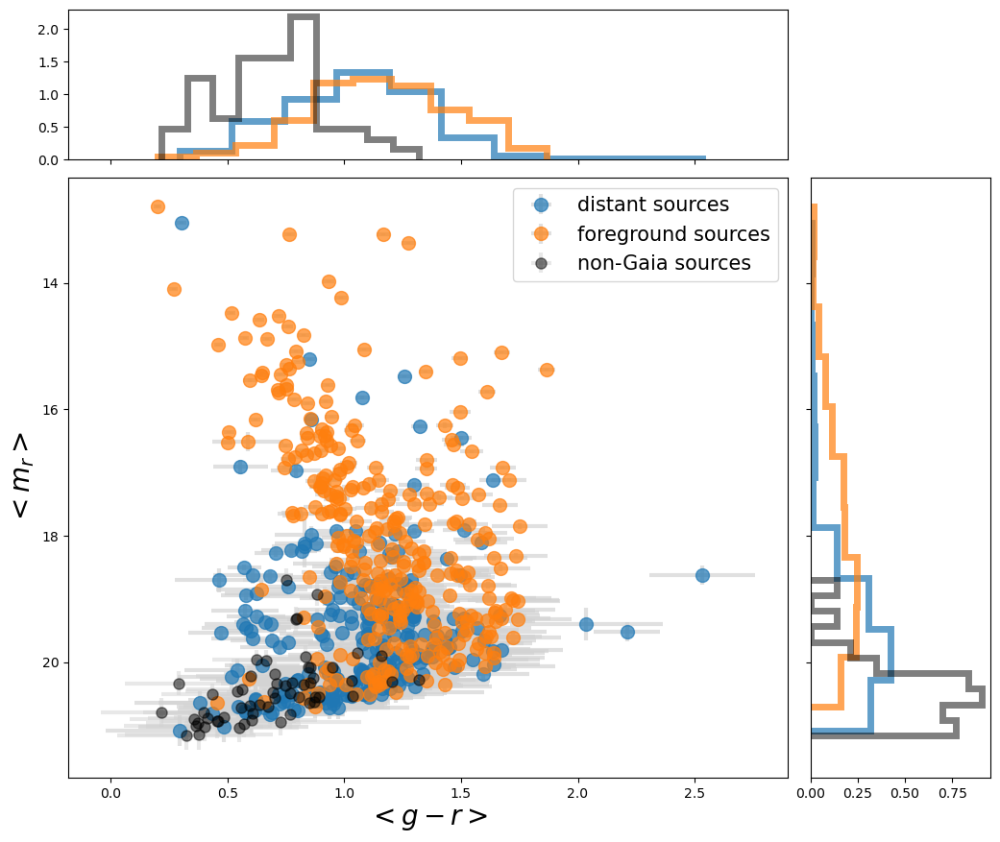

In [43]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.invert_yaxis()


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

t_zr_gaia=t_zr[t_zr['Gaia_count']>0]

# inside IC 10
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr_gaia[t_zr_gaia['Plxflag']==0]['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_r'],t_plot['std_color'],t_plot['std_mag_r'],'#1f77b4',0.7,10,'distant sources'
             ,ax, ax_histx, ax_histy)

# outside IC 10
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr_gaia[t_zr_gaia['Plxflag']==1]['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
scatter_hist(t_plot['mean_color'], t_plot['mean_mag_r'],t_plot['std_color'],t_plot['std_mag_r'],'#ff7f0e',0.7,10,'foreground sources'
             ,ax, ax_histx, ax_histy)

# non-gaia
t_zr_nongaia = t_zr[t_zr['Gaia_count']==0]
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr_nongaia['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
scatter_hist(t_plot['mean_color'], t_plot['mean_mag_r'],t_plot['std_color'],t_plot['std_mag_r'],'black',0.5,8,'non-Gaia sources'
             ,ax, ax_histx, ax_histy)


ax.set_xlabel('$<g - r>$',fontsize=20)
ax.set_ylabel('$<m_r>$',fontsize=20)
ax.legend(loc=0,fontsize=15)

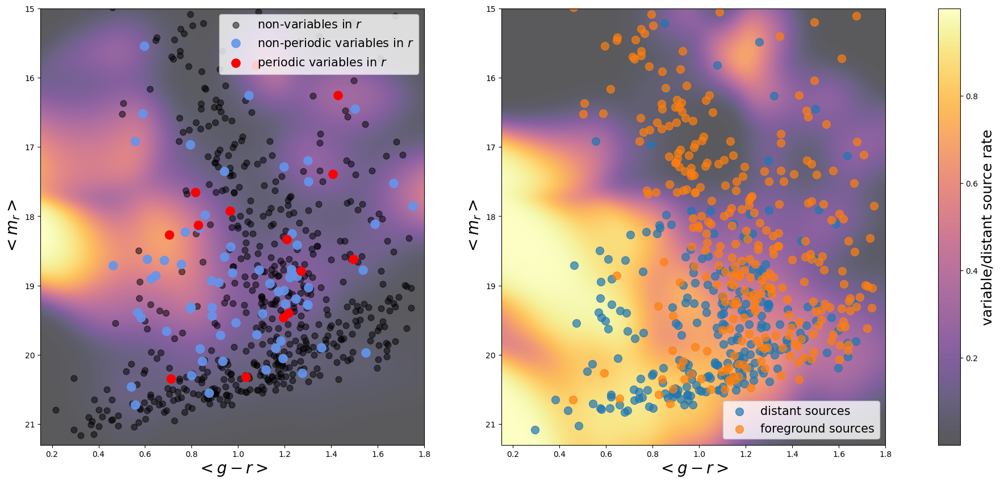

In [128]:
# plot Z_ratio and Z_ratio_dist side by side, with the same color bar
fig = plt.figure(figsize=(24,10))
ax1 = fig.add_subplot(121)

# nonvar_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(nonvar_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

ax1.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='black',marker='o',alpha=0.5,s=60,label='non-variables in $r$')
unvar_group = t_plot

# unobj_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(unobj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

ax1.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='cornflowerblue',marker='o',alpha=0.9,s=120,label='non-periodic variables in $r$')
var_group = t_plot

# obj_zr
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(obj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

ax1.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='red',marker='o',alpha=1,s=120,label='periodic variables in $r$')
var_group = vstack([var_group, t_plot])

unvar_group = unvar_group['mean_color','mean_mag_r'].to_pandas().to_numpy()
var_group = var_group['mean_color','mean_mag_r'].to_pandas().to_numpy()
full_group = np.vstack([unvar_group, var_group])

# Define the grid
# x_min, x_max = full_group[:, 0].min() - 0.25, full_group[:, 0].max() + 0.25
# y_min, y_max = full_group[:, 1].min() - 0.5, full_group[:, 1].max() + 0.5
x_min, x_max = 0.15 , 1.8
y_min, y_max = 15 , 21.3

X, Y = np.mgrid[x_min:x_max:300j, y_min:y_max:300j]
positions = np.vstack([X.ravel(), Y.ravel()])

# Create the kernel density estimate
kernel_unvar = gaussian_kde(unvar_group.T,bw_method=0.3)
kernel_var= gaussian_kde(var_group.T,bw_method=0.3)

# Calculate densities
Z_unvar = np.reshape(kernel_unvar(positions).T, X.shape)
Z_var = np.reshape(kernel_var(positions).T, X.shape)

Z_unvar = Z_unvar*unvar_group.shape[0]/Z_unvar.sum()
Z_var = Z_var*var_group.shape[0]/Z_var.sum()

Z_ratio = Z_var/(Z_unvar+Z_var)


c = ax1.imshow(np.rot90(Z_ratio), cmap='inferno', extent=[x_min, x_max, y_min, y_max],aspect='auto',alpha=0.65)
#fig.colorbar(c, ax=ax,label='variability rate')
ax1.set_xlim(x_min,x_max)
ax1.set_ylim(y_min,y_max)
ax1.invert_yaxis()
ax1.set_xlabel('$<g - r>$',fontsize=20)
ax1.set_ylabel('$<m_r>$',fontsize=20)
ax1.legend(loc=0,fontsize=15)

ax2 = fig.add_subplot(122)
t_zr_gaia=t_zr[t_zr['Gaia_count']>0]

# inside IC 10
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr_gaia[t_zr_gaia['Plxflag']==0]['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

ax2.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='#1f77b4',marker='o',alpha=0.7,s=100,label='distant sources')
dist_group = t_plot

# outside IC 10
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr_gaia[t_zr_gaia['Plxflag']==1]['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

ax2.scatter(t_plot['mean_color'], t_plot['mean_mag_r'],color='#ff7f0e',marker='o',alpha=0.7,s=100,label='foreground sources')
fg_group = t_plot

dist_group = dist_group['mean_color','mean_mag_r'].to_pandas().to_numpy()
fg_group = fg_group['mean_color','mean_mag_r'].to_pandas().to_numpy()
full_group = np.vstack([dist_group, fg_group])

# Define the grid
# x_min, x_max = full_group[:, 0].min() - 0.25, full_group[:, 0].max() + 0.25
# y_min, y_max = full_group[:, 1].min() - 0.5, full_group[:, 1].max() + 0.5
x_min, x_max = 0.15 , 1.8
y_min, y_max = 15 , 21.3

X, Y = np.mgrid[x_min:x_max:300j, y_min:y_max:300j]
positions = np.vstack([X.ravel(), Y.ravel()])
# Create the kernel density estimate
kernel_dist = gaussian_kde(dist_group.T,bw_method=0.3)
kernel_fg= gaussian_kde(fg_group.T,bw_method=0.3)
# Calculate densities
Z_dist = np.reshape(kernel_dist(positions).T, X.shape)
Z_fg = np.reshape(kernel_fg(positions).T, X.shape)

Z_dist = Z_dist*dist_group.shape[0]/Z_dist.sum()
Z_fg = Z_fg*fg_group.shape[0]/Z_fg.sum()

Z_ratio_dist = Z_dist/(Z_dist+Z_fg)

c = ax2.imshow(np.rot90(Z_ratio_dist), cmap='inferno', extent=[x_min, x_max, y_min, y_max],aspect='auto',alpha=0.65)
ax2.set_xlim(x_min,x_max)
ax2.set_ylim(y_min,y_max)
ax2.invert_yaxis()
ax2.set_xlabel('$<g - r>$',fontsize=20)
ax2.set_ylabel('$<m_r>$',fontsize=20)
ax2.legend(loc=0,fontsize=15)

fig.colorbar(c,ax=[ax1,ax2]).set_label('variable/distant source rate',fontsize=18)

In [75]:
t_zr_gaia=t_zr[t_zr['Gaia_count']>0]
t_zr_gaia=sourcefy(t_zr_gaia)
df_color=t_color.to_pandas()
df_color.dropna(subset=['mean_color'],inplace=True)

distant_ids = np.unique(t_zr_gaia[t_zr_gaia['Plxflag']==0]['SourceID'])
foreground_ids = np.unique(t_zr_gaia[t_zr_gaia['Plxflag']==1]['SourceID'])
IC10_distant_modulus = 24
E_BV = 0.98
Av=3.1*E_BV
Ag=1.19*Av
Ar=0.834*Av

for i,row in df_color.iterrows():
    if row['SourceID'] in distant_ids:
        df_color.at[i,'var'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['var']
        df_color.at[i,'Plxflag'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['Plxflag']
        df_color.at[i,'ic10_flag'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['ic10_flag']
        df_color.at[i,'type'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['type']
        df_color.at[i,'XMM']= t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['XMM']
        df_color.at[i,'Chandra'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['Chandra']

        if df_color.at[i,'ic10_flag']==1:
            df_color.at[i,'intrinsic_mag_r'] = row['mean_mag_r'] - Ar
            df_color.at[i,'intrinsic_color'] = row['mean_color'] + (Ar-Ag)
            df_color.at[i,'absolute_mag_r'] = df_color.at[i,'intrinsic_mag_r'] - IC10_distant_modulus
        else:
            df_color.at[i,'absolute_mag_r'] = row['mean_mag_r'] - IC10_distant_modulus
            
    if row['SourceID'] in foreground_ids:
        plx = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['Plx']
        d = 1/(plx*0.001)
        df_color.at[i,'absolute_mag_r'] = row['mean_mag_r'] - 5*np.log10(d)+5
        df_color.at[i,'var'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['var']
        df_color.at[i,'Plxflag'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['Plxflag']
        df_color.at[i,'ic10_flag'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['ic10_flag']
        df_color.at[i,'type'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['type']
        df_color.at[i,'XMM']= t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['XMM']
        df_color.at[i,'Chandra'] = t_zr_gaia[t_zr_gaia['SourceID']==row['SourceID']]['Chandra']

In [79]:
#df_color.to_csv('df_color.csv',index=False)
df_color=pd.read_csv('df_color.csv')

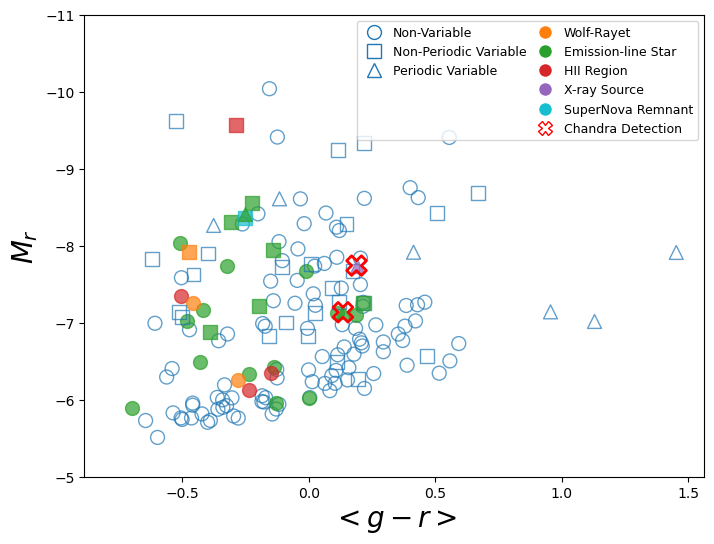

In [82]:
plt.figure(figsize=(8,6))
t_plot=df_color[df_color['ic10_flag']==1]
# make new columns in t_color to store plot styles.
colors={'0':'none','WR*':'C1','Em*':'C2','HII':'C3','X':'C4','SNR':'C9','Cl*':'none','Star':'none','multiple_object':'none','GinGroup':'none'}
edgecolors={'0':'C0','WR*':'C1','Em*':'C2','HII':'C3','X':'C4','SNR':'C9','Cl*':'C0','Star':'C0','multiple_object':'C0','GinGroup':'C0'}
marker={'N':'o','V':'s','P':'^'}
# marker={'0':'o','WR*':'s','Em*':'^','HII':'*','X':'X','SNR':'p','Cl*':'o','Star':'o','multiple_object':'o'}
# colors={'N':'C0','V':'C1','P':'C2'}
for vartype in ['N','V','P']:
    for simbadtype in np.unique(t_plot['type'].tolist()):
        mask_array=(np.array(t_plot['type'].tolist())==simbadtype)&(t_plot['var']==vartype)
        plt.scatter(t_plot[mask_array]['intrinsic_color'],t_plot[mask_array]['absolute_mag_r'],
                    facecolors=colors[simbadtype],
                    edgecolors=edgecolors[simbadtype],
                    marker=marker[vartype],
                    s=100,alpha=0.7)
plt.scatter(t_plot[t_plot['Chandra']==1]['intrinsic_color'],t_plot[t_plot['Chandra']==1]['absolute_mag_r'],color='red',marker='X',s=200,facecolors='none',linewidth=2)
plt.scatter(t_plot[t_plot['XMM']==1]['intrinsic_color'],t_plot[t_plot['XMM']==1]['absolute_mag_r'],color='red',marker='P',s=200,facecolors='none',linewidth=2)


plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$M_r$',fontsize=20)

# Rework the legend
legend_elements = []
legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', label='Non-Variable', markerfacecolor='none',markeredgecolor='C0', markersize=10))
legend_elements.append(plt.Line2D([0], [0], marker='s', color='w', label='Non-Periodic Variable', markerfacecolor='none',markeredgecolor='C0', markersize=10))
legend_elements.append(plt.Line2D([0], [0], marker='^', color='w', label='Periodic Variable', markerfacecolor='none',markeredgecolor='C0', markersize=10))
type_list = ['WR*','Em*','HII','X','SNR']
names=['Wolf-Rayet','Emission-line Star','HII Region','X-ray Source','SuperNova Remnant']


for i,name in enumerate(type_list):
    legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', label=names[i], markerfacecolor=colors[name], markersize=10))

legend_elements.append(plt.Line2D([0], [0], marker='X', color='red', label='Chandra Detection', markerfacecolor='w', markersize=10,linestyle=''))

#plt.legend(handles=legend_elements, loc=0, fontsize=10, ncol=2)

# Add empty legend entries to ensure correct column split
legend_elements.insert(3, plt.Line2D([0], [0], marker='', color='w', label=''))
legend_elements.insert(3, plt.Line2D([0], [0], marker='', color='w', label=''))
legend_elements.insert(3, plt.Line2D([0], [0], marker='', color='w', label=''))

# Create a custom legend with two columns
plt.legend(handles=legend_elements, loc=0, fontsize=9, ncol=2, columnspacing=0.5, handletextpad=0.5)
plt.ylim(-11,-5)

plt.gca().invert_yaxis()

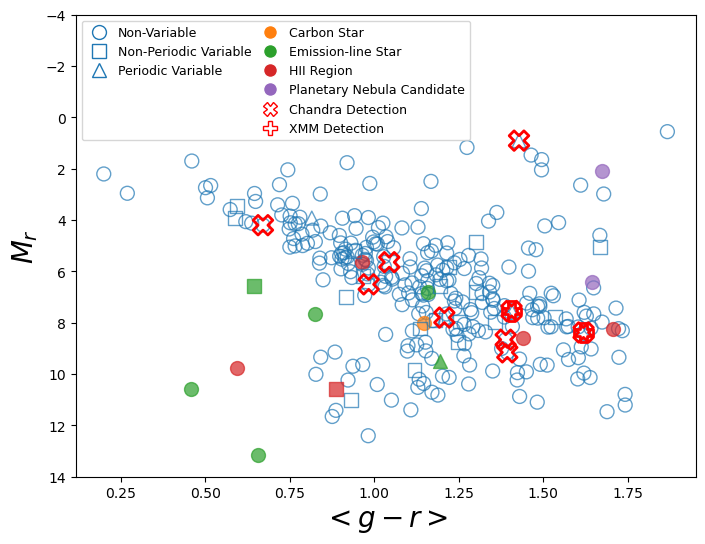

In [83]:
plt.figure(figsize=(8,6))
t_plot=df_color[df_color['Plxflag']==1]
# make new columns in t_color to store plot styles.
colors={'0':'none','C*':'C1','Em*':'C2','HII':'C3','PN?_Candidate':'C4','Cl*':'none','Star':'none','PartofG':'none','GinGroup':'none'}
edgecolors={'0':'C0','C*':'C1','Em*':'C2','HII':'C3','PN?_Candidate':'C4','Cl*':'C0','Star':'C0','PartofG':'none','GinGroup':'C0'}
marker={'N':'o','V':'s','P':'^'}
# marker={'0':'o','WR*':'s','Em*':'^','HII':'*','X':'X','SNR':'p','Cl*':'o','Star':'o','multiple_object':'o'}
# colors={'N':'C0','V':'C1','P':'C2'}
for vartype in ['N','V','P']:
    for simbadtype in np.unique(t_plot['type'].tolist()):
        mask_array=(np.array(t_plot['type'].tolist())==simbadtype)&(t_plot['var']==vartype)
        plt.scatter(t_plot[mask_array]['mean_color'],t_plot[mask_array]['absolute_mag_r'],
                    facecolors=colors[simbadtype],
                    edgecolors=edgecolors[simbadtype],
                    marker=marker[vartype],
                    s=100,alpha=0.7)
plt.scatter(t_plot[t_plot['Chandra']==1]['mean_color'],t_plot[t_plot['Chandra']==1]['absolute_mag_r'],color='red',marker='X',s=200,facecolors='none',linewidth=2)
plt.scatter(t_plot[t_plot['XMM']==1]['mean_color'],t_plot[t_plot['XMM']==1]['absolute_mag_r'],color='red',marker='P',s=200,facecolors='none',linewidth=2)


plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$M_r$',fontsize=20)

# Rework the legend
legend_elements = []
legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', label='Non-Variable', markerfacecolor='none',markeredgecolor='C0', markersize=10))
legend_elements.append(plt.Line2D([0], [0], marker='s', color='w', label='Non-Periodic Variable', markerfacecolor='none',markeredgecolor='C0', markersize=10))
legend_elements.append(plt.Line2D([0], [0], marker='^', color='w', label='Periodic Variable', markerfacecolor='none',markeredgecolor='C0', markersize=10))
type_list = ['C*','Em*','HII','PN?_Candidate']
names=['Carbon Star','Emission-line Star','HII Region','Planetary Nebula Candidate']

for i,name in enumerate(type_list):
    legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', label=names[i], markerfacecolor=colors[name], markersize=10))

legend_elements.append(plt.Line2D([0], [0], marker='X', color='red', label='Chandra Detection', markerfacecolor='w', markersize=10,linestyle=''))
legend_elements.append(plt.Line2D([0], [0], marker='P', color='red', label='XMM Detection', markerfacecolor='w', markersize=10,linestyle=''))

#plt.legend(handles=legend_elements, loc=0, fontsize=8)

# Add empty legend entries to ensure correct column split
legend_elements.insert(3, plt.Line2D([0], [0], marker='', color='w', label=''))
legend_elements.insert(3, plt.Line2D([0], [0], marker='', color='w', label=''))
legend_elements.insert(3, plt.Line2D([0], [0], marker='', color='w', label=''))

# Create a custom legend with two columns
plt.legend(handles=legend_elements, loc='upper left', fontsize=9, ncol=2, columnspacing=0.5, handletextpad=0.5)

plt.ylim(-4,14)

plt.gca().invert_yaxis()

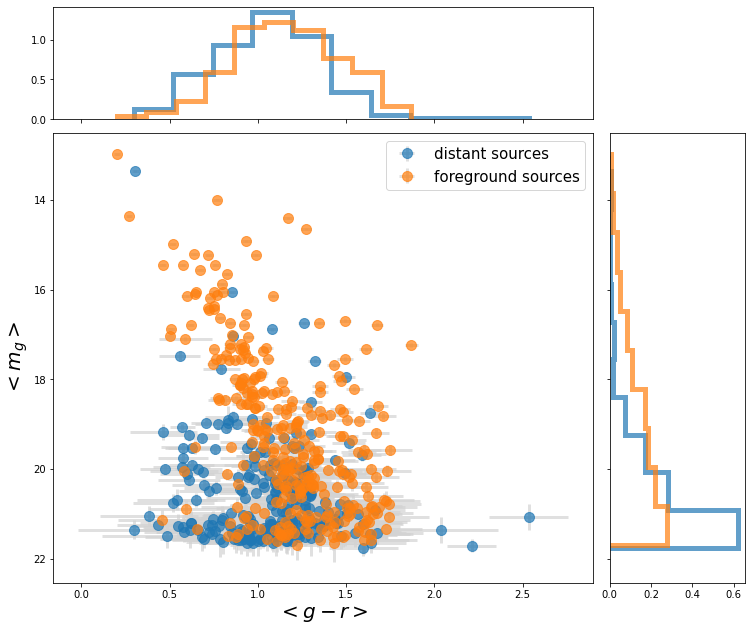

In [37]:
# Start with a square Figure.
fig = plt.figure(figsize=(12,10))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax = fig.add_subplot(gs[1, 0])
ax.invert_yaxis()


ax_histx = fig.add_subplot(gs[0, 0], sharex=ax)
ax_histy = fig.add_subplot(gs[1, 1], sharey=ax)
# Draw the scatter plot and marginals.

t_zg_gaia=t_zg[t_zg['Gaia_count']>0]

# inside IC 10
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zg_gaia[t_zg_gaia['Plxflag']==0]['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]

scatter_hist(t_plot['mean_color'], t_plot['mean_mag_g'],t_plot['std_color'],t_plot['std_mag_g'],'#1f77b4',0.7,10,'distant sources'
             ,ax, ax_histx, ax_histy)

# outside IC 10
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zg_gaia[t_zg_gaia['Plxflag']==1]['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
scatter_hist(t_plot['mean_color'], t_plot['mean_mag_g'],t_plot['std_color'],t_plot['std_mag_g'],'#ff7f0e',0.7,10,'foreground sources'
             ,ax, ax_histx, ax_histy)

ax.set_xlabel('$<g - r>$',fontsize=20)
ax.set_ylabel('$<m_g>$',fontsize=20)
ax.legend(loc=0,fontsize=15)

In [27]:
for tp in np.unique(t_zr['type']):
    if tp!='--':
        count=len(sourcefy(t_zr[t_zr['type']==tp]))
        color=t_color[np.isin(t_color['SourceID'],np.unique(t_zr[t_zr['type']==tp]['SourceID']))]
        colorcount=len(color[~np.isnan(color['mean_color'])])
        print(tp,':',count,',',colorcount)

C* : 14 , 1
Cl* : 57 , 31
Em* : 50 , 31
GinGroup : 1 , 1
HII : 33 , 12
HIshell : 2 , 0
MIR : 2 , 0
Maser : 1 , 0
MolCld : 2 , 0
PN?_Candidate : 8 , 4
PartofG : 2 , 1
Radio : 6 , 2
SNR : 1 , 1
SNR?_Candidate : 1 , 0
Star : 24 , 11
WR* : 18 , 5
WR*_Candidate : 1 , 0
X : 1 , 1
multiple_object : 1 , 1


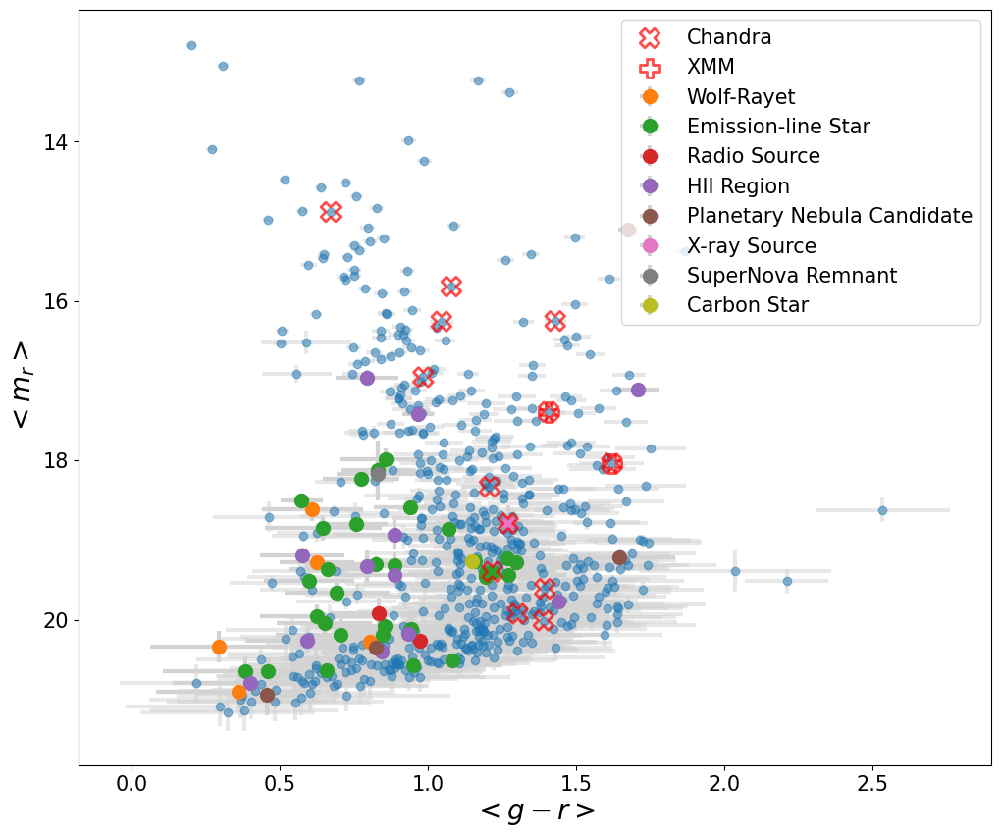

In [37]:
plt.figure(figsize=(12,10))
plt.gca().invert_yaxis()
plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$<m_r>$',fontsize=20)
alpha=1

# all
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_r'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_r'],fmt='o',
             ecolor='lightgray', elinewidth=3, capsize=0,alpha=0.5)

types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

for i,tp in enumerate(types):
    t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr[t_zr['type']==tp]['SourceID']))]
    t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
    plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_r'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_r'],fmt='o',markersize=10,
             ecolor='lightgray', elinewidth=3, capsize=0,alpha=alpha,label=names[i])

t_plot=pd.read_csv('df_color.csv')
plt.scatter(t_plot[t_plot['Chandra']==1]['mean_color'],t_plot[t_plot['Chandra']==1]['mean_mag_r'],color='red',marker='X',s=200,facecolors='none',linewidth=2,label='Chandra',zorder=9,alpha=0.7)
plt.scatter(t_plot[t_plot['XMM']==1]['mean_color'],t_plot[t_plot['XMM']==1]['mean_mag_r'],color='red',marker='P',s=200,facecolors='none',linewidth=2,label='XMM',zorder=10,alpha=0.7)

#plt.xlim(0,2)
#plt.ylim(21,18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc=0,fontsize=15)

In [155]:
for tp in np.unique(t_zg['type']):
    if tp!='--':
        count=len(sourcefy(t_zg[t_zg['type']==tp]))
        color=t_color[np.isin(t_color['SourceID'],np.unique(t_zg[t_zg['type']==tp]['SourceID']))]
        colorcount=len(color[~np.isnan(color['mean_color'])])
        print(tp,':',count,',',colorcount)

C* : 5 , 2
Cl* : 46 , 32
Em* : 40 , 31
GinGroup : 1 , 1
HII : 16 , 11
PN : 1 , 0
PN?_Candidate : 6 , 4
PartofG : 2 , 1
Radio : 2 , 1
SNR : 3 , 2
Star : 12 , 10
WR* : 16 , 5
X : 1 , 1
multiple_object : 2 , 1


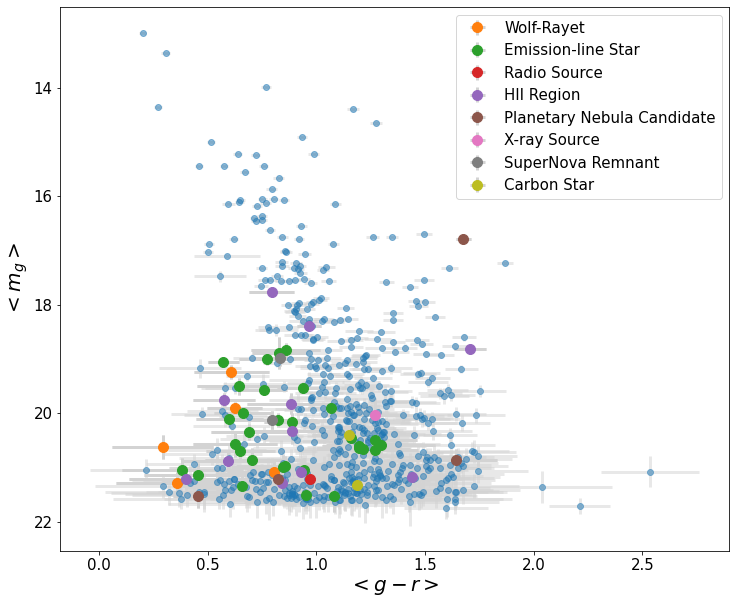

In [156]:
plt.figure(figsize=(12,10))
plt.gca().invert_yaxis()
plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$<m_g>$',fontsize=20)
alpha=1

# all
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_g'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_g'],fmt='o',
             ecolor='lightgray', elinewidth=3, capsize=0,alpha=0.5)

types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

for i,tp in enumerate(types):
    t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zg[t_zg['type']==tp]['SourceID']))]
    t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
    plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_g'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_g'],fmt='o',markersize=10,
             ecolor='lightgray', elinewidth=3, capsize=0,alpha=alpha,label=names[i])


#plt.xlim(0,2)
#plt.ylim(21,18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc=0,fontsize=15)

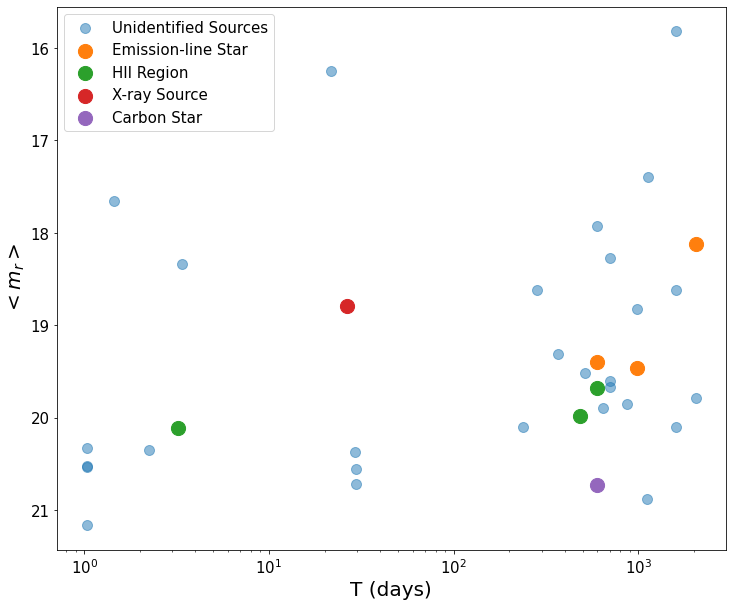

In [133]:
plt.figure(figsize=(12,10))
plt.gca().invert_yaxis()
plt.xlabel('T (days)',fontsize=20)
plt.ylabel('$<m_r>$',fontsize=20)
alpha=1

# all
t_plot=sourcefy(t_zr[t_zr['var']=='P'])
plt.scatter(t_plot['period'],t_plot['mean'],alpha=0.5,s=100,label='Unidentified Sources')

types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

for i,tp in enumerate(types):
    t_plot=sourcefy(t_zr[t_zr['var']=='P'])
    t_plot=t_plot[t_plot['type']==types[i]]
    if len(t_plot)>0:
        plt.scatter(t_plot['period'],t_plot['mean'],s=200,alpha=alpha,label=names[i])

plt.gca().set_xscale("log")
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc=0,fontsize=15)

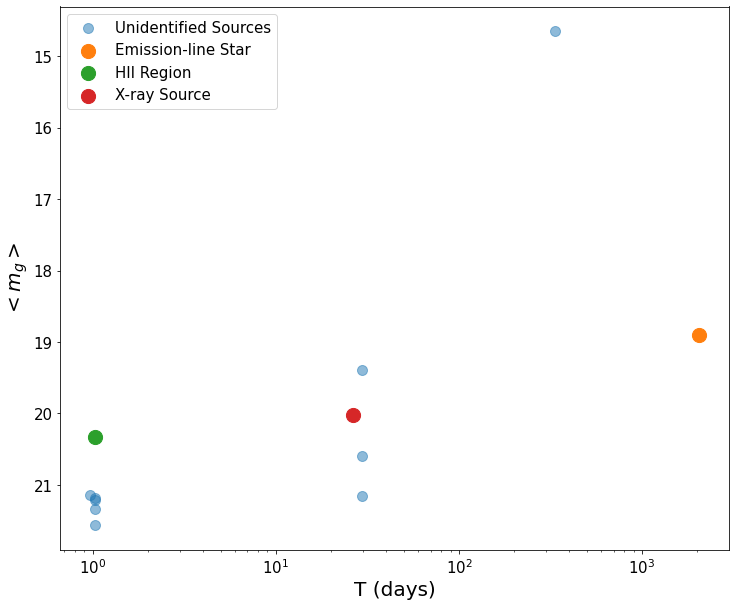

In [131]:
plt.figure(figsize=(12,10))
plt.gca().invert_yaxis()
plt.xlabel('T (days)',fontsize=20)
plt.ylabel('$<m_g>$',fontsize=20)
alpha=1

# all
t_plot=sourcefy(t_zg[t_zg['var']=='P'])
plt.scatter(t_plot['period'],t_plot['mean'],alpha=0.5,s=100,label='Unidentified Sources')

types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

for i,tp in enumerate(types):
    t_plot=sourcefy(t_zg[t_zg['var']=='P'])
    t_plot=t_plot[t_plot['type']==types[i]]
    if len(t_plot)>0:
        plt.scatter(t_plot['period'],t_plot['mean'],s=200,alpha=alpha,label=names[i])

plt.gca().set_xscale("log")
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc=0,fontsize=15)

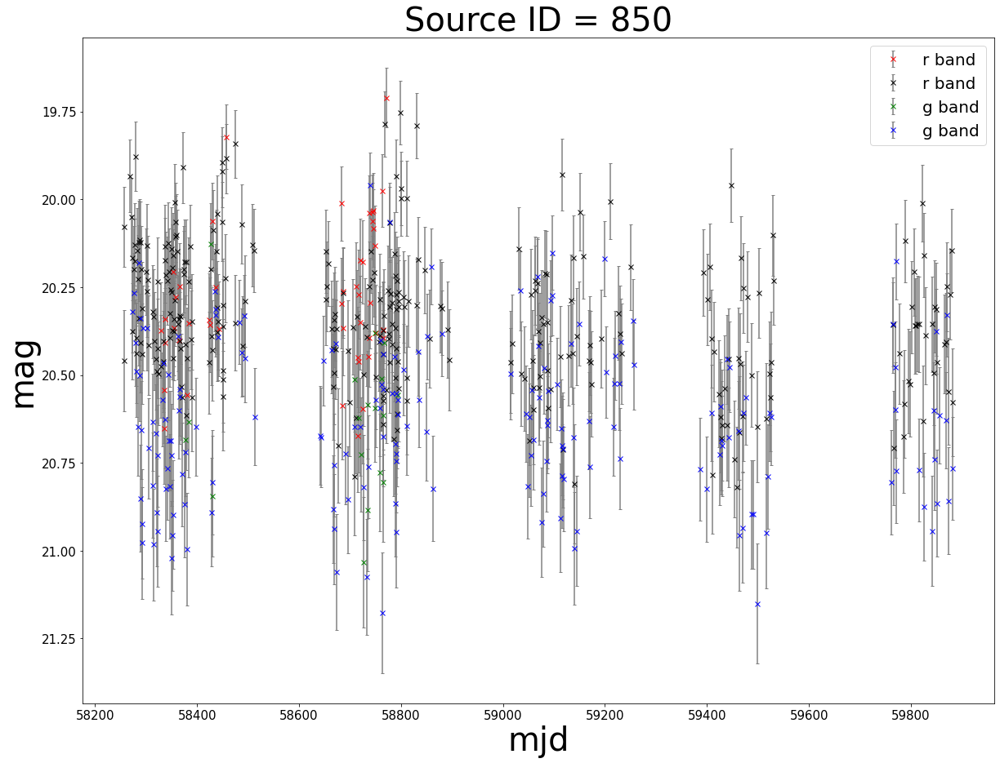

In [ ]:
functions.draw_lightcurve(850)

In [ ]:
nonvar_zg.show_in_notebook()

idx,SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,Gmag,RFG,Plx,e_Plx,var,lc_var,var_flag
0,1,zg,806103100020028,5.0720603,59.3038784,329,211.49850463867188,1.4118503556718038,0.9999878227345453,0.0212542787194252,0.0006416692151478955,0.25123404740327077,1.0000143393856216,0.08873099876504428,0.006259840207567967,16.13667869567871,0.0212542787194252,16.063392639160156,16.19933319091797,-0.003805097658187151,1.1864515542984009,0.9054600016884458,0.05301726371932438,5.566730741302698,1.0,0.002075483273759726,5.543320552037212e-05,0.9856770599932798,g1,NonVar,0.78,1.0,0.033324162097947314,[CHM2007] LDC 31 J002017.33+5918136,0.730211,GinGroup,1,15.114388,1472.66,0.3951,0.1062,N,N,False
1,1,zg,1809111300004956,5.072064,59.3038602,66,181.97731018066406,1.2153497219114564,0.9947901423998002,0.01769244112074375,0.08027810523001934,0.18180043854029107,2800.0,0.24886551433870469,0.09995292626342939,16.114269256591797,0.01769244112074375,16.056095123291016,16.151517868041992,-0.00408253213390708,1.0940680503845215,12.373103033876083,12.079171445342807,20.50892691300846,1.0,0.45998471849500466,0.1868034968413821,0.7395190169301618,g1,NonVar,0.54,1.0,0.03697700363367449,[CHM2007] LDC 31 J002017.33+5918136,0.730211,GinGroup,1,15.114388,1472.66,0.3951,0.1062,N,N,False
2,3,zg,806103100029895,5.0754794,59.3021311,118,21.129486083984375,1.7853441289308996,0.7937969759784527,0.2168530970811844,0.011600849855393502,0.5079098005390992,1.000019931557304,0.1746796840740035,0.26448221931150495,21.077953338623047,0.2168530970811844,20.455461502075195,21.68096923828125,-0.10575921833515167,1.3437035083770752,0.12754322682027128,0.09817467137115843,0.1677678708994578,1.0,0.3041651291630021,0.18458263070405145,0.6366161961902967,g1,DSCT,0.87,1.0,0.08122926572761541,--,nan,--,1,19.72043,317.362,0.4084,0.3136,N,N,False
3,3,zg,1809111300005009,5.0755492,59.302078,14,19.77308464050293,4.5666569504276096,0.005230227707443521,0.3256825804710388,5.6508602799885476e-06,0.11385187765715038,2800.0,0.9632756435098193,0.4235796045668075,21.05537986755371,0.3256825804710388,20.234277725219727,21.53025245666504,-0.26540300250053406,2.124340534210205,0.08696201268456535,0.13893642648643686,0.0816927137169245,1.0,0.9391482044342736,0.9883857989127823,0.4682019002910667,gu,DSCT,0.62,1.0,0.0536846448091803,--,nan,--,1,19.72043,317.362,0.4084,0.3136,N,N,False
4,6,zg,1809111300028615,5.0727384,59.3069587,26,13.472513198852539,1.5870983927770066,0.7552330076006265,0.2043532431125641,0.009534268564508175,0.4097377881529461,2800.0,0.599879241217029,0.07703826374201068,20.795644760131836,0.2043532431125641,20.40668487548828,21.212738037109375,-0.10797520726919174,1.249980092048645,0.5195975214996531,0.6065540854006857,0.6120893982833999,0.0,0.6156664699007843,0.47171095364147897,0.5827866861035995,g1,DSCT,0.78,1.0,0.04552884792836488,LGGS J002017.47+591825.1,0.126465,Em*,1,20.539137,131.705,1.1997,0.8904,N,N,False
5,6,zg,806103100019942,5.0725765,59.3069858,171,24.435733795166016,2.2861591979112488,0.09551914095449333,0.21842004358768463,3.505672515796039e-05,29.486822867136123,1.0000110121384305,0.18774176429101444,0.2066712203842268,20.869640350341797,0.21842004358768463,20.229215621948242,21.372922897338867,-0.13341067731380463,1.5270146131515503,0.0161542399896468,0.003939118013235387,0.05124627349139941,1.0,0.034666407759487594,0.0035640095830332674,0.9246583020156751,g1,DSCT,0.84,1.0,0.07404254135075186,LGGS J002017.47+591825.1,0.126465,Em*,1,20.539137,131.705,1.1997,0.8904,N,N,False
6,11,zg,1809111300028676,5.0788071,59.3024032,16,12.191608428955078,1.3718184126814634,0.8012016805516761,0.19153562188148499,0.00284932513621239,0.10550109894765718,2800.0,0.8230080936840749,0.15519810302534032,20.869380950927734,0.191535621

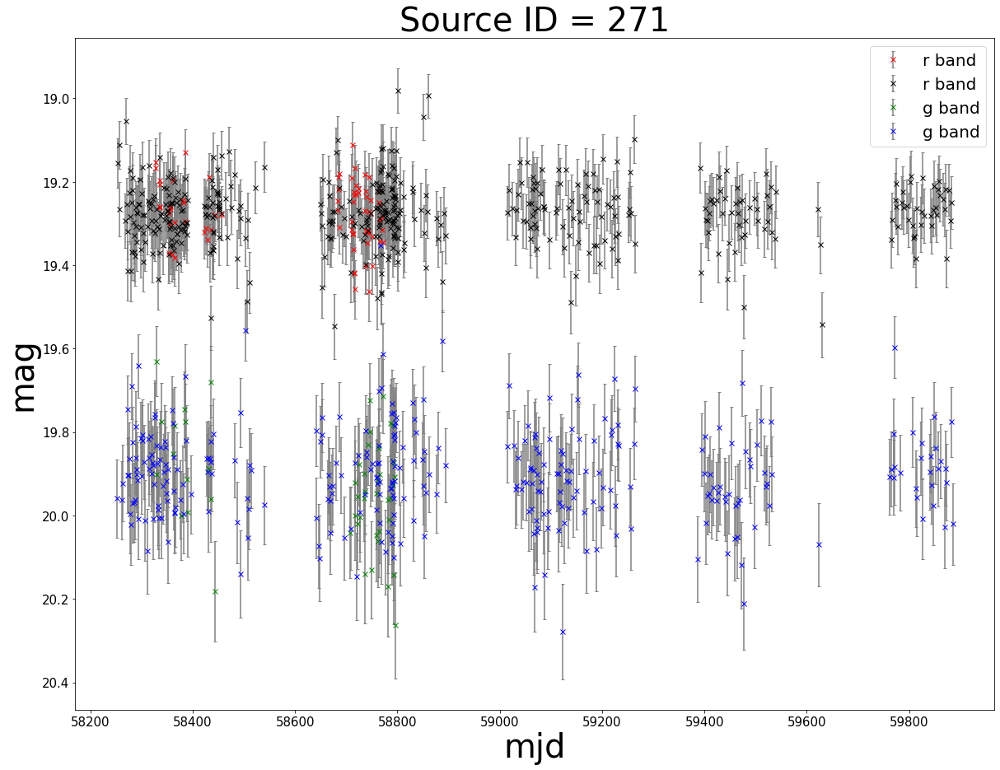

In [ ]:
functions.draw_lightcurve(271)

In [57]:
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(nonvar_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
(t_plot['max_mag_r']-t_plot['min_mag_r']).mean(),t_plot['std_mag_r'].mean(),(t_plot['max_color']-t_plot['min_color']).mean(),t_plot['std_color'].mean()

(0.6515783349006979,
 0.09280090238135898,
 0.85529022998206,
 0.16285737108052198)

In [58]:
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(unobj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
(t_plot['max_mag_r']-t_plot['min_mag_r']).mean(),t_plot['std_mag_r'].mean(),(t_plot['max_color']-t_plot['min_color']).mean(),t_plot['std_color'].mean()

(0.9917642251769109,
 0.1324811823554893,
 0.9800823410945152,
 0.17676713878143963)

In [85]:
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(obj_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
(t_plot['max_mag_r']-t_plot['min_mag_r']).mean(),t_plot['std_mag_r'].mean(),(t_plot['max_color']-t_plot['min_color']).mean(),t_plot['std_color'].mean()

(0.8231624715468463,
 0.14320298218551805,
 0.872194907244514,
 0.14953242920755871)

In [86]:
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(nonvar_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
(t_plot['max_mag_g']-t_plot['min_mag_g']).mean(),t_plot['std_mag_g'].mean(),(t_plot['max_color']-t_plot['min_color']).mean(),t_plot['std_color'].mean()

(0.8724028830434761,
 0.15339604266645276,
 0.8399347723486589,
 0.1590534652194787)

In [87]:
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(unobj_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
(t_plot['max_mag_g']-t_plot['min_mag_g']).mean(),t_plot['std_mag_g'].mean(),(t_plot['max_color']-t_plot['min_color']).mean(),t_plot['std_color'].mean()

(1.3603428602218628,
 0.2212114940242221,
 1.0870066086451213,
 0.20673889844963023)

In [88]:
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(obj_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
(t_plot['max_mag_g']-t_plot['min_mag_g']).mean(),t_plot['std_mag_g'].mean(),(t_plot['max_color']-t_plot['min_color']).mean(),t_plot['std_color'].mean()

(1.5534524122873943,
 0.256472450060149,
 1.3669966061909993,
 0.22394972928462367)

In [26]:
t_zr=QTable.read('t_zr_20240401.ecsv')
t_zg=QTable.read('t_zg_20240401.ecsv')
t_zr=t_zr[np.isnan(t_zr['LNP_SIG'])==False]
t_zg=t_zg[np.isnan(t_zg['LNP_SIG'])==False]

In [27]:
upsilon_zr=t_zr[t_zr['upsilon_class']!='NonVar']
upsilon_zg=t_zg[t_zg['upsilon_class']!='NonVar']
upsilon_zr=upsilon_zr[upsilon_zr['upsilon_flag']==0]
upsilon_zg=upsilon_zg[upsilon_zg['upsilon_flag']==0]

In [28]:
len(np.unique(upsilon_zr['SourceID'])),len(np.unique(upsilon_zg['SourceID'])),len(np.unique(upsilon_zr[np.isin(upsilon_zr['SourceID'],upsilon_zg['SourceID'])==1]['SourceID']))

(35, 15, 4)

In [29]:
len(np.intersect1d(np.unique(obj_zr['SourceID']),np.unique(upsilon_zr['SourceID'])))

23

In [30]:
len(np.intersect1d(np.unique(obj_zg['SourceID']),np.unique(upsilon_zg['SourceID'])))

3

In [31]:
len(np.intersect1d(np.unique(unobj_zr['SourceID']),np.unique(upsilon_zr['SourceID'])))

3

In [32]:
len(np.intersect1d(np.unique(nonvar_zr['SourceID']),np.unique(upsilon_zr['SourceID'])))

9

In [33]:
len(np.intersect1d(np.unique(unobj_zg['SourceID']),np.unique(upsilon_zg['SourceID'])))

1

In [34]:
len(np.intersect1d(np.unique(nonvar_zg['SourceID']),np.unique(upsilon_zg['SourceID'])))

11

In [35]:
np.intersect1d(np.unique(obj_zr['SourceID']),np.unique(obj_zg['SourceID']))

array([77, 90])

In [44]:
np.intersect1d(np.unique(obj_zr['SourceID']),np.unique(upsilon_zr['SourceID']))

array([  52,   77,   90,  158,  168,  208,  210,  223,  225,  242,  265,
        354,  530,  577,  733,  778, 1169, 1259, 1299, 1555, 1706, 1744,
       2008])

In [45]:
t_zr.columns

<TableColumns names=('SourceID','filter','OID','RA','DEC','numobs','DELTA_SIG_MAG','CONST_CHI2','sf','rmse','LNP_SIG','period','period_c','power','power_c','mean','std','min','max','sigma_mean','sigma_std','gaussian1_err','gaussian2_err','gumbel_err','g2_flag','Pg1g2','Pgug2','Pg1gu','shape','upsilon_class','upsilon_prob','upsilon_flag','upsilon_period','identifier','dist','type','Gaia_count','multiflag','GaiaDist','fluxratio','Gmag','RFG','Plx','e_Plx','Plxflag','XMM','XMM_dist','Chandra','Chandra_dist','var','lc_var','var_flag')>

In [46]:
t_zr['mean_mag_err']=np.sqrt(t_zr['std']**2/t_zr['CONST_CHI2'])
t_zg['mean_mag_err']=np.sqrt(t_zg['std']**2/t_zg['CONST_CHI2'])

In [47]:
# bin t according to t['mean'], and calculate the mean of t['mean_mag_err'] in each bin
mean_bin_zr = np.trunc(t_zr['mean']/(t_zr['mean'].max()-t_zr['mean'].min())*10)
mean_bin_zg = np.trunc(t_zg['mean']/(t_zg['mean'].max()-t_zg['mean'].min())*10)

err_mag_zr = t_zr.group_by(mean_bin_zr)
err_mag_zg = t_zg.group_by(mean_bin_zg)

In [48]:
zr_binned=err_mag_zr[['mean','mean_mag_err']].groups.aggregate(np.mean)
zg_binned=err_mag_zg[['mean','mean_mag_err']].groups.aggregate(np.mean)

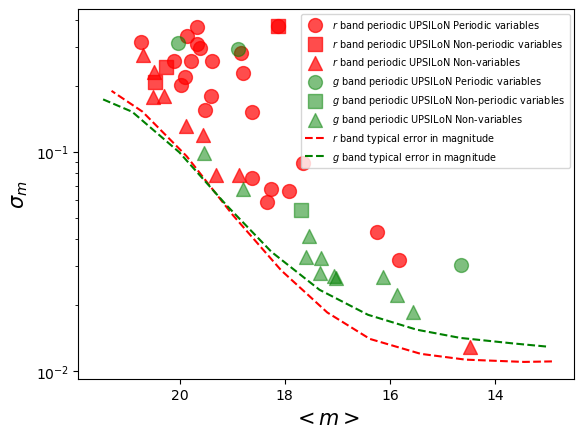

In [56]:
# Can you plot mean m (x-axis) and std m (y-axis) for UPSILoN periodic sources: red for zr data, green for zg data: filled star if also periodic variable in this work, filled square if non-periodic variable, open circle if non-variable?
class_dic={'P':0,'V':1,'N':2}
t=sourcefy(upsilon_zr)
t['class']=[class_dic[i] for i in t['var']]
plt.scatter(t[t['class']==0]['mean'],t[t['class']==0]['std'],label=r'$r$ band periodic UPSILoN Periodic variables',alpha=0.7,s=100,marker='o',color='red')
plt.scatter(t[t['class']==1]['mean'],t[t['class']==1]['std'],label=r'$r$ band periodic UPSILoN Non-periodic variables',alpha=0.7,s=100,marker='s',color='red')
plt.scatter(t[t['class']==2]['mean'],t[t['class']==2]['std'],label=r'$r$ band periodic UPSILoN Non-variables',alpha=0.7,s=100,marker='^',color='red')

t=sourcefy(upsilon_zg)
t['class']=[class_dic[i] for i in t['var']]
plt.scatter(t[t['class']==0]['mean'],t[t['class']==0]['std'],label=r'$g$ band periodic UPSILoN Periodic variables',alpha=0.5,s=100,marker='o',color='green')
plt.scatter(t[t['class']==1]['mean'],t[t['class']==1]['std'],label=r'$g$ band periodic UPSILoN Non-periodic variables',alpha=0.5,s=100,marker='s',color='green')
plt.scatter(t[t['class']==2]['mean'],t[t['class']==2]['std'],label=r'$g$ band periodic UPSILoN Non-variables',alpha=0.5,s=100,marker='^',color='green')

plt.plot(zr_binned['mean'],zr_binned['mean_mag_err'],label=r'$r$ band typical error in magnitude',color='red',linestyle='--')
plt.plot(zg_binned['mean'],zg_binned['mean_mag_err'],label=r'$g$ band typical error in magnitude',color='green',linestyle='--')

plt.xlabel(r'$<m>$',fontsize=15)
plt.ylabel(r'$\sigma_m$',fontsize=15)
plt.gca().invert_xaxis()
plt.yscale('log')
plt.legend(loc=0,fontsize=7)

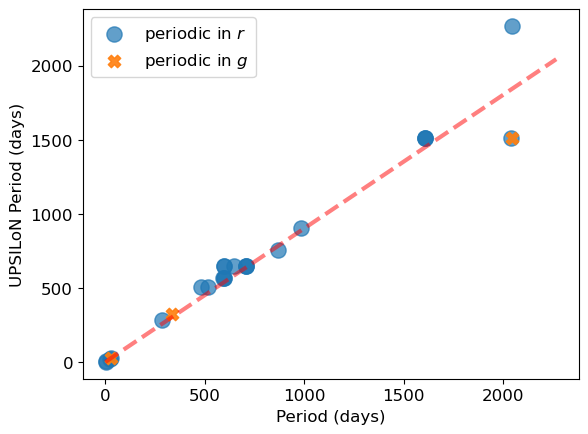

In [37]:
fs=12
ind=np.intersect1d(np.unique(obj_zr['SourceID']),np.unique(upsilon_zr['SourceID']))
t=sourcefy(t_zr)
t=t[np.isin(t['SourceID'],ind)]
plt.plot(np.linspace(0,t['upsilon_period'].max(),10),np.linspace(0,t['period'].max(),10),ls='--',c='r',alpha=0.5,lw=fs/4)
plt.scatter(t['period'],t['upsilon_period'],s=120,alpha=0.7,label='periodic in $r$')


ind=np.intersect1d(np.unique(obj_zg['SourceID']),np.unique(upsilon_zg['SourceID']))
t=sourcefy(t_zg)
t=t[np.isin(t['SourceID'],ind)]
plt.scatter(t['period'],t['upsilon_period'],s=80,marker='X',alpha=0.9,label='periodic in $g$')


plt.xlabel('Period (days)',fontsize=fs)
plt.ylabel('UPSILoN Period (days)',fontsize=fs)
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)

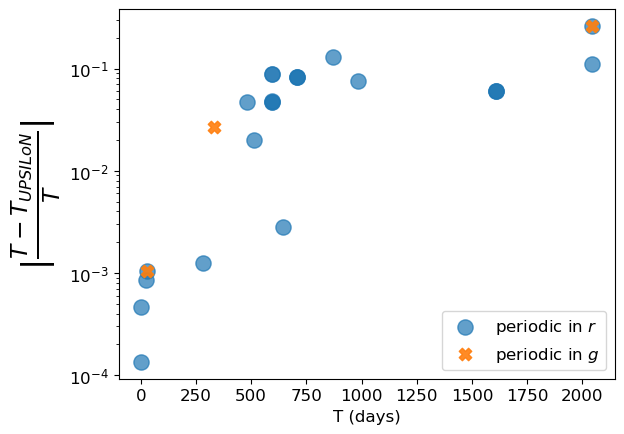

In [38]:
fs=12
ind=np.intersect1d(np.unique(obj_zr['SourceID']),np.unique(upsilon_zr['SourceID']))
t=sourcefy(t_zr)
t=t[np.isin(t['SourceID'],ind)]
#plt.plot(np.linspace(0,t['upsilon_period'].max(),10),np.zeros(10),ls='--',c='r',alpha=0.5,lw=fs/4)
plt.scatter(t['period'],np.abs((t['upsilon_period']-t['period'])/t['period']),s=120,alpha=0.7,label='periodic in $r$')


ind=np.intersect1d(np.unique(obj_zg['SourceID']),np.unique(upsilon_zg['SourceID']))
t=sourcefy(t_zg)
t=t[np.isin(t['SourceID'],ind)]
plt.scatter(t['period'],np.abs((t['upsilon_period']-t['period'])/t['period']),s=80,marker='X',alpha=0.9,label='periodic in $g$')


plt.xlabel('T (days)',fontsize=fs)
plt.ylabel(r'$|\frac{T-T_{UPSILoN}}{T}|$',fontsize=fs*2)
plt.gca().set_yscale("log")
plt.xticks(fontsize=fs)
plt.yticks(fontsize=fs)
plt.legend(fontsize=fs)

In [ ]:
upsilon_zr

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool
50,zr,806203100056992,5.0847793,59.305823,438,26.07579231262207,2.6107927423368156,0.000806971208849762,0.23083563148975372,3.463105648531134e-12,223.91194916677907,0.997343815080248,0.24246865168903964,0.06281874602726414,20.486726760864258,0.23083563148975372,19.869138717651367,21.093555450439453,-0.20032791793346405,1.6513630151748657,0.020899946420963187,0.010016017577819572,0.02540505403358542,0.0,0.12703363363379405,0.08768528986628421,0.5983224576127097,g1,LPV_SRV_AGB_O,0.86,0.0,226.33803819000025,--,nan,--,1,0,0.233399,0.0,19.826973,225.794,0.169,0.3967,0,0,nan,0,nan,N,N,False
52,zr,806203100023276,5.0806496,59.3093092,664,48.39557647705078,9.548270702053268,1.3227187319910005e-189,0.3108588755130768,1.7018337280194596e-78,595.2450708466688,0.997336033066433,0.6229683753591274,0.21949631231274336,19.675853729248047,0.3108588755130768,19.17412567138672,20.918895721435547,-0.7161276936531067,3.285275936126709,0.05060821258505381,0.007833020026423389,0.026125014733712922,0.0,0.014227170500624942,0.0517871312497491,0.20132354399945207,g2,LPV_OSARG_AGB,0.33,0.0,566.9630815875007,[HL90] 61,1.854526,HII,1,0,0.089935,0.0,18.839401,159.932,0.351,0.184,1,0,nan,0,nan,P,P,False
77,zr,806203100063307,5.0870906,59.2998095,836,344.7351989746094,40.842491010031104,0.0,0.22717958688735962,7.488112388238467e-24,26.55255504914417,0.997336033066433,0.25554257162342087,0.0034232661997002983,18.791976928710938,0.22717958688735962,17.675485610961914,19.1998348236084,-0.8078729510307312,6.599571704864502,0.010941253454579771,0.0022451831278411214,0.04598158685382897,1.0,0.024749755228021697,0.001446042828369909,0.961198797591372,g1,CEPH_Other,0.44,0.0,26.524588612280738,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,0,nan,1,0.366956,P,P,False
90,zr,1809211300042387,5.083505,59.3114538,76,335.14105224609375,55.45322806162426,0.0,0.2555650770664215,2.0784866526889912e-39,2800.0,2800.0,0.9309604412577608,0.9992448196539399,18.229490280151367,0.2555650770664215,17.943700790405273,18.82109832763672,-1.287727952003479,7.673773765563965,0.5555584658587479,0.04627441335937462,0.5534192405367697,0.0,0.004179634055204828,0.004211741656930057,0.49803513609818195,g2,LPV_Mira_AGB_C,0.31,0.0,1328.6934374999983,LGGS J002020.03+591841.2,0.205743,Em*,2,1,0.362068,1.4305001097746064,19.434788,102.102,-0.3582,0.2602,0,0,nan,0,nan,P,V,False
90,zr,806203100056957,5.0836327,59.3114535,846,567.4482421875,120.79296419281002,0.0,0.3739984333515167,3.247011689208663e-280,2043.207284960579,0.997336033066433,0.9506730073393318,0.47493011002121566,18.124500274658203,0.3739984333515167,17.195171356201172,18.949966430664062,-2.5609970092773438,11.737095832824707,0.18947997991941207,0.020160519579386485,0.15060952910358819,0.0,0.006788985925998747,0.01068657840378251,0.38484022277800156,g2,LPV_Mira_AGB_C,0.26,0.0,2267.852326350003,LGGS J002020.03+591841.2,0.205743,Em*,2,1,0.362068,1.4305001097746064,19.434788,102.102,-0.3582,0.2602,0,0,nan,0,nan,P,P,False
107,zr,806203100065432,5.0537228,59.2994666,354,22.948423385620117,2.8663962274228902,5.649783470328897e-05,0.27633973956108093,1.9831985249099693e-22,475.6919759026841,0.9973157097647236,0.4455083958492

In [ ]:
obj_zr.show_in_notebook()

idx,SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
0,52,zr,1809211300054348,5.0806374,59.3092921,70,54.861793518066406,3.8287349694500223,7.479393901880701e-06,0.1666656732559204,1.9070708062533334e-05,462.22886833491833,2800.0,0.4143551402254435,0.8929084671484715,19.547266006469727,0.1666656732559204,19.179689407348633,20.374217987060547,-0.2487855702638626,1.9824135303497314,0.023752797415915242,0.03586219985223847,0.04073117478282561,1.0,0.8833477322406814,0.38542511478098085,0.7531769233421609,g1,LPV_SRV_AGB_O,0.56,1.0,221.44868054999824,[HL90] 61,1.854526,HII,1,0,0.089935,0.0,18.839401,159.932,0.351,0.184,1,0,nan,0,nan,P,N,False
1,52,zr,806203100023276,5.0806496,59.3093092,664,48.39557647705078,9.548270702053268,1.3227187319910005e-189,0.3108588755130768,1.7018337280194596e-78,595.2450708466688,0.997336033066433,0.6229683753591274,0.21949631231274336,19.675853729248047,0.3108588755130768,19.17412567138672,20.918895721435547,-0.7161276936531067,3.285275936126709,0.05060821258505381,0.007833020026423389,0.026125014733712922,0.0,0.014227170500624942,0.0517871312497491,0.20132354399945207,g2,LPV_OSARG_AGB,0.33,0.0,566.9630815875007,[HL90] 61,1.854526,HII,1,0,0.089935,0.0,18.839401,159.932,0.351,0.184,1,0,nan,0,nan,P,P,False
2,77,zr,806203100063307,5.0870906,59.2998095,836,344.7351989746094,40.842491010031104,0.0,0.22717958688735962,7.488112388238467e-24,26.55255504914417,0.997336033066433,0.25554257162342087,0.0034232661997002983,18.791976928710938,0.22717958688735962,17.675485610961914,19.1998348236084,-0.8078729510307312,6.599571704864502,0.010941253454579771,0.0022451831278411214,0.04598158685382897,1.0,0.024749755228021697,0.001446042828369909,0.961198797591372,g1,CEPH_Other,0.44,0.0,26.524588612280738,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,0,nan,1,0.366956,P,P,False
3,77,zr,1809211300074746,5.0870934,59.2997909,75,339.8369140625,80.43303571096826,0.0,0.26337021589279175,1.3349568059073803e-11,0.5081678123002179,2800.0,0.5958935079344113,0.34858179928581884,18.844051361083984,0.26337021589279175,17.768030166625977,19.322647094726562,-1.2469897270202637,9.363984107971191,0.060816512321346654,0.020122908699598416,0.08327234162645296,1.0,0.06264230945395721,0.03406160489283805,0.6555665316467969,g1,EB_ED,0.38,1.0,26.573868749999964,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,0,nan,1,0.366956,P,V,False
4,90,zr,1809211300042387,5.083505,59.3114538,76,335.14105224609375,55.45322806162426,0.0,0.2555650770664215,2.0784866526889912e-39,2800.0,2800.0,0.9309604412577608,0.9992448196539399,18.229490280151367,0.2555650770664215,17.943700790405273,18.82109832763672,-1.287727952003479,7.673773765563965,0.5555584658587479,0.04627441335937462,0.5534192405367697,0.0,0.004179634055204828,0.004211741656930057,0.49803513609818195,g2,LPV_Mira_AGB_C,0.31,0.0,1328.6934374999983,LGGS J002020.03+591841.2,0.205743,Em*,2,1,0.362068,1.4305001097746064,19.434788,102.102,-0.3582,0.2602,0,0,nan,0,nan,P,V,False
5,90,zr,806203100056957,5.0836327,59.3114535,846,567.4482421875,120.79296419281002,0.0,0.3739984333515167,3.247011689208663e-280,2043.207284960579,0.997336033066433,0.9506730073393318,0.47493011002121566,18.124500274658203,0.3739984333515167,17.195171356201172,18.949966430664062,-2.5609970092773438,11.737095832824707,0.18947997991941207,0.020160519579386485,0.15060952910358819,0.0,0.006788985925998747,0.01068657840378251,0.38484022277800156,g2,LPV_Mira_AGB_C,0.26,0.0,2267.852326350003,LGGS J002020.03+591841.2,0.205743,Em*,2,1,0.362068,1.4305001097746064,19.434788,102.102,-0.3582,0.2602,0,0,

In [ ]:
functions.query(145)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool
145,zr,806203100043772,5.0957151,59.2994528,717,66.61664581298828,3.5379984089296954,2.2753838245357322e-18,0.14171883463859558,1.0515294240953812e-12,981.7766691905116,0.997336033066433,0.17591322363193937,0.09890003454859338,19.4619083404541,0.14171883463859558,18.99640655517578,20.149547576904297,-0.18844391405582428,1.9061943292617798,0.014671911593230497,0.003428865224048767,0.0160385433525674,0.0,0.03191100590870233,0.026816135608569547,0.5452531399277134,g2,NonVar,0.35,0.0,1133.9261631750014,LGGS J002022.99+591757.8,0.329861,Em*,1,0,0.328369,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,P,P,False
145,zr,1809211300042604,5.095706,59.2993843,70,49.061622619628906,3.04362781022782,0.0034006701634084267,0.12611249089241028,4.3440289466632065e-08,0.5005857784631169,2800.0,0.5151418768924364,0.4038407234398711,19.473413467407227,0.12611249089241028,19.224807739257812,19.792285919189453,-0.1626230925321579,1.7541042566299438,0.28131470084599547,0.24014997862142634,0.22691212939950534,0.0,0.3652222781345995,0.5261213778525741,0.39200176752438864,gu,RRL_c,0.69,1.0,0.3332561031602737,LGGS J002022.99+591757.8,0.329861,Em*,1,0,0.328369,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,P,N,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool
145,zg,1809111300037359,5.0955739,59.2994134,27,12.475582122802734,1.3594864375813056,0.887333395810309,0.18075062334537506,0.3823820206418178,0.10313280357686568,2800.0,0.4111718683499969,0.12895766339242193,20.607967376708984,0.18075062334537506,20.317750930786133,20.94916343688965,-0.0995478704571724,1.156970500946045,0.21410086967507921,0.3035168272701912,0.20978881332210736,0.0,0.8166576619351427,0.838430241716654,0.4896391774418156,gu,NonVar,0.36,1.0,0.030445886366578186,LGGS J002022.99+591757.8,0.335403,Em*,1,0,0.360385,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,N,N,False
145,zg,806103100029929,5.0955994,59.2993467,167,28.604887008666992,1.841649684812824,0.7615938253505716,0.17869067192077637,0.0008445053205045829,0.1915878715242689,1.0000143393856216,0.15879330850693638,0.01132239859652,20.637638092041016,0.17869067192077637,20.012495040893555,21.093690872192383,-0.11102097481489182,1.367995262145996,0.009580666023678774,0.0018563271605288873,0.05851629500128366,1.0,0.022118185787693756,0.0006124058580260217,0.9854163893214144,g1,DSCT,0.89,1.0,0.1915815593765839,LGGS J002022.99+591757.8,0.335403,Em*,1,0,0.360385,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,N,N,False


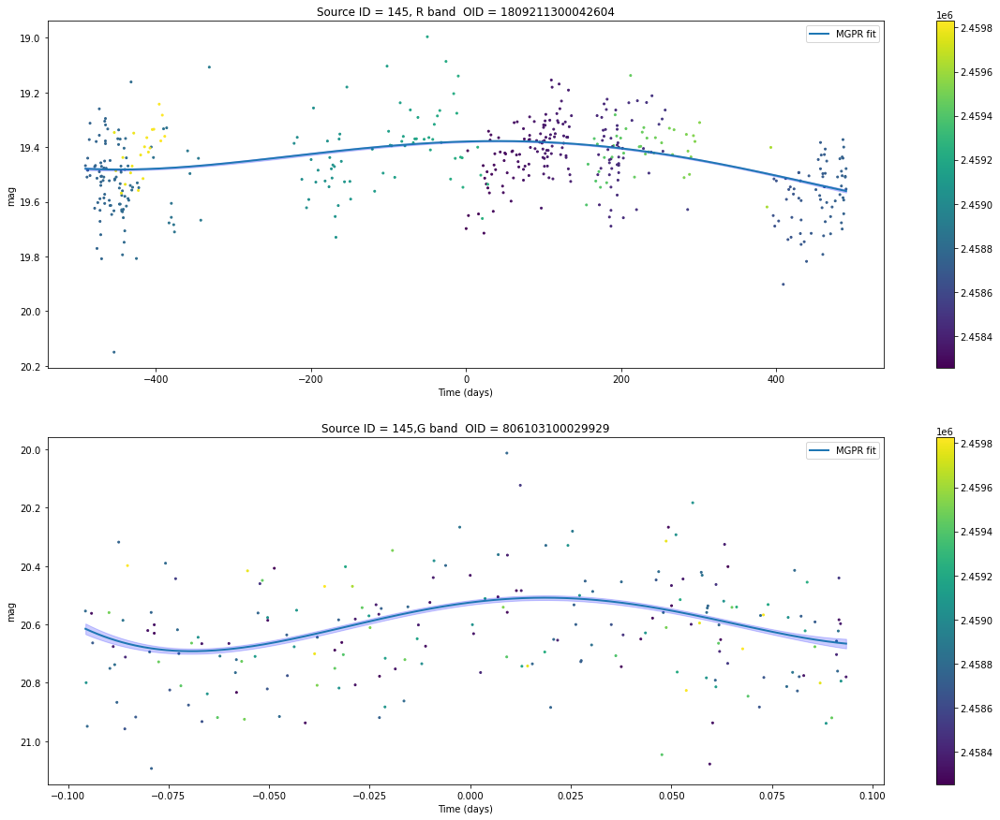

In [ ]:
functions.MGPRfit(145,errscale=0.5)

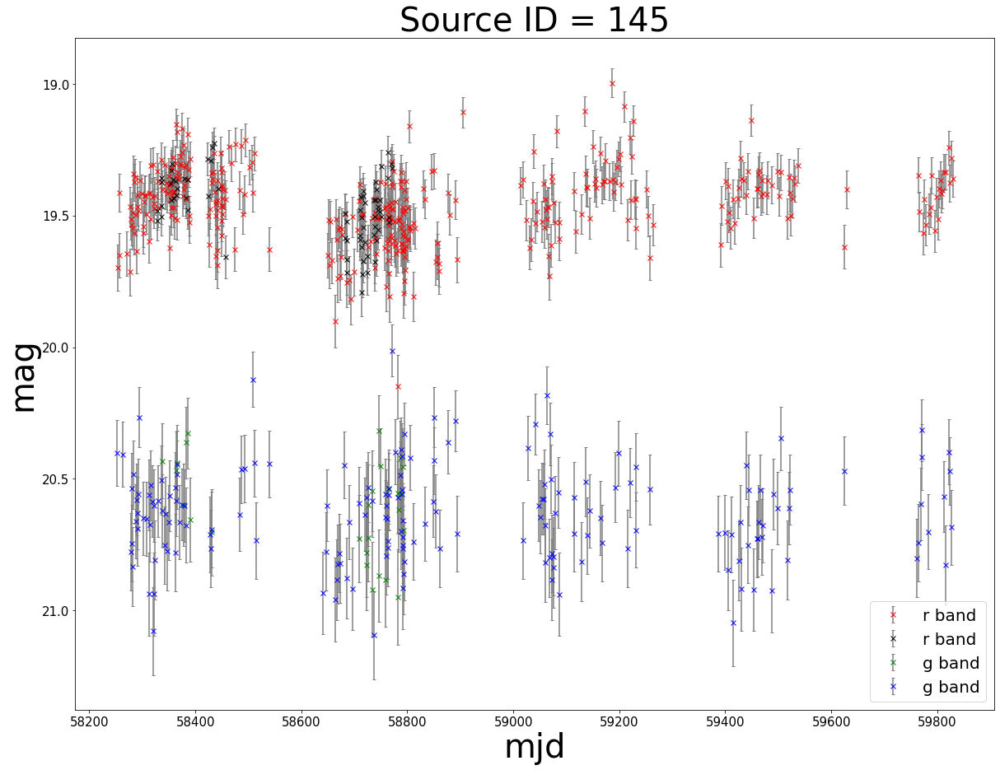

In [ ]:
functions.draw_lightcurve(145)

In [ ]:
functions.query(439)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool
439,zr,1809211300042148,5.0742247,59.3260104,68,24.0855770111084,1.4642729439121258,0.9511868759873303,0.11887487769126892,0.0004600938675696531,1.3914628119637142,2800.0,0.3612868249358036,0.011717249119181596,19.920970916748047,0.11887487769126892,19.683393478393555,20.19719696044922,-0.10407295823097229,1.2145365476608276,0.3015237875436522,0.2939809865129014,0.44909048586525974,0.0,0.45898348422516155,0.22692124166173633,0.6939116401576699,g1,CEPH_F,0.31,1.0,1.3909859943336642,--,nan,--,1,0,0.107553,0.0,19.61618,205.613,0.463,0.3023,1,0,nan,0,nan,P,N,False
439,zr,806203100043284,5.0741825,59.3260349,662,42.31599426269531,3.4373748469641683,8.763464508600559e-17,0.2168726772069931,6.84641750548418e-23,238.04133729120863,0.997343815080248,0.270724498758034,0.0669710949966615,20.104284286499023,0.2168726772069931,19.3428955078125,20.985332489013672,-0.26043152809143066,1.9058979749679565,0.008169558383902745,0.0012830310537330653,0.009699418886023034,0.0,0.014641262838516855,0.010439056165814531,0.5866762443357652,g2,EB_ED,0.62,1.0,1.0006102484084891,--,nan,--,1,0,0.107553,0.0,19.61618,205.613,0.463,0.3023,1,0,nan,0,nan,P,P,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool


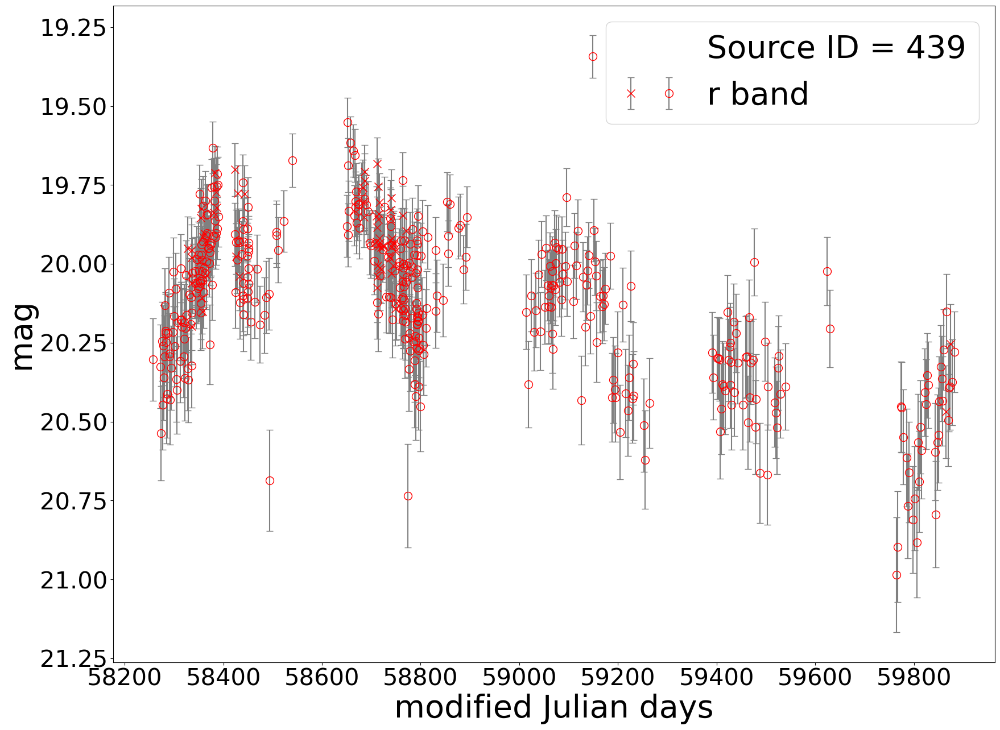

In [9]:
functions.draw_lightcurve(439)

L-S_period: 238.04133729120863
fit_period: 251.28669898018816 ± 34.90557604830728
sin_chi2: 3.80605057


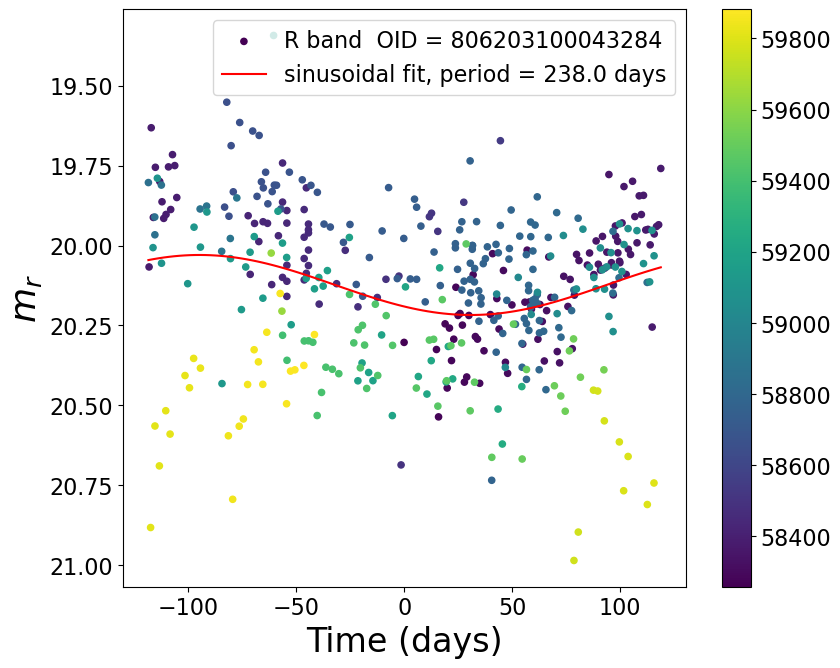

In [17]:
functions.sinfit_single(439)

In [ ]:
functions.query(2813)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64
2813,zr,806203400051460,5.1056321,59.2459608,214,305.3210144042969,390.70754678491767,0.0,0.565703272819519,9.130724410339825e-12,368.4535100727675,1.0000014120485934,0.5216930985418803,0.4869248467327726,19.309696197509766,0.565703272819519,16.342483520507812,20.012256622314453,-4.518640041351318,23.71954917907715,0.018434855263553113,0.032260996341697934,0.019288172808330752,0.0,0.9999999999969353,0.9773542999047296,0.523031331679768,g1,NonVar,0.38,1.0,1909.2845833499996


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64


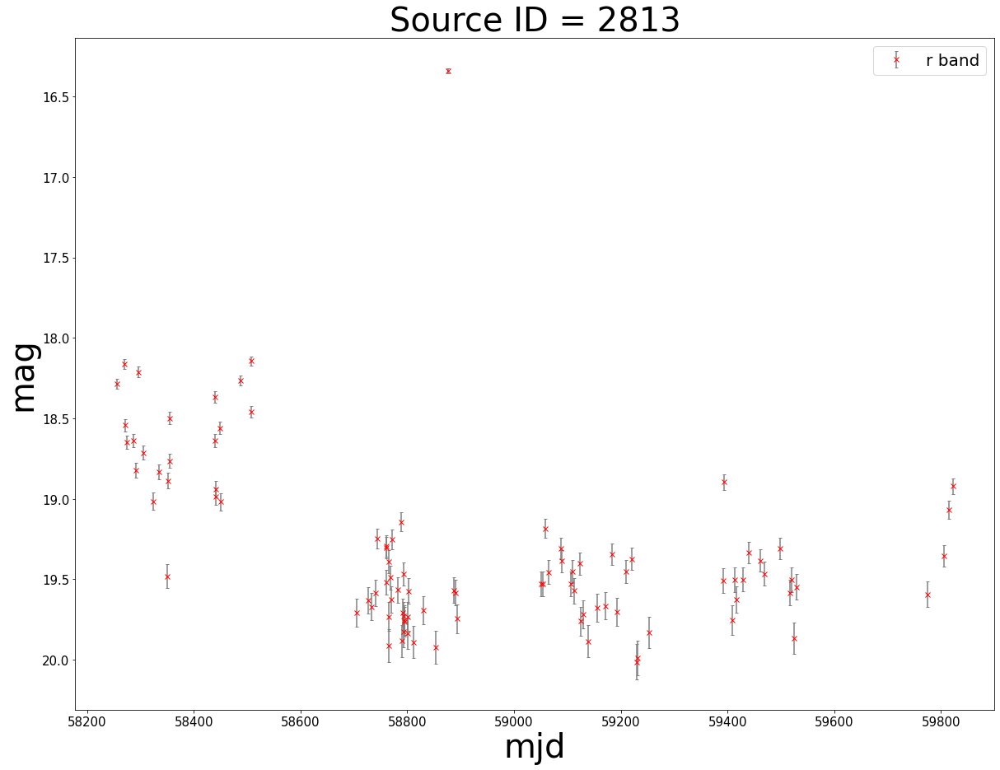

In [ ]:
functions.draw_lightcurve(2813)

L-S_period: 368.4535100727675
fit_period: 371.32959488030764
sin_chi2: 439.89170967


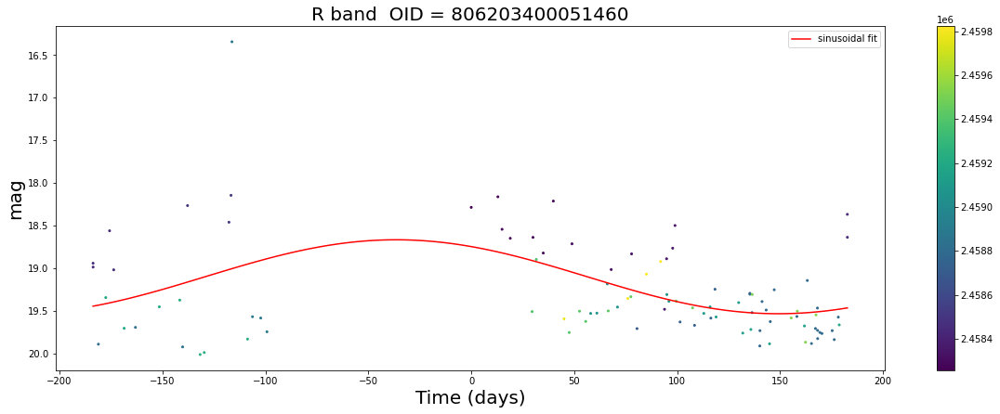

In [ ]:
functions.sinfit(2813)

In [ ]:
functions.query(50)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64
50,zr,806203100056992,5.0847793,59.305823,438,26.07579231262207,2.6107927423368156,0.000806971208849762,0.23083563148975372,3.463105648531134e-12,223.91194916677907,0.997343815080248,0.24246865168903964,0.06281874602726414,20.486726760864258,0.23083563148975372,19.869138717651367,21.093555450439453,-0.20032791793346405,1.6513630151748657,0.020899946420963187,0.010016017577819572,0.02540505403358542,0.0,0.12703363363379405,0.08768528986628421,0.5983224576127097,g1,LPV_SRV_AGB_O,0.86,0.0,226.33803819000025
50,zr,1809211300070206,5.0848415,59.3057772,46,22.17166519165039,2.217825294097687,0.2847788502030217,0.21391645073890686,6.0221749546566455e-05,0.5083811140507174,2800.0,0.5296320007600701,0.15438356554563615,20.468717575073242,0.21391645073890686,20.032848358154297,21.13528823852539,-0.18498404324054718,1.5076112747192383,0.17223729353562936,0.12687535031422165,0.24294313257932024,0.0,0.2811236022375865,0.1493102749960884,0.669329676063277,g1,LPV_Mira_AGB_C,0.38,1.0,652.2697222499955


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64


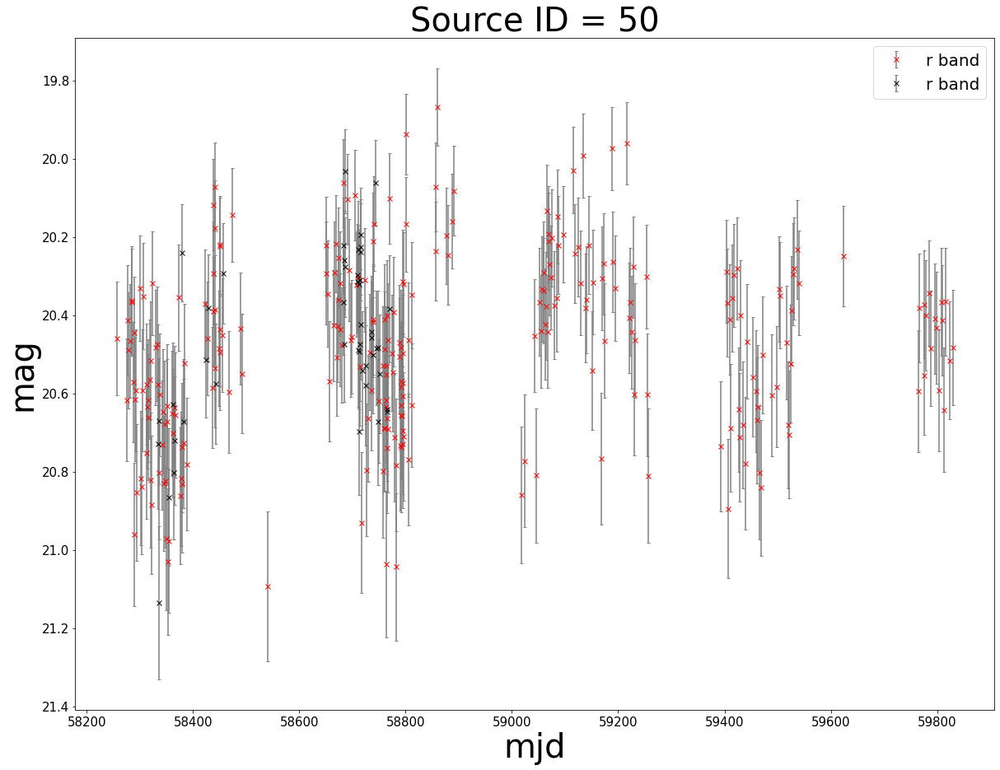

In [ ]:
functions.draw_lightcurve(50)

No data found in G band


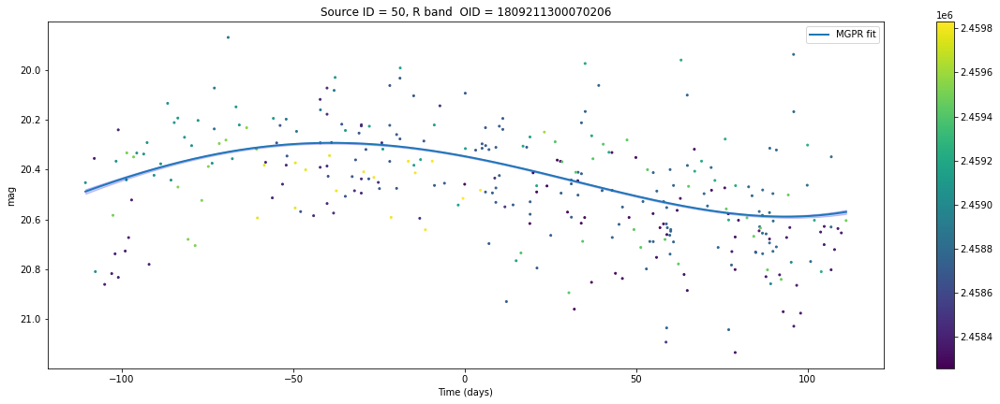

In [ ]:
functions.MGPRfit(50,errscale=0.25)

L-S_period: 223.91194916677907
fit_period: 242.9900373526693
sin_chi2: 2.02224829


ValueError: attempt to get argmax of an empty sequence

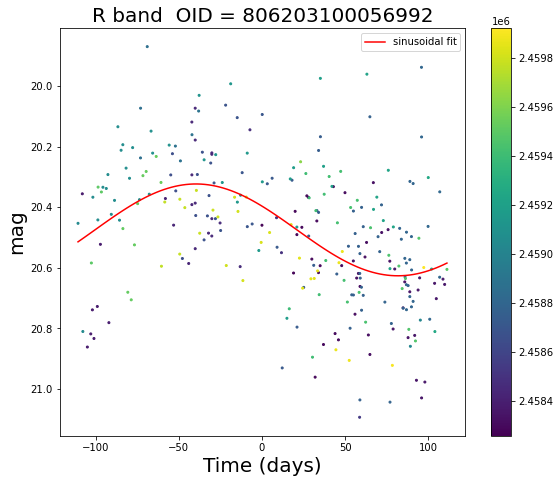

In [ ]:
functions.sinfit_single(50)

In [ ]:
functions.query(1299)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool
1299,zr,806203100023129,5.1539289,59.3135314,854,197.82797241210938,2.7845959916233016,8.530009142395865e-08,0.05892377719283104,2.8366516059465913e-31,3.4010475333652077,0.997336033066433,0.3032918259204402,0.01030609793810549,18.332311630249023,0.05892377719283104,18.088233947753906,18.604610443115234,-0.06086678430438042,1.6700814962387085,0.21225719823248787,0.011460107658360516,0.4472967585450967,0.0,0.001766289233870677,0.0003999268603702699,0.8267342562578373,g2,EB_ESD,0.68,0.0,3.4026291468117074,--,nan,--,1,0,0.0504,0.0,18.343599,434.733,0.7825,0.123,1,0,nan,1,0.810769,P,P,False
1299,zr,1809211300007283,5.1539485,59.3135173,77,140.62802124023438,3.841370007592759,2.510158888045934e-06,0.06144300103187561,1.1884953264989655e-11,3.4027659269629043,2800.0,0.5868525678804262,0.014952468343091855,18.3205623626709,0.06144300103187561,18.164974212646484,18.451139450073242,-0.07494369149208069,1.95154869556427,0.6638399794514294,0.8100882631890592,1.2727447216483052,1.0,0.6592933533588327,0.21553953910323265,0.7950424032726369,g1,CEPH_1O,0.46,1.0,3.4069062499999956,--,nan,--,1,0,0.0504,0.0,18.343599,434.733,0.7825,0.123,1,0,nan,1,0.810769,P,P,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool
1299,zg,806103100019786,5.1539114,59.3135274,324,53.868614196777344,1.8394977186270967,0.848191583688778,0.09805630892515182,1.6596364604563349e-09,3.4011826003596766,1.0000143393856216,0.1611956743979476,0.01409755046782724,19.541732788085938,0.09805630892515182,19.238975524902344,19.853981018066406,-0.08506390452384949,1.3622061014175415,0.1311333635141622,0.0479548350857191,0.17169875157514314,0.0,0.07592957735864703,0.045136972916553275,0.6344200062484924,g2,EB_ESD,0.39,0.0,3.40276444096024,--,nan,--,1,0,0.035557,0.0,18.343599,434.733,0.7825,0.123,1,0,nan,1,0.809201,N,N,False
1299,zg,1809111300037238,5.1539493,59.3135091,62,41.663726806640625,1.5354402319381353,0.9093189449280512,0.09419509768486023,0.004309321596730584,3.4328141039860687,2800.0,0.3364783323053183,0.050906851019238746,19.51762580871582,0.09419509768486023,19.218833923339844,19.73865509033203,-0.07683558017015457,1.2365236282348633,0.1696208173624249,0.0687546168006633,0.4345514778805323,1.0,0.09245406044102589,0.014856594651591726,0.8811322337792876,g1,DSCT,0.56,1.0,0.03187954314595965,--,nan,--,1,0,0.035557,0.0,18.343599,434.733,0.7825,0.123,1,0,nan,1,0.809201,N,N,False


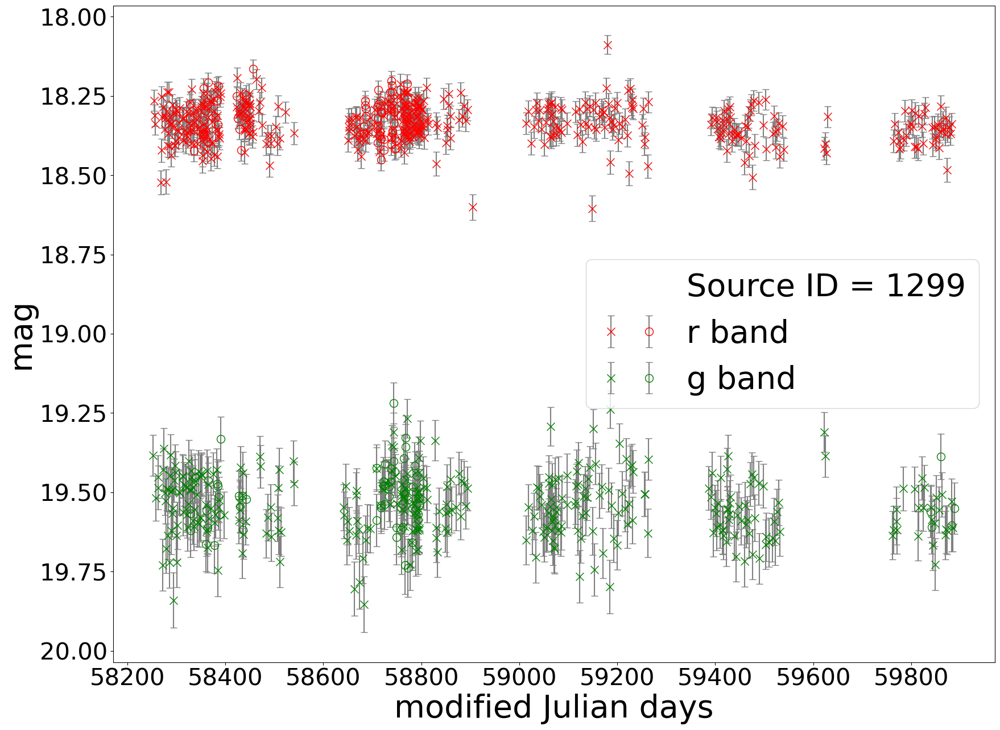

In [10]:
functions.draw_lightcurve(1299)

L-S_period: 3.4010475333652077
fit_period: 3.657342280714461 ± 0.18577910141524281
sin_chi2: 2.05907919
L-S_period: 3.4011826003596766
fit_period: 3.0734007613903773 ± 0.17068045156702652
sin_chi2: 1.53507546


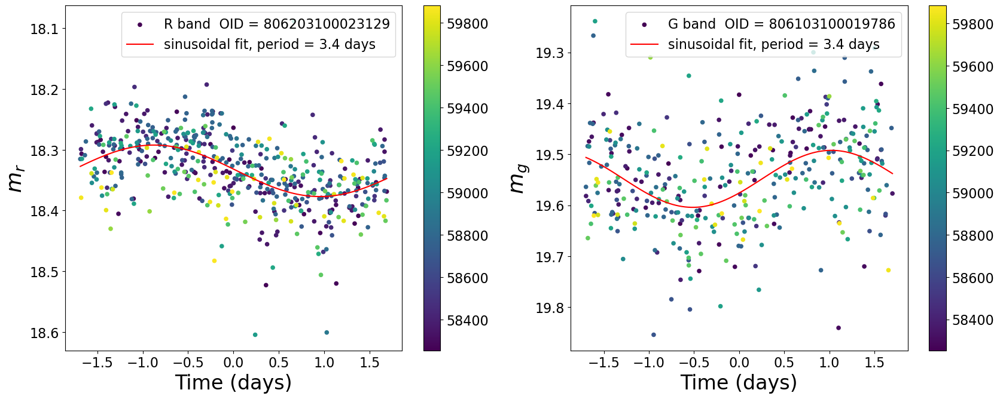

In [18]:
functions.sinfit_single(1299)

In [142]:
len(sourcefy(obj_zr)),len(sourcefy(obj_zr[np.isnan(obj_zr['dist'])==False]))

(37, 15)

In [143]:
len(sourcefy(obj_zg)),len(sourcefy(obj_zg[np.isnan(obj_zg['dist'])==False]))

(12, 4)

In [144]:
len(sourcefy(unobj_zr)),len(sourcefy(unobj_zr[np.isnan(unobj_zr['dist'])==False]))

(150, 42)

In [145]:
len(sourcefy(unobj_zg)),len(sourcefy(unobj_zg[np.isnan(unobj_zg['dist'])==False]))

(85, 25)

In [134]:
simbad_r=t_zr[np.isnan(t_zr['dist'])==False]
simbad_g=t_zg[np.isnan(t_zg['dist'])==False]

In [135]:
types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

In [121]:
print('T,P,V,N')
for i in range(len(types)):
    dummy=simbad_r[simbad_r['type']==types[i]]
    print(names[i])
    print(len(sourcefy(dummy[dummy['var']=='P']))+len(sourcefy(dummy[dummy['var']=='V']))+len(sourcefy(dummy[dummy['var']=='N'])),
          len(sourcefy(dummy[dummy['var']=='P'])),len(sourcefy(dummy[dummy['var']=='V'])),len(sourcefy(dummy[dummy['var']=='N'])))

T,P,V,N
Wolf-Rayet
18 0 4 14
Emission-line Star
50 3 9 38
Radio Source
6 0 3 3
HII Region
33 3 5 25
Planetary Nebula Candidate
8 0 0 8
X-ray Source
1 1 0 0
SuperNova Remnant
1 0 1 0
Carbon Star
14 1 0 13


In [136]:
print('T,P,V,N')
for i in range(len(types)):
    dummy=simbad_g[simbad_g['type']==types[i]]
    print(names[i])
    print(len(sourcefy(dummy[dummy['var']=='P']))+len(sourcefy(dummy[dummy['var']=='V']))+len(sourcefy(dummy[dummy['var']=='N'])),
          len(sourcefy(dummy[dummy['var']=='P'])),len(sourcefy(dummy[dummy['var']=='V'])),len(sourcefy(dummy[dummy['var']=='N'])))

T,P,V,N
Wolf-Rayet
16 0 4 12
Emission-line Star
40 1 7 32
Radio Source
2 0 0 2
HII Region
16 1 5 10
Planetary Nebula Candidate
6 0 0 6
X-ray Source
1 1 0 0
SuperNova Remnant
3 0 2 1
Carbon Star
5 0 1 4


In [137]:
len(sourcefy(obj_zr)),len(sourcefy(obj_zr[obj_zr['Gaia_count']!=0]))

(37, 32)

In [138]:
dummy=obj_zr[obj_zr['Gaia_count']!=0]
len(sourcefy(dummy[dummy['Plxflag']==0])),len(sourcefy(dummy[dummy['multiflag']==1]))

(22, 6)

In [139]:
len(sourcefy(obj_zg)),len(sourcefy(obj_zg[obj_zg['Gaia_count']!=0]))

(12, 12)

In [140]:
dummy=obj_zg[obj_zg['Gaia_count']!=0]
len(sourcefy(dummy[dummy['Plxflag']==0])),len(sourcefy(dummy[dummy['multiflag']==1]))

(6, 4)

In [141]:
len(sourcefy(nonvar_zr)),len(sourcefy(nonvar_zr[nonvar_zr['Gaia_count']!=0]))

(1329, 851)

In [119]:
dummy=nonvar_zr[nonvar_zr['Gaia_count']!=0]
len(sourcefy(dummy[dummy['Plxflag']==0])),len(sourcefy(dummy[dummy['multiflag']==1]))

(446, 41)

In [108]:
len(sourcefy(unobj_zr)),len(sourcefy(unobj_zr[unobj_zr['Gaia_count']!=0]))

(150, 96)

In [109]:
dummy=unobj_zr[unobj_zr['Gaia_count']!=0]
len(sourcefy(dummy[dummy['Plxflag']==0])),len(sourcefy(dummy[dummy['multiflag']==1]))

(60, 27)

In [110]:
len(sourcefy(unobj_zg)),len(sourcefy(unobj_zg[unobj_zg['Gaia_count']!=0]))

(85, 64)

In [111]:
dummy=unobj_zg[unobj_zg['Gaia_count']!=0]
len(sourcefy(dummy[dummy['Plxflag']==0])),len(sourcefy(dummy[dummy['multiflag']==1]))

(39, 14)

In [120]:
len(sourcefy(nonvar_zg)),len(sourcefy(nonvar_zg[nonvar_zg['Gaia_count']!=0]))

(767, 659)

In [121]:
dummy=nonvar_zg[nonvar_zg['Gaia_count']!=0]
len(sourcefy(dummy[dummy['Plxflag']==0])),len(sourcefy(dummy[dummy['multiflag']==1]))

(297, 47)

In [158]:
t_zr=QTable.read('t_zr_20231024.ecsv')
t_zg=QTable.read('t_zg_20231024.ecsv')
t_zr=t_zr[np.isnan(t_zr['LNP_SIG'])==False]
t_zg=t_zg[np.isnan(t_zg['LNP_SIG'])==False]

XMM_zr=QTable.read('XMM_Wang_zr.csv')
XMM_zg=QTable.read('XMM_Wang_zg.csv')
Chandra_zr=QTable.read('Chandra_zr.csv')
Chandra_zg=QTable.read('Chandra_zg.csv')

In [ ]:
t_zr[np.isin(t_zr['SourceID'],XMM_zr['SourceID'])]

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,str1,str1,bool
382,zr,806203100023154,5.108304,59.3125919,857,179.23187255859375,2.0173885777443306,0.43992262077737826,0.041480086743831635,2.2262096770277116e-30,2800.0,0.997336033066433,0.29728781203870636,0.8277171998726481,18.040523529052734,0.041480086743831635,17.87698745727539,18.18714714050293,-0.033149030059576035,1.4199025630950928,0.21096082583835143,0.0432444409743903,0.894196017526215,1.0,0.02469891692542925,0.001418665519011153,0.9620135286002843,g1,NonVar,0.85,0.0,4535.704652700006,--,nan,--,1,0,0.030062,0.0,17.953894,796.589,1.1691,0.0976,1,N,N,False
382,zr,1809211300042378,5.1083141,59.3125867,77,143.87274169921875,1.7138172650333494,0.8087420098804036,0.03456461802124977,0.1181513436386655,0.14233955696581074,2800.0,0.21143268846797045,0.0636181348615477,18.03172492980957,0.03456461802124977,17.918540954589844,18.12317657470703,-0.026091665029525757,1.301390290260315,1.152406524085906,0.8754681224482324,2.1174604790035603,1.0,0.2971042276513084,0.09601193575665345,0.7796475450634315,g1,NonVar,0.47,1.0,0.08121598028728597,--,nan,--,1,0,0.030062,0.0,17.953894,796.589,1.1691,0.0976,1,N,N,False
889,zr,1809211300066832,5.1209659,59.2810468,35,20.05918312072754,2.0685033613041024,0.4127907170064924,0.17555049061775208,0.08369777607535735,0.9075262824924325,2800.0,0.41028693175405656,0.06677730340214527,20.368026733398438,0.17555049061775208,19.94868278503418,20.669456481933594,-0.15933384001255035,1.447617769241333,1.0861476396332654,1.1078419264610768,0.7226252835707411,0.0,0.49501169308888093,0.899011879835983,0.3020521769594571,gu,DSCT,0.53,1.0,0.04127109653263324,[CC2004] J002029.0+591651.6,0.336205,Star,1,0,1.963999,0.0,20.917904,21.0692,nan,nan,0,N,N,False
1843,zr,806203100023114,5.1778086,59.3142963,859,240.10179138183594,4.1348284114395,3.8211621356021924e-35,0.0430571623146534,7.28846422679995e-64,1128.3143454295916,0.997336033066433,0.504813527059251,0.09219368211855113,17.39191436767578,0.0430571623146534,17.285358428955078,17.502267837524414,-0.03789094090461731,2.0321946144104004,0.9850289689360678,0.2137336500317433,1.0174536386504924,0.0,0.02760473169739952,0.02591067058373786,0.5164896723193969,g2,EB_ESD,0.39,1.0,0.997954819075909,--,nan,--,1,0,0.054858,0.0,17.4216,585.511,1.0713,0.072,1,P,P,False
1843,zr,1809211300007269,5.1778341,59.3142873,77,238.63108825683594,3.9385336058075398,9.759846542296536e-07,0.037459272891283035,7.646459557683472e-09,793.470862318453,2800.0,0.5056602042605542,0.39670573457002845,17.37808609008789,0.037459272891283035,17.298614501953125,17.473064422607422,-0.03365812823176384,1.9725068807601929,8.933909122816605,10.715600200123683,10.475315995219962,0.0,0.6421118989778836,0.4974041203925166,0.580468727274353,g1,LPV_OSARG_AGB,0.48,1.0,1328.6934374999983,--,nan,--,1,0,0.054858,0.0,17.4216,585.511,1.0713,0.072,1,P,V,False


In [ ]:
t_zg[np.isin(t_zg['SourceID'],XMM_zg['SourceID'])]

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,str1,str1,bool
382,zg,1809111300028558,5.1083068,59.3125885,62,24.642648696899414,0.9711180947123715,0.9997661572116434,0.08429839462041855,0.022116103410773108,0.24404293571136484,2800.0,0.29597658583720954,0.07586238830346038,19.64371681213379,0.08429839462041855,19.47008514404297,19.852153778076172,-0.05584395304322243,0.9821974635124207,0.8888596453234898,0.6341343889533925,0.760812128059556,1.0,0.265356918377606,0.350225503113053,0.4213327989325083,gu,EB_ESD,0.52,1.0,2.1088029722891353,--,nan,--,1,0,0.037267,0.0,17.953894,796.589,1.1691,0.0976,1,N,N,False
382,zg,806103100029765,5.1083193,59.3125958,317,60.13040542602539,1.9799815951032476,0.5400874774727449,0.10754340887069702,0.002065410188256915,1.035207307415412,1.0000143393856216,0.08507256280141595,0.012891316023611168,19.659168243408203,0.10754340887069702,19.23293113708496,20.05847930908203,-0.09595092386007309,1.4149820804595947,0.01524479684766394,0.005736690656273158,0.10134203002763283,1.0,0.08020806339992081,0.001940580290152094,0.9884691777245843,g1,NonVar,0.76,1.0,0.04136316797191319,--,nan,--,1,0,0.037267,0.0,17.953894,796.589,1.1691,0.0976,1,N,N,False
1843,zg,806103100036139,5.1778247,59.3142982,336,102.15980529785156,2.2144624109956204,0.08434765068195327,0.06726983189582825,7.900414405599773e-16,981.8020181561881,1.0000143393856216,0.226353228480905,0.03570537732725455,18.792747497558594,0.06726983189582825,18.546789169311523,18.972463607788086,-0.05699879303574562,1.489238977432251,0.09224697287578232,0.11582418445079105,0.3627295006098054,1.0,0.6882190768524743,0.05848774391519529,0.9543283840833973,g1,LPV_SRV_AGB_C,0.23,0.0,1133.9712499500001,--,nan,--,1,0,0.059928,0.0,17.4216,585.511,1.0713,0.072,1,N,N,False
1843,zg,1809111300004711,5.1778359,59.3142883,65,63.863834381103516,1.6699910860203973,0.8239474872286021,0.06162409111857414,0.024340863141901127,0.13352581478522302,2800.0,0.28257220914385495,0.062521731402272,18.755382537841797,0.06162409111857414,18.624942779541016,18.931976318359375,-0.04892897605895996,1.2850794792175293,0.6373258504250687,0.32969859652090794,1.515935771660374,1.0,0.14668082569284513,0.027730798668440526,0.8621906076038399,g1,DSCT,0.62,1.0,0.15417806359832478,--,nan,--,1,0,0.059928,0.0,17.4216,585.511,1.0713,0.072,1,N,N,False


In [ ]:
t_zr[np.isin(t_zr['SourceID'],Chandra_zr['SourceID'])]

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,str1,str1,bool
77,zr,806203100063307,5.0870906,59.2998095,836,344.7351989746094,40.842491010031104,0.0,0.22717958688735962,7.488112388238467e-24,26.55255504914417,0.997336033066433,0.25554257162342087,0.0034232661997002983,18.791976928710938,0.22717958688735962,17.675485610961914,19.1998348236084,-0.8078729510307312,6.599571704864502,0.010941253454579771,0.0022451831278411214,0.04598158685382897,1.0,0.024749755228021697,0.001446042828369909,0.961198797591372,g1,CEPH_Other,0.44,0.0,26.524588612280738,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,P,P,False
77,zr,1809211300074746,5.0870934,59.2997909,75,339.8369140625,80.43303571096826,0.0,0.26337021589279175,1.3349568059073803e-11,0.5081678123002179,2800.0,0.5958935079344113,0.34858179928581884,18.844051361083984,0.26337021589279175,17.768030166625977,19.322647094726562,-1.2469897270202637,9.363984107971191,0.060816512321346654,0.020122908699598416,0.08327234162645296,1.0,0.06264230945395721,0.03406160489283805,0.6555665316467969,g1,EB_ED,0.38,1.0,26.573868749999964,[WWW2005] XA 11,0.264632,X,2,1,0.183873,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,P,P,False
131,zr,1809211300061962,5.048199,59.3041662,73,29.504880905151367,1.153071540890909,0.9985064235861478,0.08427942544221878,0.0798305818105389,0.14840638626961022,2800.0,0.2304674477443303,0.0030968262857808478,19.60923194885254,0.08427942544221878,19.427034378051758,19.8101806640625,-0.06635956466197968,1.0725511312484741,0.3479448186529524,0.41456715732115984,0.4469326983126726,1.0,0.6355557759790607,0.42168729774888647,0.6252195977023953,g1,DSCT,0.72,1.0,0.05006569341346691,--,nan,--,1,0,0.075293,0.0,19.435043,388.562,0.8104,0.2648,1,N,N,False
131,zr,806203100043680,5.0481869,59.3041783,745,49.775604248046875,1.5862773018272889,0.9991426307432826,0.104093037545681,0.0014827231886257103,1.0005039811520542,0.997336033066433,0.07084300247525004,0.1350692648935182,19.61176109313965,0.104093037545681,19.222640991210938,20.041255950927734,-0.09199278801679611,1.2679911851882935,0.018899859106927798,0.01933710873039264,0.13639748005051386,1.0,0.4975631269715428,0.011967883579859118,0.9908559109541679,g1,EB_ED,0.51,1.0,1.0005966584381218,--,nan,--,1,0,0.075293,0.0,19.435043,388.562,0.8104,0.2648,1,N,N,False
158,zr,806203100057075,5.0953672,59.297784,702,85.88482666015625,6.528562040377028,1.9791103413711206e-94,0.179270938038826,5.255097789862924e-52,595.2450708466688,0.997336033066433,0.4806277327856466,0.1408160323876546,19.39754295349121,0.179270938038826,18.829944610595703,19.830501556396484,-0.3216327726840973,2.6130337715148926,0.04033986549469937,0.01823640263202334,0.044388907661337296,0.0,0.1137638087262609,0.09485607097744764,0.5485841987547181,g1,LPV_SRV_AGB_O,0.39,0.0,647.9578075285723,LGGS J002022.90+591751.8,0.252989,Em*,1,0,0.248628,0.0,19.25806,233.814,-0.0851,0.2523,0,P,P,False
158,zr,1809211300042636,5.0953685,59.2977456,75,71.64258575439453,7.936200990853824,6.189200495625707e-28,0.1940486580133438,7.047740850728901e-24,0.996265133849449,2800.0,0.8178076154964021,0.43174711974879304,19.335777282714844,0.1940486580133438,19.028980255126953,19.818803787231445,-0.41529056429862976,2.8805739879608154,0.6479455310986156,0.09380150564932677,0.5788890294991144,0.0,0.

In [ ]:
t_zg[np.isin(t_zg['SourceID'],Chandra_zg['SourceID'])]

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,var,lc_var,var_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,str1,str1,bool
77,zg,1809111300028707,5.0869088,59.2997883,43,30.561182022094727,3.5934153474930794,0.0011670505434022043,0.2023804783821106,9.172006998323314e-05,0.4977145658755225,2800.0,0.5493380675950789,0.330126990560579,20.129234313964844,0.2023804783821106,19.619304656982422,20.54409408569336,-0.23570173978805542,1.923271894454956,0.23819957603460104,0.1686956409547268,0.18114480752366197,1.0,0.2618602548474014,0.4245645807923265,0.3635335105649846,gu,EB_ED,0.34,1.0,1.0009759930757987,[WWW2005] XA 11,0.385353,X,2,1,0.452534,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,P,N,False
77,zg,806103100029923,5.0869784,59.2997881,258,80.47639465332031,16.358047581022113,8.308402166762659e-291,0.31344184279441833,2.3170100655180286e-16,26.55360081018743,1.0000143393856216,0.29023605619128945,0.005352919590317105,20.02450942993164,0.31344184279441833,18.832887649536133,20.759401321411133,-0.705572783946991,4.285964488983154,0.012970672357106496,0.004716468677232082,0.04254821537149007,1.0,0.07510737992757988,0.007362311539822919,0.9301277856779838,g1,CEPH_Other,0.42,0.0,26.525643273684214,[WWW2005] XA 11,0.385353,X,2,1,0.452534,4.094143433038542,19.001991,118.576,0.0394,0.2003,0,P,P,False
131,zg,806103100042702,5.0482513,59.3041746,113,21.79442596435547,2.022145170882652,0.4492364311396512,0.21897898614406586,2.3404002878530235e-06,1.035065076880077,0.9973613360354121,0.30069151884786693,0.1893251708314889,21.01278305053711,0.21897898614406586,20.369171142578125,21.507190704345703,-0.11709506809711456,1.431470274925232,0.024044643309456017,0.01594293997342642,0.07830492368799082,0.0,0.23229877124945142,0.024372764811513625,0.9289723391821424,g1,CEPH_Other,0.24,1.0,1.035110802673799,--,nan,--,1,0,0.168478,0.0,19.435043,388.562,0.8104,0.2648,1,N,N,False
131,zg,1809111300004928,5.0481507,59.3042239,19,10.46309757232666,1.222692700002041,0.8941769058807081,0.1937699317932129,0.00042922054059150956,0.26186787448751264,2800.0,0.8167899341403893,0.16679830593474548,21.001815795898438,0.1937699317932129,20.609041213989258,21.315601348876953,-0.08085915446281433,1.0856616497039795,0.2746952942905659,0.36158312741478443,0.27505540028752273,0.0,0.7374313382120778,0.7360480959830773,0.5006672130275814,g1,DSCT,0.57,1.0,0.05062151102782939,--,nan,--,1,0,0.168478,0.0,19.435043,388.562,0.8104,0.2648,1,N,N,False
158,zg,1809111300037377,5.095539,59.2977809,19,22.446136474609375,4.73362481557189,0.0009104236075155791,0.2825361490249634,0.0004186142942346896,0.5269324635791114,2800.0,0.8199526286743393,0.12848427110833116,20.503704071044922,0.2825361490249634,19.97296905517578,20.987234115600586,-0.3228687345981598,2.201075792312622,0.505909647681311,0.33064435382107094,0.7546837620062258,0.0,0.2262556700456113,0.1072005343795489,0.6946057042988047,g1,DSCT,0.65,1.0,0.03750857766155011,LGGS J002022.90+591751.8,0.531241,Em*,1,0,0.530633,0.0,19.25806,233.814,-0.0851,0.2523,0,N,N,False
158,zg,806103100042723,5.0956278,59.2977934,87,25.83161163330078,2.120494188071508,0.329981132173124,0.19530770182609558,7.314642818985119e-05,1.00262111022645,0.9999897311965724,0.32111372674743155,0.11373542499283457,20.66767692565918,0.19530770182609558,20.11071014404297,21.149940490722656,-0.1281728893518448,1.466211199760437,0.09135229200876589,0.0469806889492684

In [ ]:
t_zr.add_column(0,name='XMM',index=-4)
t_zr.add_column(np.nan,name='XMM_dist',index=-4)
t_zr.add_column(0,name='Chandra',index=-4)
t_zr.add_column(np.nan,name='Chandra_dist',index=-4)

t_zg.add_column(0,name='XMM',index=-4)
t_zg.add_column(np.nan,name='XMM_dist',index=-4)
t_zg.add_column(0,name='Chandra',index=-4)
t_zg.add_column(np.nan,name='Chandra_dist',index=-4)

In [ ]:
for row in t_zr:
    XMM_copy=XMM_zr[XMM_zr['SourceID']==row['SourceID']]
    if len(XMM_copy)!=0:
        row['XMM']=1
        row['XMM_dist']=XMM_copy['angDist']
    
    Chandra_copy=Chandra_zr[Chandra_zr['SourceID']==row['SourceID']]
    if len(Chandra_copy)!=0:
        row['Chandra']=1
        row['Chandra_dist']=Chandra_copy['angDist']

for row in t_zg:
    XMM_copy=XMM_zg[XMM_zg['SourceID']==row['SourceID']]
    if len(XMM_copy)!=0:
        row['XMM']=1
        row['XMM_dist']=XMM_copy['angDist']
    
    Chandra_copy=Chandra_zg[Chandra_zg['SourceID']==row['SourceID']]
    if len(Chandra_copy)!=0:
        row['Chandra']=1
        row['Chandra_dist']=Chandra_copy['angDist']

In [ ]:
t_zr.write('t_zr_0410.ecsv')
t_zg.write('t_zg_0410.ecsv')

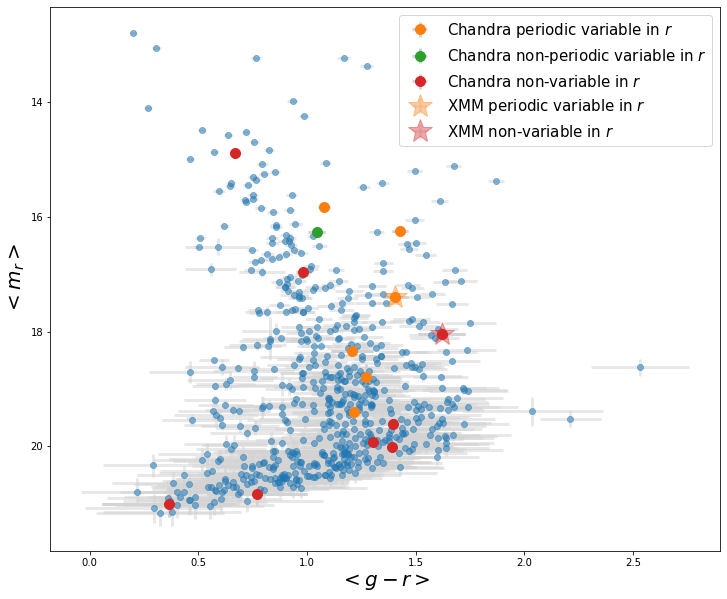

In [159]:
plt.figure(figsize=(12,10))
plt.gca().invert_yaxis()
plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$<m_r>$',fontsize=20)
alpha=1

# all
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zr['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_r'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_r'],fmt='o',
             ecolor='lightgray', elinewidth=3, capsize=0,alpha=0.5)

color_dic={'P':'#ff7f0e','V':'#2ca02c','N':'#d62728'}

var_dic={'P':'Chandra periodic variable in $r$','V':'Chandra non-periodic variable in $r$','N':'Chandra non-variable in $r$'}
for var in ['P','V','N']:
    t_Chandra_zr=sourcefy(t_zr[np.isin(t_zr['SourceID'],Chandra_zr['SourceID'])])
    t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_Chandra_zr[t_Chandra_zr['var']==var]['SourceID']))]
    t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
    plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_r'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_r'],fmt='o',markersize=10,
                 ecolor='lightgray', elinewidth=3, capsize=0,alpha=1,label=var_dic[var],markerfacecolor=color_dic[var],markeredgecolor=color_dic[var])
    
var_dic={'P':'XMM periodic variable in $r$','V':'XMM non-periodic variable in $r$','N':'XMM non-variable in $r$'}
for var in ['P','V','N']:
    t_XMM_zr=sourcefy(t_zr[np.isin(t_zr['SourceID'],XMM_zr['SourceID'])])
    t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_XMM_zr[t_XMM_zr['var']==var]['SourceID']))]
    if len(t_plot)!=0:
        t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
        plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_r'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_r'],fmt='*',markersize=25,
                     ecolor='lightgray', elinewidth=3, capsize=0,alpha=0.4,label=var_dic[var],markerfacecolor=color_dic[var],markeredgecolor=color_dic[var])


#plt.xlim(0,2)
#plt.ylim(21,18)
plt.legend(loc=0,fontsize=15)

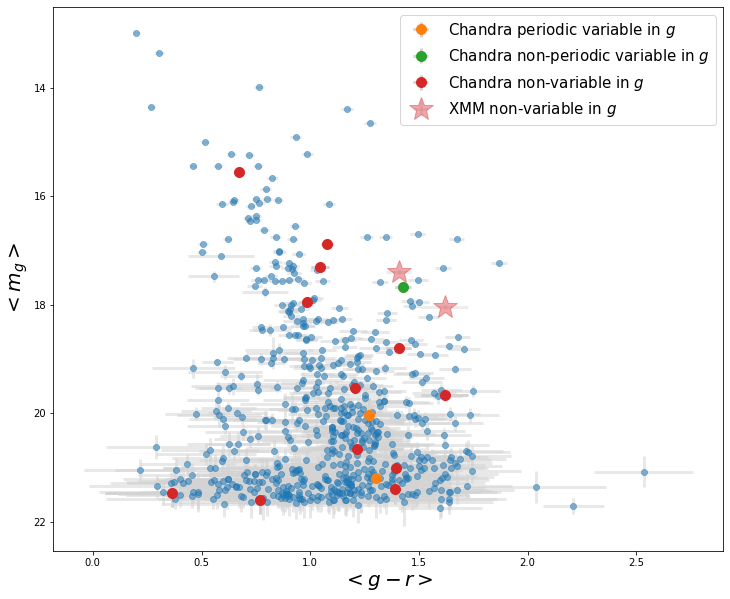

In [160]:
plt.figure(figsize=(12,10))
plt.gca().invert_yaxis()
plt.xlabel('$<g - r>$',fontsize=20)
plt.ylabel('$<m_g>$',fontsize=20)
alpha=1

# all
t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_zg['SourceID']))]
t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_g'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_g'],fmt='o',
             ecolor='lightgray', elinewidth=3, capsize=0,alpha=0.5)

color_dic={'P':'#ff7f0e','V':'#2ca02c','N':'#d62728'}

var_dic={'P':'Chandra periodic variable in $g$','V':'Chandra non-periodic variable in $g$','N':'Chandra non-variable in $g$'}
for var in ['P','V','N']:
    t_Chandra_zg=sourcefy(t_zg[np.isin(t_zg['SourceID'],Chandra_zg['SourceID'])])
    t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_Chandra_zg[t_Chandra_zg['var']==var]['SourceID']))]
    t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
    plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_g'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_g'],fmt='o',markersize=10,
                 ecolor='lightgray', elinewidth=3, capsize=0,alpha=1,label=var_dic[var],markerfacecolor=color_dic[var],markeredgecolor=color_dic[var])
    
var_dic={'P':'XMM periodic variable in $g$','V':'XMM non-periodic variable in $g$','N':'XMM non-variable in $g$'}
for var in ['P','V','N']:
    t_XMM_zg=sourcefy(t_zg[np.isin(t_zg['SourceID'],XMM_zg['SourceID'])])
    t_plot=t_color[np.isin(t_color['SourceID'],np.unique(t_XMM_zg[t_XMM_zg['var']==var]['SourceID']))]
    if len(t_plot)!=0:
        t_plot=t_plot[np.isnan(t_plot['mean_color'])==False]
        plt.errorbar(t_plot['mean_color'],t_plot['mean_mag_r'],xerr=t_plot['std_color'],yerr=t_plot['std_mag_r'],fmt='*',markersize=25,
                     ecolor='lightgray', elinewidth=3, capsize=0,alpha=0.4,label=var_dic[var],markerfacecolor=color_dic[var],markeredgecolor=color_dic[var])


#plt.xlim(0,2)
#plt.ylim(21,18)
plt.legend(loc=0,fontsize=15)

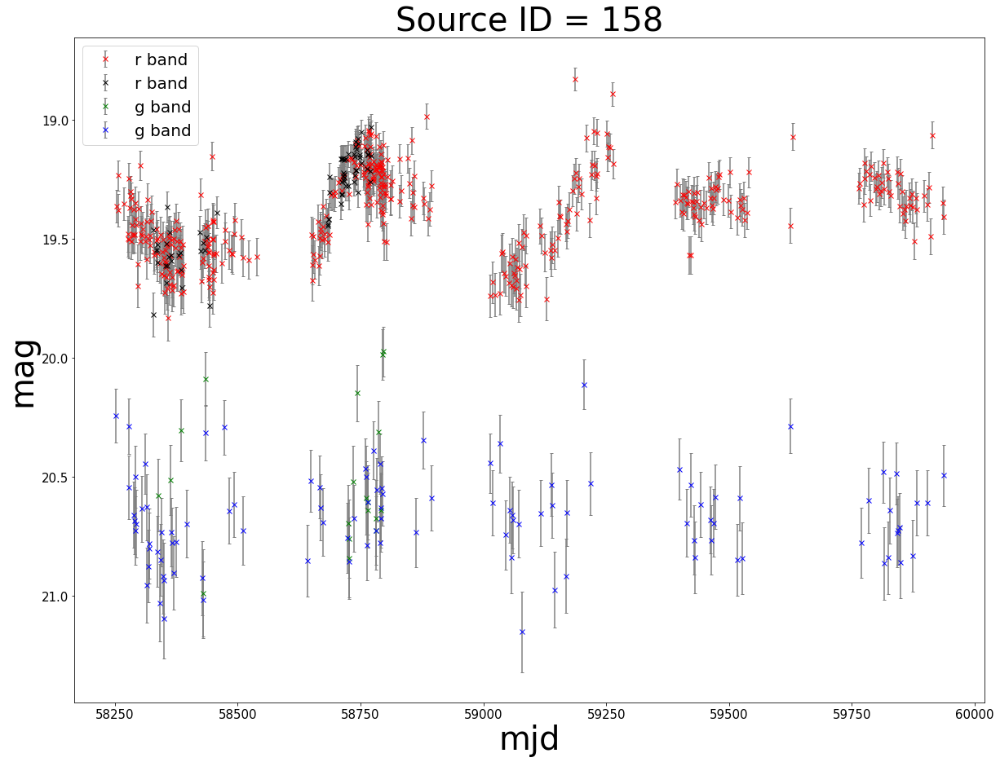

In [ ]:
functions.draw_lightcurve(158)

In [ ]:
'black',0.7,5,

'cornflowerblue',0.9,10,

,'red',1,10,

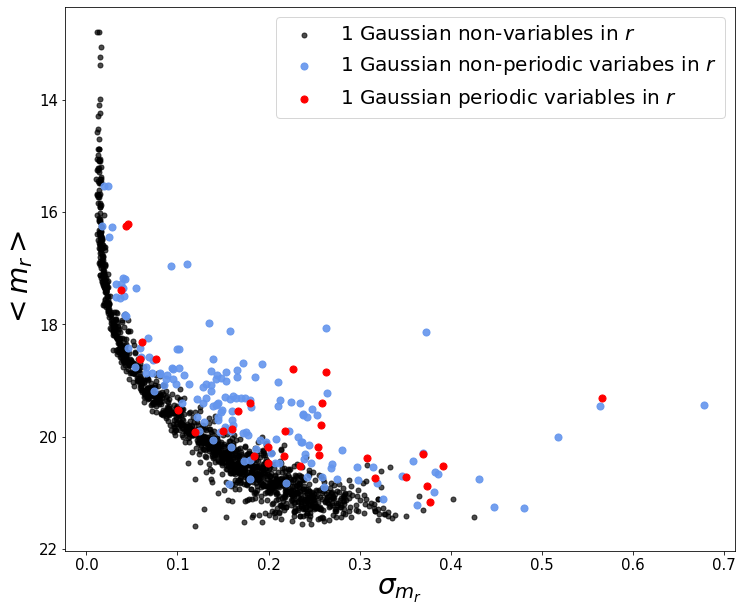

In [46]:
tr_g1=t_zr[t_zr['shape']=='g1']
tg_g1=t_zg[t_zg['shape']=='g1']

fs=20
plt.figure(figsize=(12,10))
plt.scatter(tr_g1[tr_g1['var']=='N']['std'],tr_g1[tr_g1['var']=='N']['mean'],c='black',alpha=0.7,s=25,label='1 Gaussian non-variables in $r$')
plt.scatter(tr_g1[tr_g1['var']=='V']['std'],tr_g1[tr_g1['var']=='V']['mean'],c='cornflowerblue',alpha=0.9,s=50,label='1 Gaussian non-periodic variabes in $r$')
plt.scatter(tr_g1[tr_g1['var']=='P']['std'],tr_g1[tr_g1['var']=='P']['mean'],c='red',alpha=1,s=50,label='1 Gaussian periodic variables in $r$')


plt.ylabel('$<m_r>$',fontsize=fs*1.4)
plt.xlabel('$\sigma_{m_r}$',fontsize=fs*1.4)
plt.gca().invert_yaxis()
plt.xticks(fontsize=fs*0.75)
plt.yticks(fontsize=fs*0.75)
plt.legend(fontsize=fs)

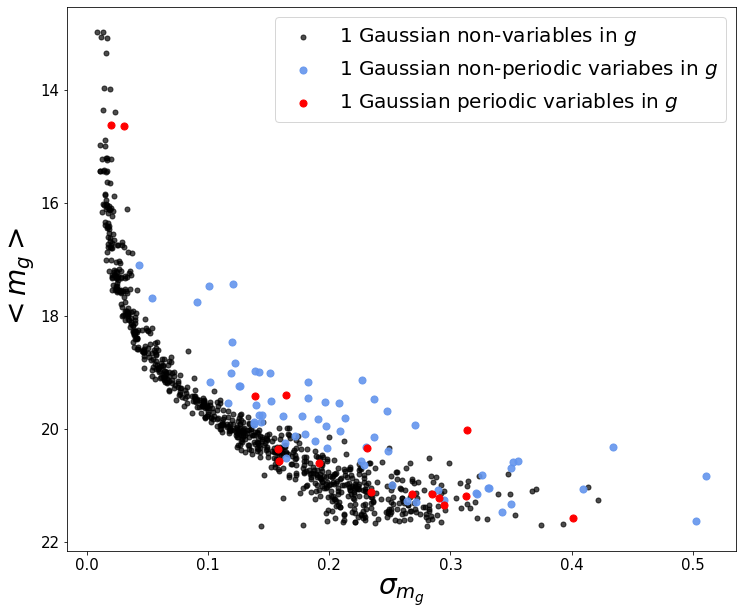

In [47]:
fs=20
plt.figure(figsize=(12,10))
plt.scatter(tg_g1[tg_g1['var']=='N']['std'],tg_g1[tg_g1['var']=='N']['mean'],c='black',alpha=0.7,s=25,label='1 Gaussian non-variables in $g$')
plt.scatter(tg_g1[tg_g1['var']=='V']['std'],tg_g1[tg_g1['var']=='V']['mean'],c='cornflowerblue',alpha=0.9,s=50,label='1 Gaussian non-periodic variabes in $g$')
plt.scatter(tg_g1[tg_g1['var']=='P']['std'],tg_g1[tg_g1['var']=='P']['mean'],c='red',alpha=1,s=50,label='1 Gaussian periodic variables in $g$')


plt.ylabel('$<m_g>$',fontsize=fs*1.4)
plt.xlabel('$\sigma_{m_g}$',fontsize=fs*1.4)
plt.gca().invert_yaxis()
plt.xticks(fontsize=fs*0.75)
plt.yticks(fontsize=fs*0.75)
plt.legend(fontsize=fs)

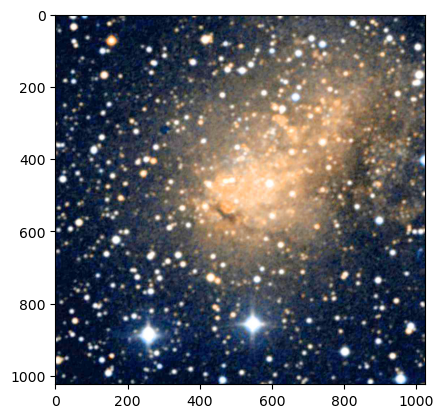

In [34]:
from astropy.visualization import make_lupton_rgb

image1 = plt.imread('cutout-CDS_P_DSS2_color.jpg')

image1 = make_lupton_rgb(image1[:,:,0]*1.0, image1[:,:,1]*1.0, image1[:,:,2]*1.0, stretch=50, Q=3)
plt.imshow(image1)

shape=image1.shape[0]

In [35]:
#import cv2

def sinusoidal_projection(ra, dec):
    # Convert RA and Dec from degrees to radians
    ra_rad = np.radians(ra)
    dec_rad = np.radians(dec)

    # Sinusoidal projection formula
    x = ra_rad * np.cos(dec_rad)
    y = dec_rad

    return x, y

1516


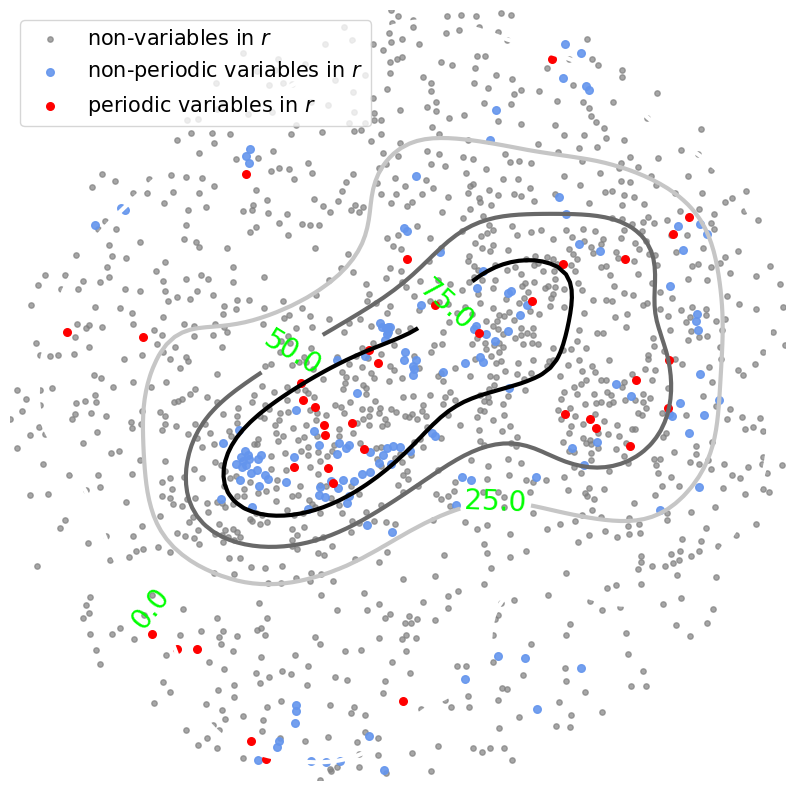

In [39]:
fig = plt.figure(figsize=(10,10))
plt.axis('off')

t=sourcefy(t_zr[t_zr['var']=='N'])
x, y = sinusoidal_projection(t['RA'], t['DEC'])
plt.scatter(x,y,c='grey',alpha=0.7,s=15,label='non-variables in $r$')
t=sourcefy(t_zr[t_zr['var']=='V'])
x, y = sinusoidal_projection(t['RA'], t['DEC'])
plt.scatter(x,y,c='cornflowerblue',alpha=0.9,s=30,label='non-periodic variables in $r$')
t=sourcefy(t_zr[t_zr['var']=='P'])
x, y = sinusoidal_projection(t['RA'], t['DEC'])
plt.scatter(x,y,c='red',alpha=1,s=30,label='periodic variables in $r$')
#plt.xlabel('RA (deg)',fontsize=20)
#plt.ylabel('DEC (deg)',fontsize=20)


t=sourcefy(t_zr)
#t=t_zr
print(len(t))
x, y = sinusoidal_projection(t['RA'], t['DEC'])

# Create a kernel density estimate of the data
#kde = gaussian_kde([x, y],bw_method=0.3)
kde = gaussian_kde([x, y])

# Define the grid on which to evaluate the density estimate
xmin, xmax = x.min(), x.max()
ymin, ymax = y.min(), y.max()
xgrid, ygrid = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
positions = np.vstack([xgrid.ravel(), ygrid.ravel()])

# Evaluate the density estimate on the grid
density = kde(positions).reshape(xgrid.shape)
#density/=(density.mean()*((1036.5+3*34)/1516))  # normalize with density at background field
density/=(density.mean()*(1036.5/1516))  # normalize with density at background field
density=(density-1)/(34.00367627/1036.5)

# Create the contour plot
#CS=plt.contour(xgrid, ygrid, density, cmap='Greys', alpha=1,levels=8,linewidths=3)
#CS=plt.contour(xgrid, ygrid, density, cmap='Greys', alpha=1,levels=[0,10,20,30,40,50,60,70,80,90],linewidths=3)
CS=plt.contour(xgrid, ygrid, density, cmap='Greys', alpha=1,levels=[0,25,50,75],linewidths=3)
plt.clabel(CS,CS.levels,inline=True,fmt='%1.1f',fontsize=20,colors='lime')
#plt.imshow(np.rot90(density), cmap='viridis', extent=[xmin, xmax, ymin, ymax],alpha=0.5)
#plt.colorbar(label='Density')



x, y = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])
plt.xlim(x.min(),x.max())
plt.ylim(y.min(),y.max())



plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

# save the image without the border
plt.savefig('overlaytest.png', bbox_inches='tight', pad_inches=0,facecolor='none')



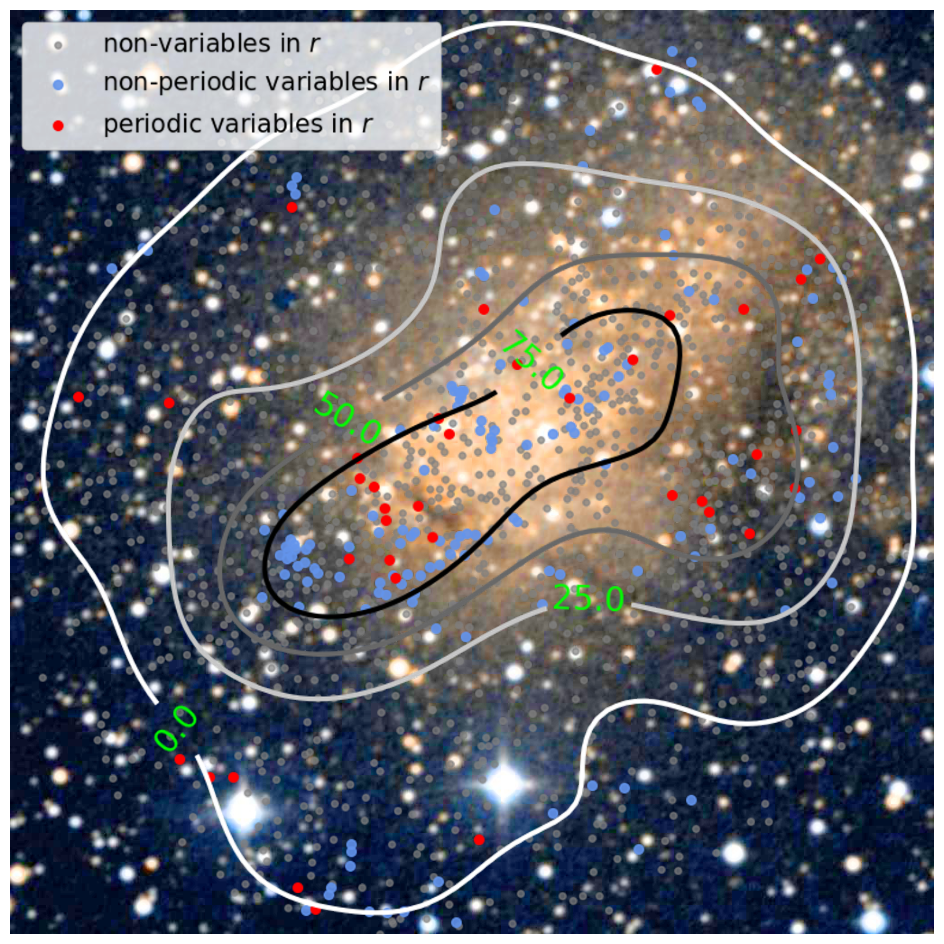

In [40]:

from PIL import Image

fig = plt.figure(figsize=(12,12))
plt.axis('off')

image2 = Image.open('overlaytest.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

In [80]:
# pick points within the 25 contour
from scipy.interpolate import griddata

density_threshold = 25


# Convert RA and DEC to your projection (you've already defined this projection earlier)
x, y = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])

# Interpolate the KDE's density at the RA and DEC locations
point_densities = griddata(
    points=(xgrid.ravel(), ygrid.ravel()),  # Grid points where KDE was evaluated
    values=density.ravel(),  # KDE values
    xi=(x, y),  # Original data points' RA and DEC projected
    method='linear'  # Interpolation method
)

t_zr['inside_flag'] = point_densities > density_threshold

# Convert RA and DEC to your projection (you've already defined this projection earlier)
x, y = sinusoidal_projection(t_zg['RA'], t_zg['DEC'])

# Interpolate the KDE's density at the RA and DEC locations
point_densities = griddata(
    points=(xgrid.ravel(), ygrid.ravel()),  # Grid points where KDE was evaluated
    values=density.ravel(),  # KDE values
    xi=(x, y),  # Original data points' RA and DEC projected
    method='linear'  # Interpolation method
)

t_zg['inside_flag'] = point_densities > density_threshold

In [114]:
t_zr['ic10_flag'] = (t_zr['inside_flag']==1)&(t_zr['Plxflag']==0)
t_zg['ic10_flag'] = (t_zg['inside_flag']==1)&(t_zg['Plxflag']==0)

In [115]:
#t_zr.write('t_zr_20240401.ecsv',overwrite=True)
#t_zg.write('t_zg_20240401.ecsv',overwrite=True)

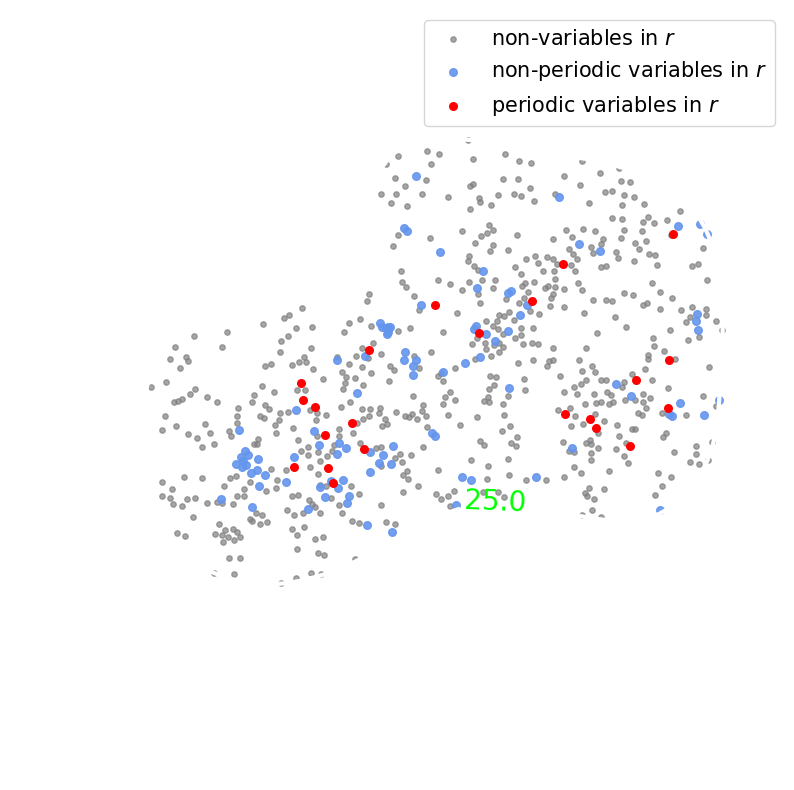

In [124]:
fig = plt.figure(figsize=(10,10))
plt.axis('off')

t_zr_ic10=t_zr[t_zr['ic10_flag']==1]
t=sourcefy(t_zr_ic10[t_zr_ic10['var']=='N'])
x, y = sinusoidal_projection(t['RA'], t['DEC'])
plt.scatter(x,y,c='grey',alpha=0.7,s=15,label='non-variables in $r$')
t=sourcefy(t_zr_ic10[t_zr_ic10['var']=='V'])
x, y = sinusoidal_projection(t['RA'], t['DEC'])
plt.scatter(x,y,c='cornflowerblue',alpha=0.9,s=30,label='non-periodic variables in $r$')
t=sourcefy(t_zr_ic10[t_zr_ic10['var']=='P'])
x, y = sinusoidal_projection(t['RA'], t['DEC'])
plt.scatter(x,y,c='red',alpha=1,s=30,label='periodic variables in $r$')
#plt.xlabel('RA (deg)',fontsize=20)
#plt.ylabel('DEC (deg)',fontsize=20)



CS=plt.contour(xgrid, ygrid, density, cmap='Greys', alpha=1,levels=[25],linewidths=3)
plt.clabel(CS,CS.levels,inline=True,fmt='%1.1f',fontsize=20,colors='lime')
#plt.imshow(np.rot90(density), cmap='viridis', extent=[xmin, xmax, ymin, ymax],alpha=0.5)
#plt.colorbar(label='Density')



x, y = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])
plt.xlim(x.min(),x.max())
plt.ylim(y.min(),y.max())



plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

# save the image without the border
plt.savefig('overlayic10.png', bbox_inches='tight', pad_inches=0,facecolor='none')



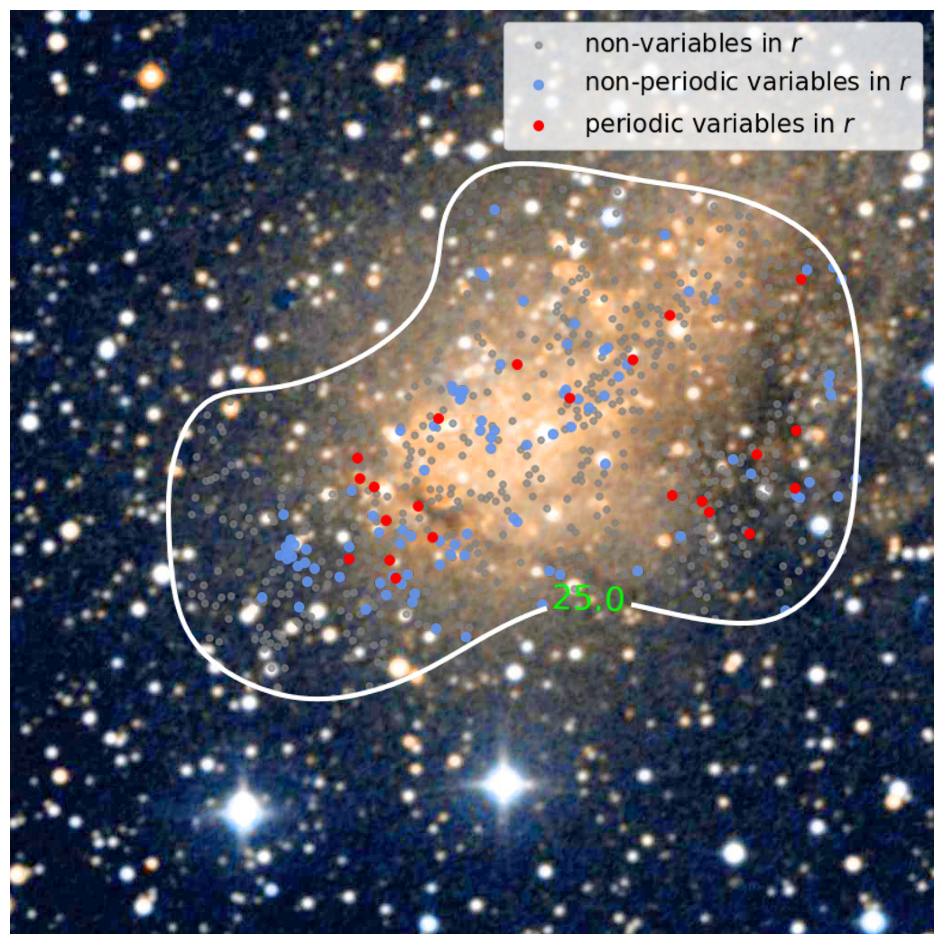

In [125]:
from PIL import Image

fig = plt.figure(figsize=(12,12))
plt.axis('off')

image2 = Image.open('overlayic10.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

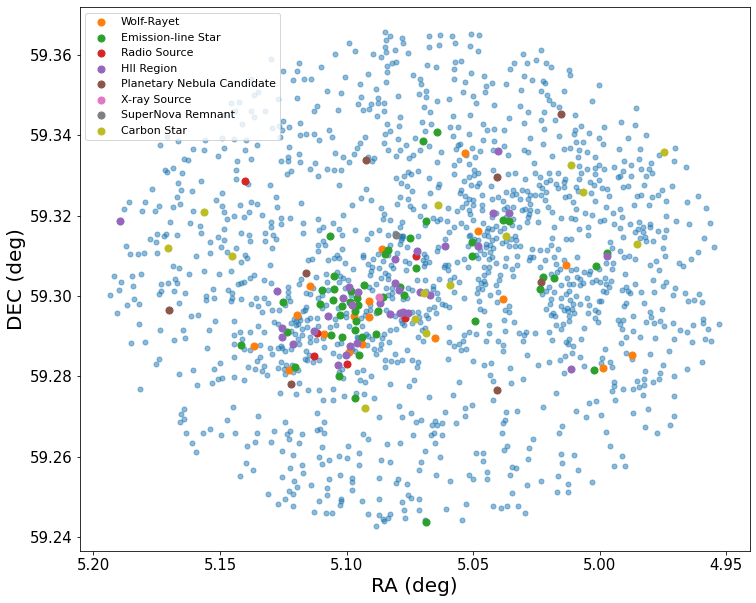

In [9]:
plt.figure(figsize=(12,10))
plt.xlabel('RA (deg)',fontsize=20)
plt.ylabel('DEC (deg)',fontsize=20)

alpha=1

# all
t_plot=sourcefy(t_zr)
plt.scatter(t_plot['RA'], t_plot['DEC'],s=25,alpha=0.5)

types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

for i,tp in enumerate(types):
    t_plot=sourcefy(t_zr[t_zr['type']==types[i]])
    plt.scatter(t_plot['RA'], t_plot['DEC'],s=50,alpha=alpha,label=names[i])


#plt.xlim(0,2)
#plt.ylim(21,18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc=0,fontsize=11)
plt.gca().invert_xaxis()

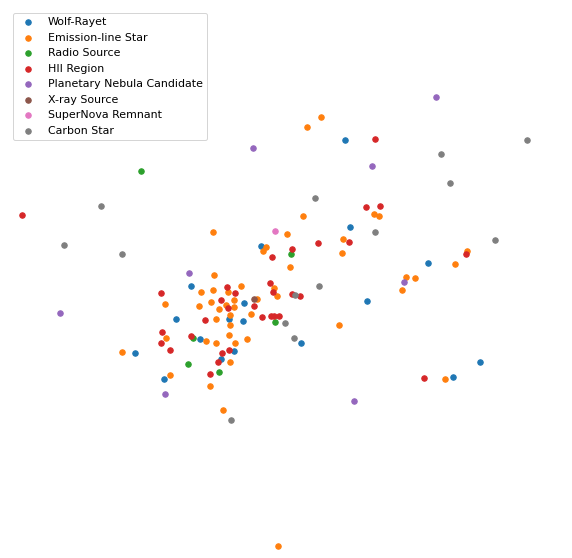

In [9]:
#plt.figure(figsize=(12,10))
#plt.xlabel('RA (deg)',fontsize=20)
#plt.ylabel('DEC (deg)',fontsize=20)
fig = plt.figure(figsize=(10,10))
plt.axis('off')
alpha=1

# all
#t_plot=sourcefy(t_zr)
#x, y = sinusoidal_projection(t_plot['RA'], t_plot['DEC'])
#plt.scatter(x,y,s=15,alpha=0.5)

types=['WR*','Em*','Radio','HII','PN?_Candidate','X','SNR','C*']
names=['Wolf-Rayet','Emission-line Star','Radio Source','HII Region','Planetary Nebula Candidate','X-ray Source','SuperNova Remnant','Carbon Star']

for i,tp in enumerate(types):
    t_plot=sourcefy(t_zr[t_zr['type']==types[i]])
    x, y = sinusoidal_projection(t_plot['RA'], t_plot['DEC'])
    plt.scatter(x,y,s=30,alpha=alpha,label=names[i])


#plt.xlim(0,2)
#plt.ylim(21,18)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.legend(loc=0,fontsize=11)


x, y = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])
plt.xlim(x.min(),x.max())
plt.ylim(y.min(),y.max())

plt.gca().invert_xaxis()
# save the image without the border
plt.savefig('overlay_SIMBAD.png', bbox_inches='tight', pad_inches=0,facecolor='none')

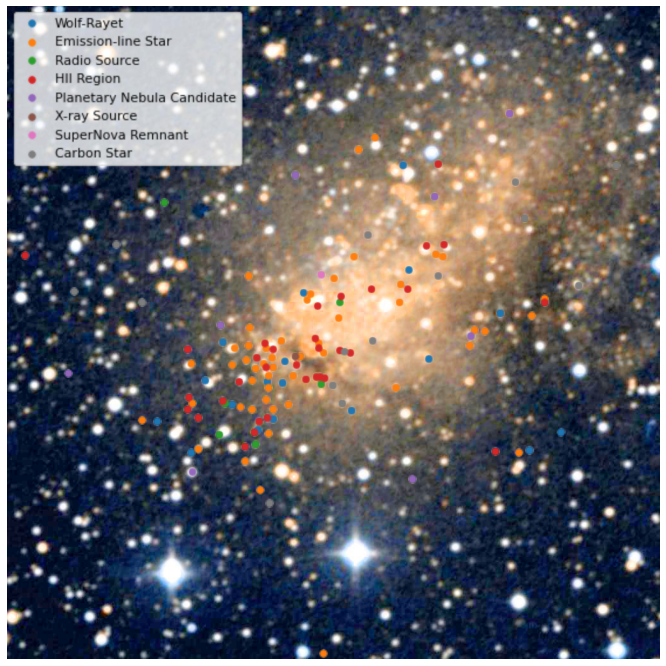

In [12]:
fig = plt.figure(figsize=(12,12))
plt.axis('off')
image2 = plt.imread('overlay_SIMBAD.png')
# resize image2 to match image1
image2 = cv2.resize(image2, (shape,shape))
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)


451
528


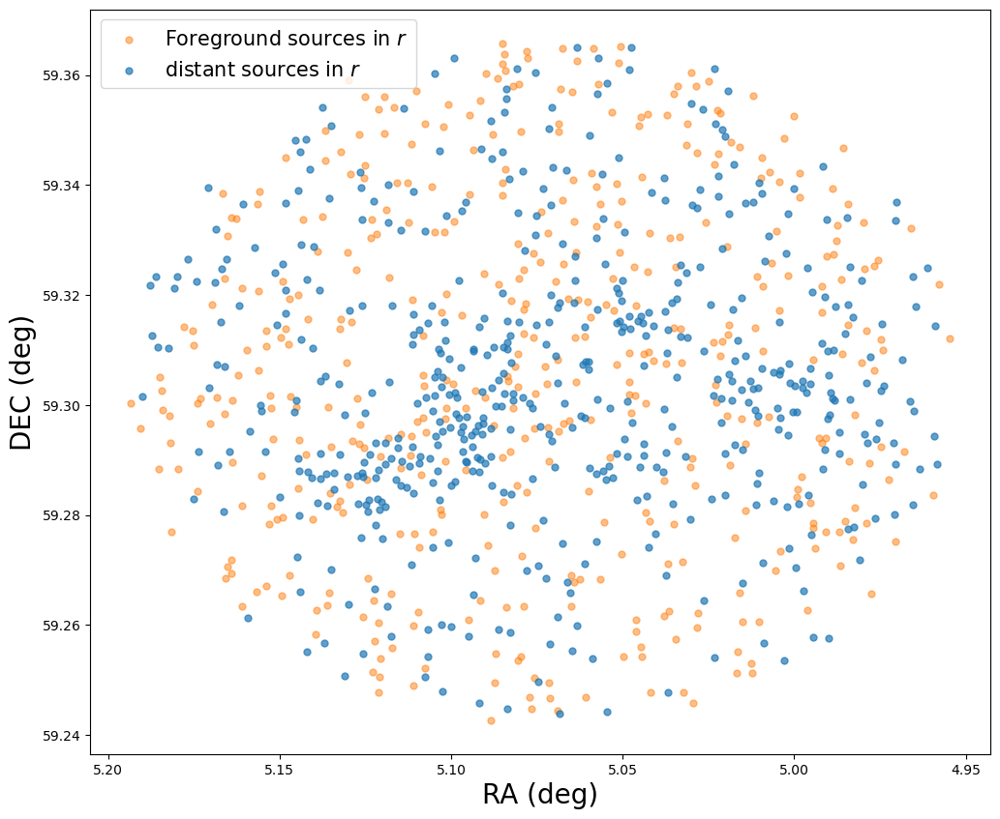

In [29]:
fig = plt.figure(figsize=(12,10))
t_zr=t_zr[t_zr['Gaia_count']>0]
t=sourcefy(t_zr[t_zr['Plxflag']==1])
print(len(t))
plt.scatter(t['RA'],t['DEC'],c='#ff7f0e',alpha=0.5,s=25,label='Foreground sources in $r$')
t=sourcefy(t_zr[t_zr['Plxflag']==0])
print(len(t))
plt.scatter(t['RA'],t['DEC'],c='#1f77b4',alpha=0.7,s=25,label='distant sources in $r$')
plt.xlabel('RA (deg)',fontsize=20)
plt.ylabel('DEC (deg)',fontsize=20)
plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


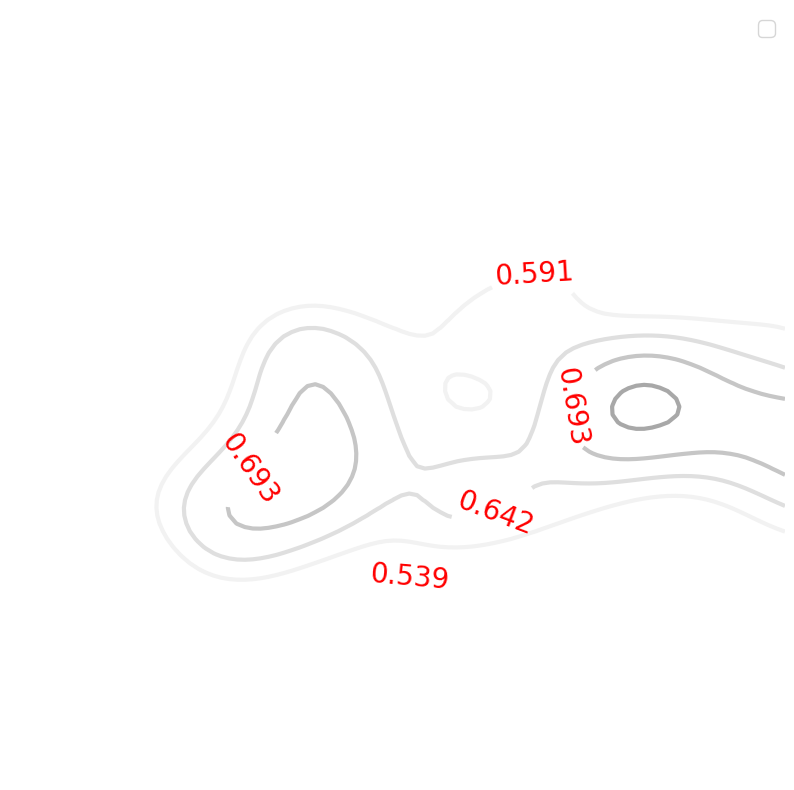

In [35]:
fig = plt.figure(figsize=(10,10))
plt.axis('off')

xall, yall = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])

# Define the grid on which to evaluate the density estimate
xmin, xmax = xall.min(), xall.max()
ymin, ymax = yall.min(), yall.max()
xgrid, ygrid = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
positions = np.vstack([xgrid.ravel(), ygrid.ravel()])

t=sourcefy(t_zr[t_zr['Plxflag']==1])
n_fg=len(t)

x, y = sinusoidal_projection(t['RA'], t['DEC'])
# Create a kernel density estimate of the data
kde = gaussian_kde([x, y],bw_method=0.3)

# Evaluate the density estimate on the grid
Z_fg = kde(positions).reshape(xgrid.shape)

#plt.scatter(x,y,c='#ff7f0e',alpha=1,s=25,label='Foreground sources in $r$')
t=sourcefy(t_zr[t_zr['Plxflag']==0])
n_dist=len(t)

x, y = sinusoidal_projection(t['RA'], t['DEC'])
# Create a kernel density estimate of the data
kde = gaussian_kde([x, y],bw_method=0.3)

# Evaluate the density estimate on the grid
Z_dist = kde(positions).reshape(xgrid.shape)

#print(len(t))
#plt.scatter(x,y,c='cornflowerblue',alpha=1,s=25,label='distant sources in $r$')

#Z_ratio_dist = Z_dist/(Z_dist+Z_fg)

Z_dist = Z_dist*n_dist/Z_dist.sum()
Z_fg = Z_fg*n_fg/Z_fg.sum()
Z_ratio_dist = Z_dist/(Z_dist+Z_fg)


#plt.contour(xgrid, ygrid, Z_ratio_dist, levels=[0.7,0.75,0.8,0.85],cmap='Greys', alpha=1,linewidths=3)
for i in range(Z_ratio_dist.shape[0]):
    for j in range(Z_ratio_dist.shape[1]):
        if i>80 and j>45:
            Z_ratio_dist[i,j]=0
            
CS=plt.contour(xgrid, ygrid, Z_ratio_dist, levels=np.linspace(n_dist/(n_dist+n_fg),1,10),cmap='Greys', alpha=1,linewidths=3)
plt.clabel(CS,CS.levels,inline=True,fmt='%1.3f',fontsize=20,colors='red')

#plt.imshow(np.rot90(Z_ratio_dist), cmap='viridis', extent=[xmin, xmax, ymin, ymax],alpha=0.5)
#plt.colorbar(label='Distant ratio')


plt.xlim(xall.min(),xall.max())
plt.ylim(yall.min(),yall.max())
plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

# save the image without the border
plt.savefig('overlay_var_rate.png', bbox_inches='tight', pad_inches=0,facecolor='none')

451


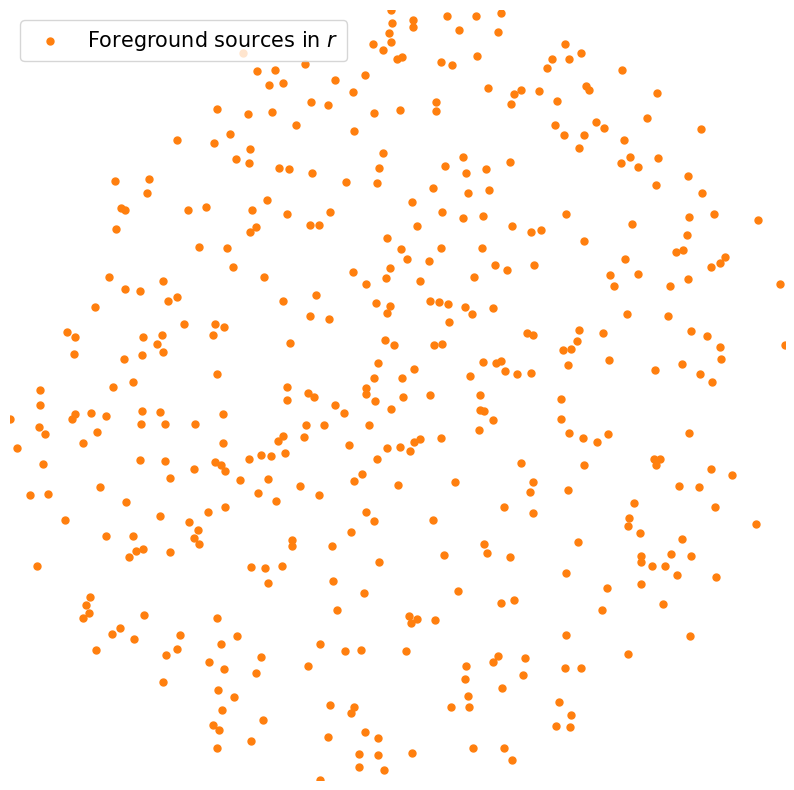

In [65]:
fig = plt.figure(figsize=(10,10))
plt.axis('off')

t=sourcefy(t_zr[t_zr['Plxflag']==1])
print(len(t))
x, y = sinusoidal_projection(t['RA'], t['DEC'])

# Create a kernel density estimate of the data
kde = gaussian_kde([x, y])

# Define the grid on which to evaluate the density estimate
xmin, xmax = x.min(), x.max()
ymin, ymax = y.min(), y.max()
xgrid, ygrid = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
positions = np.vstack([xgrid.ravel(), ygrid.ravel()])

# Evaluate the density estimate on the grid
density = kde(positions).reshape(xgrid.shape)

# Create the contour plot
#plt.contour(xgrid, ygrid, density, cmap='viridis', alpha=1)
#plt.imshow(np.rot90(density), cmap='viridis', extent=[xmin, xmax, ymin, ymax],alpha=0.5)
#plt.colorbar(label='Density')

plt.scatter(x,y,c='#ff7f0e',alpha=1,s=25,label='Foreground sources in $r$')
#t=sourcefy(t_zr[t_zr['Plxflag']==0])
#x, y = sinusoidal_projection(t['RA'], t['DEC'])
#plt.scatter(x,y,c='#1f77b4',alpha=0.7,s=25,label='distant sources in $r$')
plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

x, y = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])
plt.xlim(x.min(),x.max())
plt.ylim(y.min(),y.max())
plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

# save the image without the border
plt.savefig('overlay_foreground.png', bbox_inches='tight', pad_inches=0,facecolor='none')

528


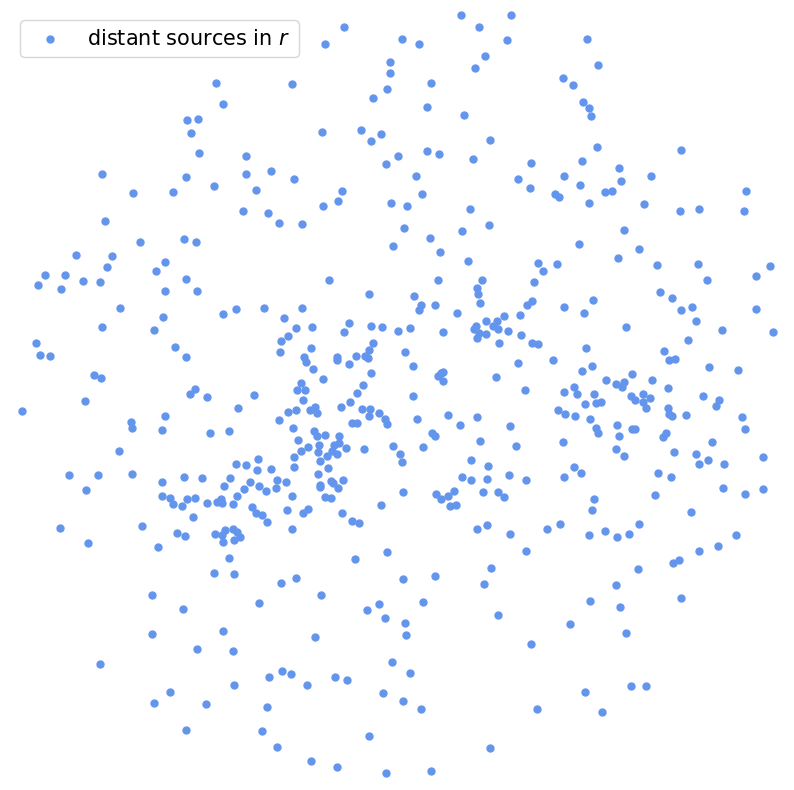

In [66]:
from scipy.stats import gaussian_kde

fig = plt.figure(figsize=(10,10))
plt.axis('off')

#t=sourcefy(t_zr[t_zr['Plxflag']==1])
#x, y = sinusoidal_projection(t['RA'], t['DEC'])
#plt.scatter(x,y,c='#ff7f0e',alpha=0.5,s=25,label='Foreground sources in $r$')
t=sourcefy(t_zr[t_zr['Plxflag']==0])
print(len(t))
x, y = sinusoidal_projection(t['RA'], t['DEC'])

# Create a kernel density estimate of the data
kde = gaussian_kde([x, y])

# Define the grid on which to evaluate the density estimate
xmin, xmax = x.min(), x.max()
ymin, ymax = y.min(), y.max()
xgrid, ygrid = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
positions = np.vstack([xgrid.ravel(), ygrid.ravel()])

# Evaluate the density estimate on the grid
density = kde(positions).reshape(xgrid.shape)

# Create the contour plot
#plt.contour(xgrid, ygrid, density, cmap='viridis', alpha=1)
#plt.imshow(np.rot90(density), cmap='viridis', extent=[xmin, xmax, ymin, ymax],alpha=0.5)
#plt.colorbar(label='Density')

plt.scatter(x,y,c='cornflowerblue',alpha=1,s=25,label='distant sources in $r$')
plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

x, y = sinusoidal_projection(t_zr['RA'], t_zr['DEC'])
plt.xlim(x.min(),x.max())
plt.ylim(y.min(),y.max())
plt.legend(loc=0,fontsize=15)
plt.gca().invert_xaxis()

# save the image without the border
plt.savefig('overlay_distant.png', bbox_inches='tight', pad_inches=0,facecolor='none')

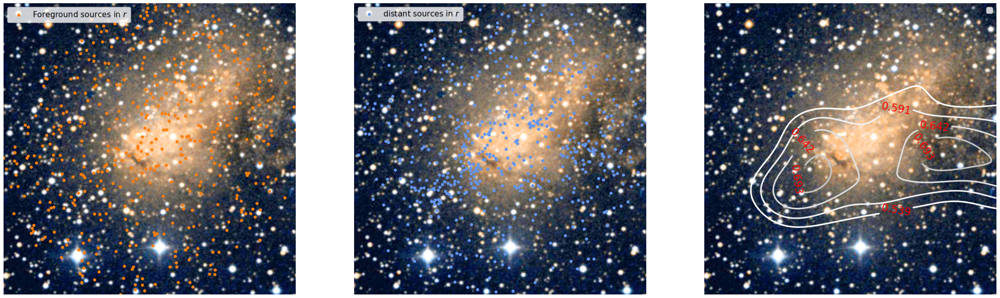

In [67]:
from PIL import Image

fig = plt.figure(figsize=(36,12))

image2 = Image.open('overlay_foreground.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))

plt.subplot(1,3,1)
plt.axis('off')
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

plt.subplot(1,3,2)
plt.axis('off')
image2 = Image.open('overlay_distant.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

plt.subplot(1,3,3)
plt.axis('off')
image2 = Image.open('overlay_var_rate.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

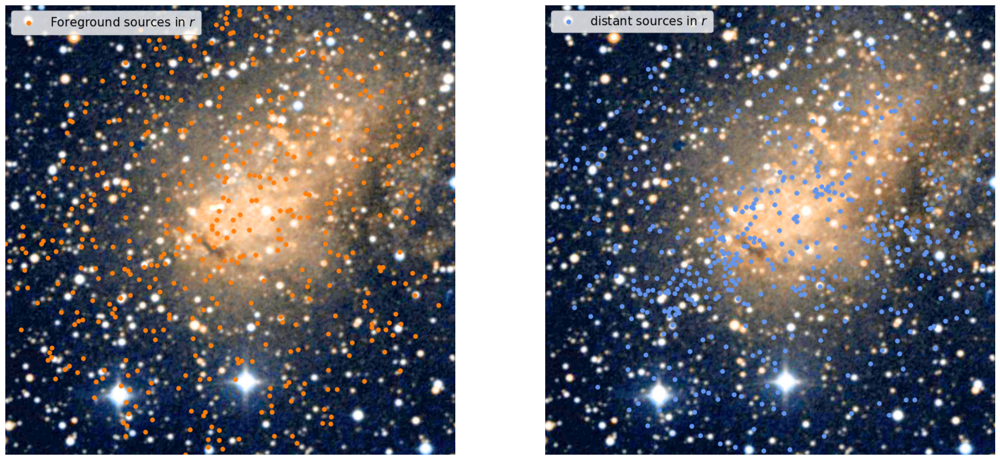

In [122]:
from PIL import Image

fig = plt.figure(figsize=(24,12))

image2 = Image.open('overlay_foreground.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))

plt.subplot(1,2,1)
plt.axis('off')
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

plt.subplot(1,2,2)
plt.axis('off')
image2 = Image.open('overlay_distant.png')
# resize image2 to match image1
image2 = image2.resize((shape,shape))
plt.imshow(image1,alpha=1)
plt.imshow(image2,alpha=1)

In [43]:
# white dwarfs
df_color[(df_color['mean_color']<1.3)&(df_color['absolute_mag_r']>9)&(df_color['var']!='N')]

,SourceID,mean_color,std_color,max_color,min_color,mean_mag_r,std_mag_r,max_mag_r,min_mag_r,mean_mag_g,std_mag_g,max_mag_g,min_mag_g,absolute_mag_r,var,Plxflag,ic10_flag
58,73,0.886408,0.191312,1.374418,0.044020,19.436953,0.142094,19.732689,18.890762,20.327229,0.231467,20.794662,19.153166,10.569694,V,1.0,False
118,145,1.193695,0.193373,1.771063,0.669775,19.461908,0.141719,20.149548,18.996407,20.637638,0.178691,21.093691,20.012495,9.491241,P,1.0,False
1002,1439,0.932522,0.365051,1.677170,0.069345,20.094957,0.235666,20.926077,19.455307,21.043480,0.332120,21.586857,19.739641,11.015432,V,1.0,False
1233,1786,1.119242,0.288068,1.698553,0.329094,20.213085,0.186515,20.720837,19.235363,21.430141,0.260948,21.959869,20.603495,9.833706,V,1.0,False


In [44]:
wd_ID=df_color[(df_color['mean_color']<1.3)&(df_color['absolute_mag_r']>9)&(df_color['var']!='N')]['SourceID'].to_numpy()

In [45]:
functions.query(145)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
145,zr,806203100043772,5.0957151,59.2994528,717,66.61664581298828,3.5379984089296954,2.2753838245357322e-18,0.14171883463859558,1.0515294240953812e-12,981.7766691905116,0.997336033066433,0.17591322363193937,0.09890003454859338,19.4619083404541,0.14171883463859558,18.99640655517578,20.149547576904297,-0.18844391405582428,1.9061943292617798,0.014671911593230497,0.003428865224048767,0.0160385433525674,0.0,0.03191100590870233,0.026816135608569547,0.5452531399277134,g2,NonVar,0.35,0.0,1133.9261631750014,LGGS J002022.99+591757.8,0.329861,Em*,1,0,0.328369,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,P,P,False,True,False
145,zr,1809211300042604,5.095706,59.2993843,70,49.061622619628906,3.04362781022782,0.0034006701634084267,0.12611249089241028,4.3440289466632065e-08,0.5005857784631169,2800.0,0.5151418768924364,0.4038407234398711,19.473413467407227,0.12611249089241028,19.224807739257812,19.792285919189453,-0.1626230925321579,1.7541042566299438,0.28131470084599547,0.24014997862142634,0.22691212939950534,0.0,0.3652222781345995,0.5261213778525741,0.39200176752438864,gu,RRL_c,0.69,1.0,0.3332561031602737,LGGS J002022.99+591757.8,0.329861,Em*,1,0,0.328369,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,P,N,False,True,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
145,zg,1809111300037359,5.0955739,59.2994134,27,12.475582122802734,1.3594864375813056,0.887333395810309,0.18075062334537506,0.3823820206418178,0.10313280357686568,2800.0,0.4111718683499969,0.12895766339242193,20.607967376708984,0.18075062334537506,20.317750930786133,20.94916343688965,-0.0995478704571724,1.156970500946045,0.21410086967507921,0.3035168272701912,0.20978881332210736,0.0,0.8166576619351427,0.838430241716654,0.4896391774418156,gu,NonVar,0.36,1.0,0.030445886366578186,LGGS J002022.99+591757.8,0.335403,Em*,1,0,0.360385,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,N,N,False,True,False
145,zg,806103100029929,5.0955994,59.2993467,167,28.604887008666992,1.841649684812824,0.7615938253505716,0.17869067192077637,0.0008445053205045829,0.1915878715242689,1.0000143393856216,0.15879330850693638,0.01132239859652,20.637638092041016,0.17869067192077637,20.012495040893555,21.093690872192383,-0.11102097481489182,1.367995262145996,0.009580666023678774,0.0018563271605288873,0.05851629500128366,1.0,0.022118185787693756,0.0006124058580260217,0.9854163893214144,g1,DSCT,0.89,1.0,0.1915815593765839,LGGS J002022.99+591757.8,0.335403,Em*,1,0,0.360385,0.0,19.65069,160.035,1.0136,0.3862,1,0,nan,0,nan,N,N,False,True,False


In [46]:
functions.query(73)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
73,zr,806203100052194,5.0757586,59.2957439,570,79.02552795410156,4.492957767364811,2.0511315256049188e-32,0.14209401607513428,0.0013469039832887343,0.49968099722233067,0.9973357126290449,0.08833389447521292,0.056859390811042805,19.436952590942383,0.14209401607513428,18.890762329101562,19.732688903808594,-0.203139990568161,2.1489360332489014,0.03349849833893599,0.00722595301612069,0.13278539316689061,1.0,0.027289194603853928,0.0017941669502375968,0.9552115844818286,g1,RRL_ab,0.6,1.0,0.49969300037506753,[HL90] 46,1.871228,HII,2,1,0.625188,1.4082441250177322,20.23797,125.254,1.6848,0.5253,1,0,nan,0,nan,V,V,False,True,False
73,zr,1809211300070260,5.0758365,59.2957429,57,112.72003936767578,7.641255935664475,2.6224137045603225e-20,0.14378239214420319,0.004155668882964571,0.5107696872476819,2800.0,0.36194713151385455,0.2857524832115558,19.42538070678711,0.14378239214420319,18.705381393432617,19.754161834716797,-0.24609330296516418,2.7871596813201904,0.05237624018603771,0.033067253334624014,0.0838037593413743,0.0,0.2123480498819138,0.0878241330614129,0.7248852716643804,g1,DSCT,0.5,1.0,0.040488499208565835,[HL90] 46,1.871228,HII,2,1,0.625188,1.4082441250177322,20.23797,125.254,1.6848,0.5253,1,0,nan,0,nan,V,V,False,True,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
73,zg,806103100048650,5.0758587,59.2958026,97,64.1142578125,8.935053528431245,1.364237212874404e-43,0.23146717250347137,1.5286033678611772e-06,1.0323211002809742,0.9972896868175051,0.35458712707540346,0.17918306600135617,20.327228546142578,0.23146717250347137,19.153165817260742,20.794662475585938,-0.3369257152080536,3.0768370628356934,0.009533430482035768,0.01393656832479377,0.05977027922886222,0.0,0.8494752978458127,0.031768959029891186,0.986429830676151,g1,CEPH_Other,0.49,1.0,2.150138196410262,[HL90] 46,1.931646,HII,2,1,0.644132,1.4082441250177322,20.23797,125.254,1.6848,0.5253,1,0,nan,0,nan,P,P,False,True,False
73,zg,1809111300053024,5.0756741,59.2957057,19,16.696256637573242,1.5697347255351841,0.7207352647824851,0.1573619544506073,0.0013944895300564742,0.13485031059995917,2800.0,0.7870986756487587,0.20519508240479836,20.345008850097656,0.1573619544506073,20.01482391357422,20.637582778930664,-0.1152704656124115,1.2368863821029663,2.676223883949171,3.4445548636261396,2.8338038985994345,0.0,0.7138682176484541,0.6553600470759664,0.5291106201535377,g1,DSCT,0.59,1.0,0.03481458077779705,[HL90] 46,1.931646,HII,2,1,0.644132,1.4082441250177322,20.23797,125.254,1.6848,0.5253,1,0,nan,0,nan,P,N,False,True,False


In [47]:
functions.query(1439)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1439,zr,806203100043773,4.9824432,59.2981406,602,38.65651321411133,4.1023944211057035,3.357727419669221e-27,0.23566551506519318,0.0023135672359833634,0.1270191696644733,0.997336033066433,0.0786717080269009,0.006450878946128891,20.09495735168457,0.23566551506519318,19.455307006835938,20.926076889038086,-0.3099121153354645,2.0926730632781982,0.01419654816362029,0.01834393300576474,0.02735658983426476,0.0,0.7179545400369662,0.2371121648929294,0.7968306278270584,g1,NonVar,0.93,1.0,0.03826016797020646,--,nan,--,1,0,0.197008,0.0,20.109032,245.254,1.5279,0.4955,1,0,nan,0,nan,V,V,False,True,False
1439,zr,1809211300054485,4.9824332,59.2980731,60,37.123050689697266,4.127834284922807,2.927859513057709e-06,0.20768477022647858,0.08225243352418939,0.11822406770761677,2800.0,0.27019095058680453,0.04859100421773606,20.03634262084961,0.20768477022647858,19.494829177856445,20.500093460083008,-0.29511338472366333,2.0820326805114746,0.16299140256281994,0.16139317224203706,0.1948884730870797,0.0,0.4711018463202633,0.3462693605074053,0.5901860685642357,g1,DSCT,0.89,1.0,0.05004179080517056,--,nan,--,1,0,0.197008,0.0,20.109032,245.254,1.5279,0.4955,1,0,nan,0,nan,V,V,False,True,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1439,zg,806103100040262,4.9824886,59.2982892,54,40.17333221435547,7.179891378859064,1.202455604693451e-17,0.3321198523044586,0.00042352503521490376,0.1080538542206567,0.9972228116519088,0.42018778663497397,0.015038451359892053,21.043479919433594,0.3321198523044586,19.739641189575195,21.586856842041016,-0.3256167471408844,2.747013807296753,0.03233135638095939,0.02303743100506321,0.036141431522865745,0.0,0.26476333750887604,0.21612126445981805,0.5565321099463955,g1,DSCT,0.63,1.0,0.08469444892659032,--,nan,--,1,0,0.858624,0.0,20.109032,245.254,1.5279,0.4955,1,0,nan,0,nan,V,V,False,True,False


In [48]:
functions.query(1786)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1786,zr,1809211300043281,5.010417,59.2604889,64,23.732357025146484,1.6523383819780983,0.8360474390289298,0.158037930727005,0.1978168986001434,0.17787530795059414,2800.0,0.23113477503590335,0.020023040712520975,20.203222274780273,0.158037930727005,19.867015838623047,20.72515869140625,-0.14034897089004517,1.297690987586975,0.040853132786506,0.009851105837709486,0.019699053876865633,0.0,0.0339196857888473,0.13763917537068693,0.17838556360546365,gu,DSCT,0.53,1.0,0.05082474529560581,--,nan,--,1,0,0.188411,0.0,20.093018,248.708,0.8397,0.4832,1,0,nan,0,nan,V,N,False,False,False
1786,zr,806203400030545,5.0103048,59.260512,320,47.51986312866211,3.665832629675993,1.6651324746223155e-10,0.18651480972766876,3.95791160441202e-07,0.997336033066433,0.9999745929464803,0.2332625334349759,0.9305289471088565,20.213085174560547,0.18651480972766876,19.235363006591797,20.720836639404297,-0.20828820765018463,1.9565154314041138,0.026002118976711567,0.0022287628082337087,0.08975042524557539,1.0,0.004424037385743929,0.0003757640312601618,0.9378129665259183,g1,DSCT,0.49,1.0,0.03864844878661877,--,nan,--,1,0,0.188411,0.0,20.093018,248.708,0.8397,0.4832,1,0,nan,0,nan,V,V,False,False,False


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
1786,zg,806103400039610,5.0103964,59.2604466,28,19.571592330932617,2.3713367521965445,0.22850427847361604,0.2609483003616333,0.0039296271878705245,0.508624600031383,0.9973365763594025,0.5885007259229779,0.3715998657828539,21.43014144897461,0.2609483003616333,20.60349464416504,21.959869384765625,-0.1279851496219635,1.53184175491333,0.24353766250224523,0.4196493807288291,0.2563035514449227,0.0,0.9952898522370333,0.9607286015391985,0.5260005802385501,g1,DSCT,0.5,1.0,0.04579848518651695,--,nan,--,1,0,0.142265,0.0,20.093018,248.708,0.8397,0.4832,1,0,nan,0,nan,N,N,False,False,False


period= 746.2183874454179 d     LNP_SIG= 4.4056301219298595e-13


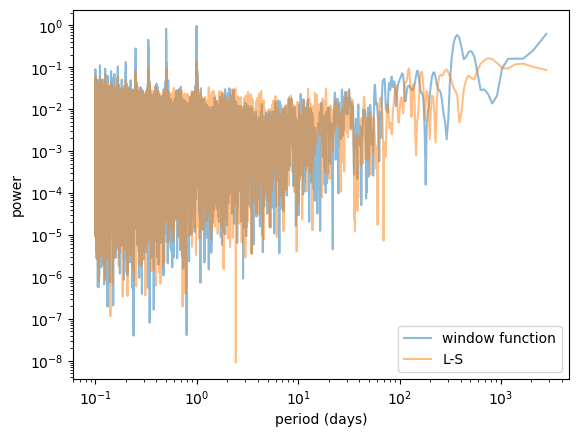

In [36]:
functions.windowfunc(806203100043772,nan=True)

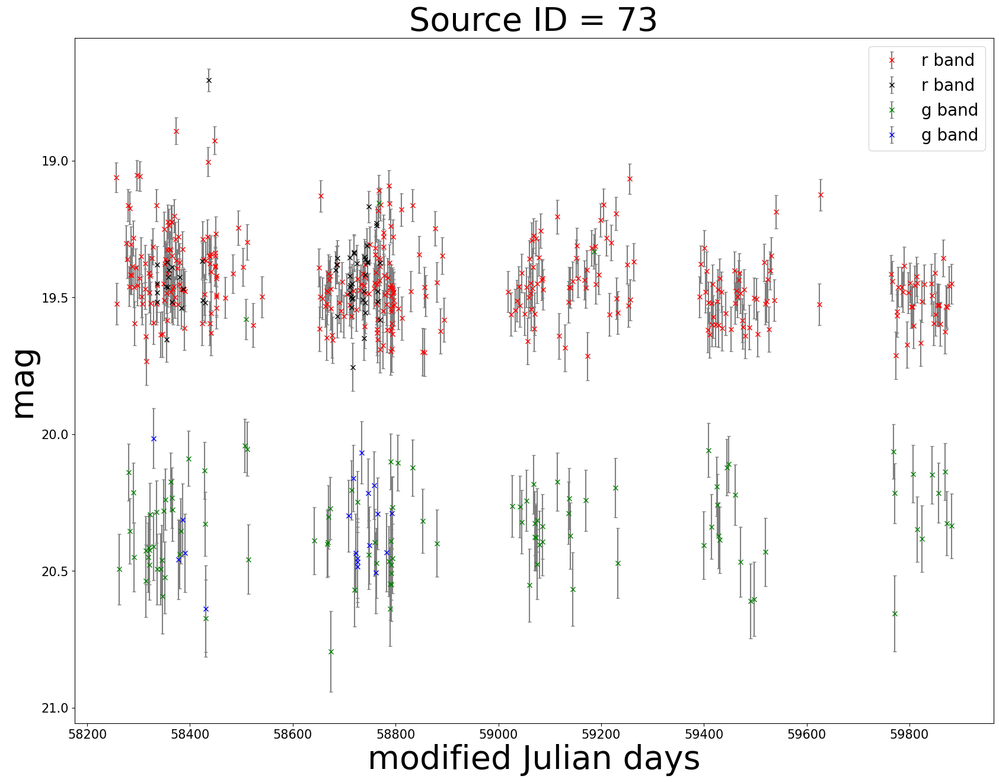

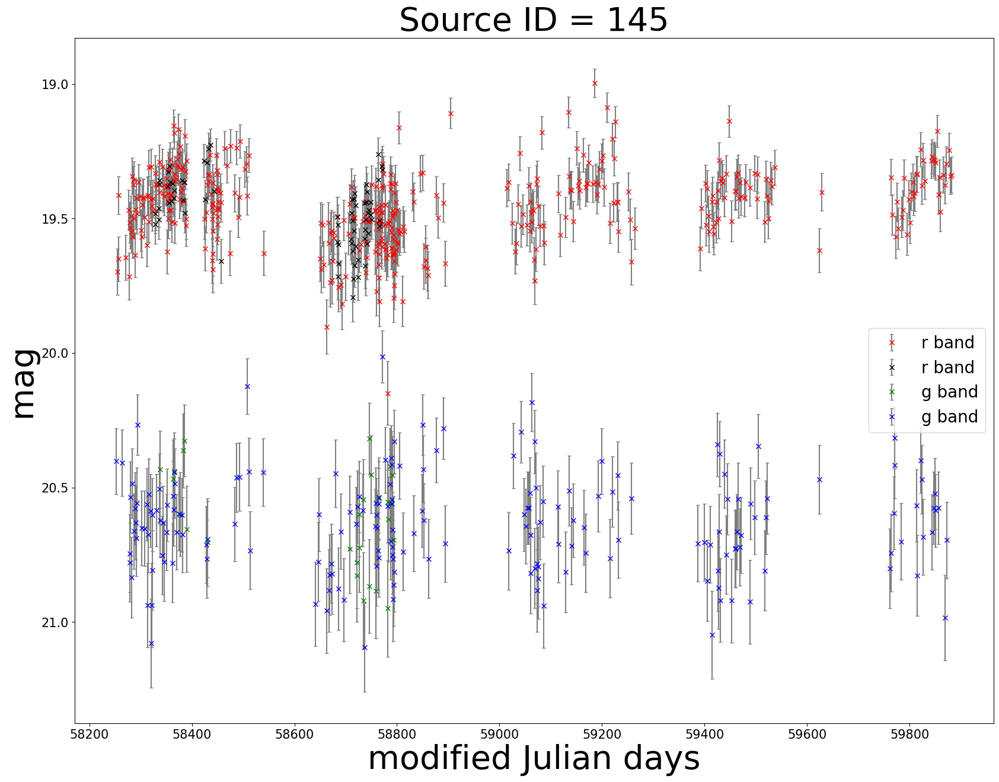

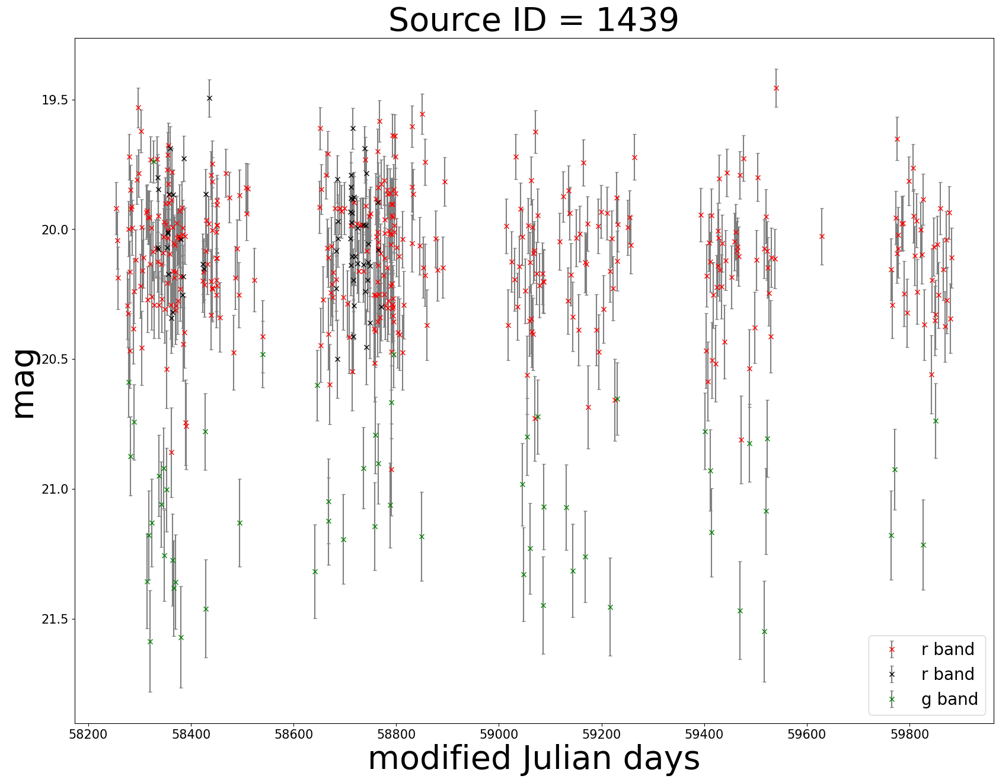

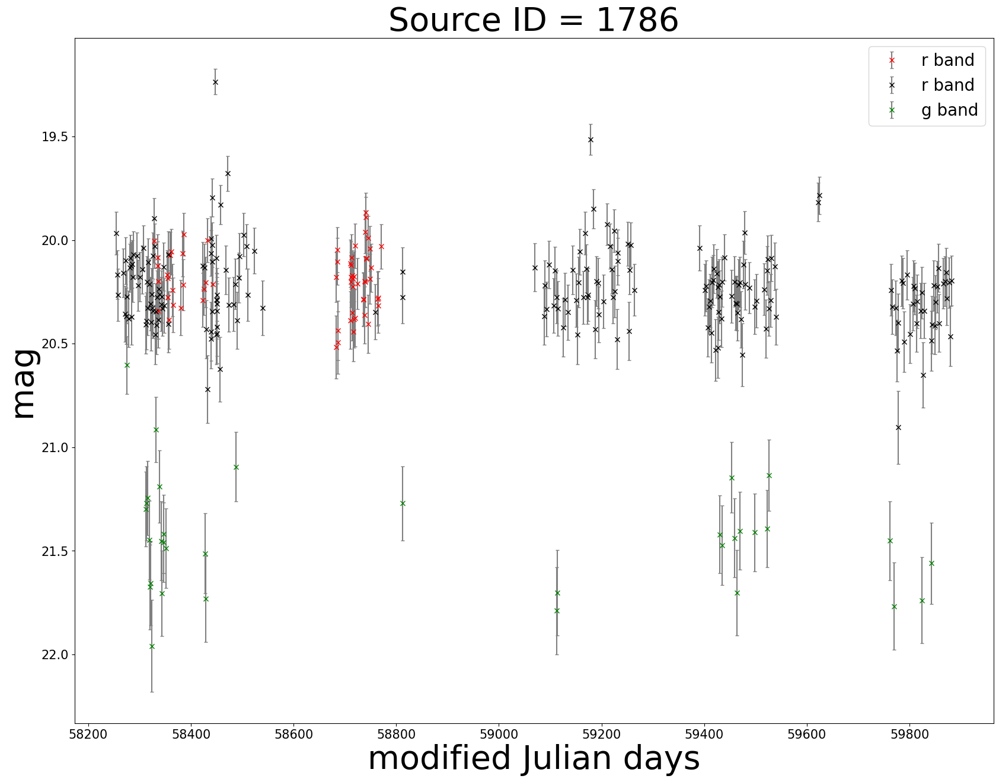

In [64]:
for SourceID in wd_ID:
    functions.draw_lightcurve(SourceID)

In [42]:
# super blue
#superblue=sourcefy(unobj_zg[np.isin(unobj_zg['SourceID'],t_zr['SourceID'])==0])
only_g_nonvar=sourcefy(nonvar_zg[np.isin(nonvar_zg['SourceID'],t_zr['SourceID'])==0])
only_g_unobj=sourcefy(unobj_zg[np.isin(unobj_zg['SourceID'],t_zr['SourceID'])==0])
only_g=sourcefy(t_zg[np.isin(t_zg['SourceID'],t_zr['SourceID'])==0])
len(only_g_nonvar),len(only_g_unobj),len(only_g)

(25, 18, 43)

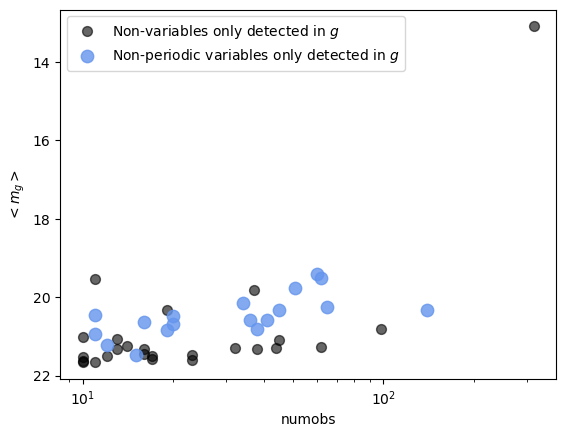

In [47]:
plt.scatter(only_g_nonvar['numobs'],only_g_nonvar['mean'],color='black',alpha=0.6,s=50,label='Non-variables only detected in $g$')
plt.scatter(only_g_unobj['numobs'],only_g_unobj['mean'],color='cornflowerblue',alpha=0.8,s=80,label='Non-periodic variables only detected in $g$')
plt.xlabel('numobs')
plt.ylabel('$<m_g>$')
plt.xscale('log')
plt.legend(loc=0)
plt.gca().invert_yaxis()

In [51]:
superblue=only_g_nonvar[only_g_nonvar['mean']<18.5]

In [52]:
superblue.columns

<TableColumns names=('SourceID','filter','OID','RA','DEC','numobs','DELTA_SIG_MAG','CONST_CHI2','sf','rmse','LNP_SIG','period','period_c','power','power_c','mean','std','min','max','sigma_mean','sigma_std','gaussian1_err','gaussian2_err','gumbel_err','g2_flag','Pg1g2','Pgug2','Pg1gu','shape','upsilon_class','upsilon_prob','upsilon_flag','upsilon_period','identifier','dist','type','Gaia_count','multiflag','GaiaDist','fluxratio','Gmag','RFG','Plx','e_Plx','Plxflag','XMM','XMM_dist','Chandra','Chandra_dist','var','lc_var','var_flag','inside_flag','ic10_flag')>

In [65]:
superblue[['SourceID','numobs','identifier','type','Gaia_count','Plxflag','var','ic10_flag','dist','Plx','mean']]

SourceID,numobs,identifier,type,Gaia_count,Plxflag,var,ic10_flag,dist,Plx,mean
int32,int32,str37,str15,int32,int32,str1,bool,float64,float64,float64
149,317,TYC 3665-1255-1,Star,1,1,N,False,0.258278,1.5909,13.09145450592041


In [56]:
plx = superblue['Plx']
d = 1/(plx*0.001)
M_g=superblue['mean'] - 5*np.log10(d)+5
M_g

4.099668915111536


In [61]:
functions.query(149)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
149,zg,806103100020272,5.0866118,59.2932274,317,271.657958984375,1.2756951216363157,0.9999999327677193,0.01644241064786911,0.000368454141046598,96.05863924337996,1.0000143393856216,0.09489421795213536,0.03331614214279985,13.09145450592041,0.01644241064786911,13.031682968139648,13.147173881530762,-0.0006456301198340952,1.1277118921279907,4.784700373628044,0.20692231030703861,13.281185961058208,1.0,0.0011355888971853467,0.00014817440279157879,0.8993017304717188,g1,LPV_OSARG_RGB,0.5,1.0,94.4976041625,TYC 3665-1255-1,0.258278,Star,1,0,0.075071,0.0,12.556845,6473.25,1.5909,0.0107,1,0,nan,0,nan,N,N,False,True,False
149,zg,1809111300005288,5.0866227,59.2932138,66,232.70237731933594,0.9735035253417752,0.9998435544229523,0.011198213323950768,0.0027559639023223143,0.2709295416049481,2800.0,0.3302044987098811,0.06436046852625753,13.074494361877441,0.011198213323950768,13.046905517578125,13.107771873474121,-0.000742661242838949,0.979160487651825,34.16916662701599,42.74634352551197,48.961860882572694,1.0,0.6844851652596711,0.3798079933143581,0.6765378080264322,g1,DSCT,0.38,1.0,0.0995552914041938,TYC 3665-1255-1,0.258278,Star,1,0,0.075071,0.0,12.556845,6473.25,1.5909,0.0107,1,0,nan,0,nan,N,N,False,True,False


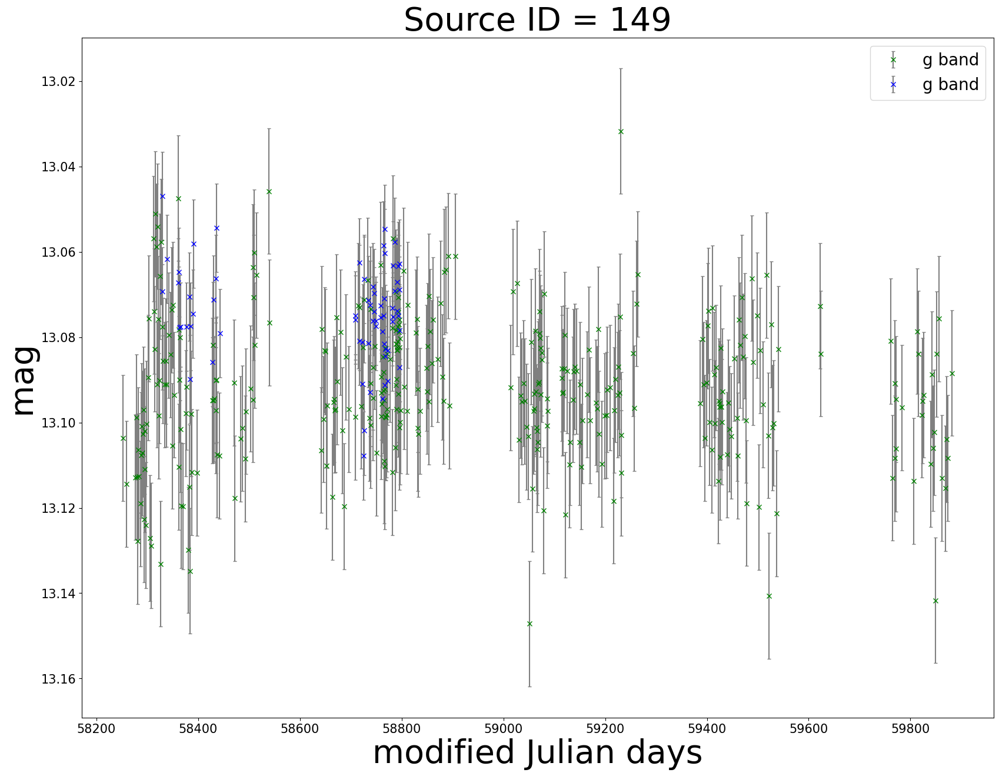

In [54]:
functions.draw_lightcurve(149)

In [64]:
t_zr['mean'].min(), t_zg['mean'].min()

(12.785636901855469, 12.973596572875977)

In [68]:
lessblue=only_g_unobj[only_g_unobj['numobs']>100]
lessblue

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
179,zg,806103100047213,5.0967599,59.2967401,140,46.27132034301758,3.7974360793247617,5.117688321585779e-10,0.19791057705879211,0.002613830370677713,0.3454064960292753,1.0000143393856216,0.1691816521796462,0.010178936147940406,20.335800170898438,0.19791057705879211,19.51763153076172,20.75957679748535,-0.21265582740306854,1.9851075410842896,0.09920417870592549,0.0026972397544022045,0.1965497031597042,1.0,0.0004502386206233222,0.00011499557520588954,0.8064519176108946,g1,DSCT,0.69,1.0,0.09423061741316272,[HL90] 85,1.793232,HII,2,1,1.935573,1.2153348727007938,20.009607,155.01,-0.1498,0.4354,0,0,nan,0,nan,V,V,False,True,True


In [70]:
functions.query(179)

SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool


SourceID,filter,OID,RA,DEC,numobs,DELTA_SIG_MAG,CONST_CHI2,sf,rmse,LNP_SIG,period,period_c,power,power_c,mean,std,min,max,sigma_mean,sigma_std,gaussian1_err,gaussian2_err,gumbel_err,g2_flag,Pg1g2,Pgug2,Pg1gu,shape,upsilon_class,upsilon_prob,upsilon_flag,upsilon_period,identifier,dist,type,Gaia_count,multiflag,GaiaDist,fluxratio,Gmag,RFG,Plx,e_Plx,Plxflag,XMM,XMM_dist,Chandra,Chandra_dist,var,lc_var,var_flag,inside_flag,ic10_flag
int32,str2,str16,float64,float64,int32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,str2,str14,float64,float64,float64,str37,float64,str15,int32,int32,float64,float64,float64,float64,float64,float64,int32,int32,float64,int32,float64,str1,str1,bool,bool,bool
179,zg,806103100047213,5.0967599,59.2967401,140,46.27132034301758,3.7974360793247617,5.117688321585779e-10,0.19791057705879211,0.002613830370677713,0.3454064960292753,1.0000143393856216,0.1691816521796462,0.010178936147940406,20.335800170898438,0.19791057705879211,19.51763153076172,20.75957679748535,-0.21265582740306854,1.9851075410842896,0.09920417870592549,0.0026972397544022045,0.1965497031597042,1.0,0.0004502386206233222,0.00011499557520588954,0.8064519176108946,g1,DSCT,0.69,1.0,0.09423061741316272,[HL90] 85,1.793232,HII,2,1,1.935573,1.2153348727007938,20.009607,155.01,-0.1498,0.4354,0,0,nan,0,nan,V,V,False,True,True
179,zg,1809111300052431,5.0968315,59.2967566,25,17.980093002319336,1.8970196555439116,0.5337492739674758,0.16270746290683746,0.004404704430050635,2.1845918574435483,2800.0,0.6411461370504462,0.0964485312519402,20.29570198059082,0.16270746290683746,19.915260314941406,20.50766944885254,-0.13410642743110657,1.3718066215515137,0.6950796007616618,0.8168328347321927,0.6891900286001703,0.0,0.6221084851225718,0.630389669476723,0.49566632228310403,gu,DSCT,0.79,1.0,0.07228579039898278,[HL90] 85,1.793232,HII,2,1,1.935573,1.2153348727007938,20.009607,155.01,-0.1498,0.4354,0,0,nan,0,nan,V,N,False,True,True


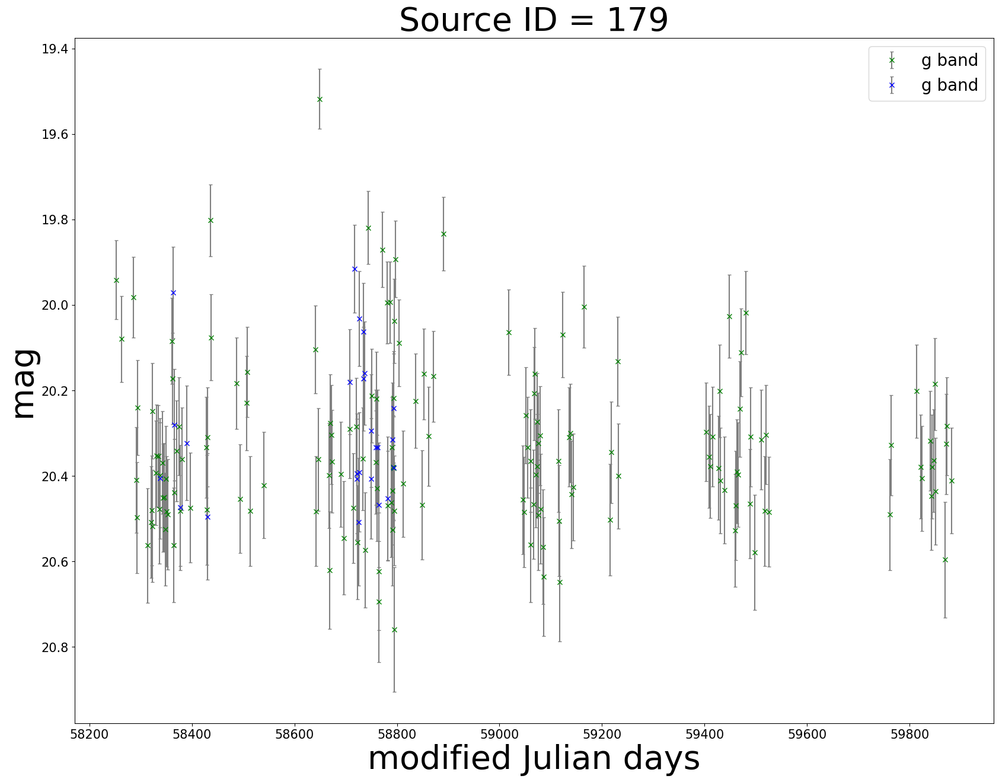

In [69]:
functions.draw_lightcurve(179)